<a href="https://colab.research.google.com/github/jmarcedwards/NodeJS_repo1/blob/master/Another_copy_of_SSC_penis_Fully_Functional_EDA_to_Lime_Pytorch_Pipeline_for_Automated_Research_implementing_batching.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EDA

# Set-up

###Installs / Drive Set-up / Imports

##### Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


##### Installs

In [ ]:
!pip install matplotlib==3.1.1
!pip install lifelines
!pip install git+https://github.com/aleju/imgaug.git
!pip install kmodes
!pip install scikit-learn-extra
! pip install plotnine
!pip install 'umap-learn==0.3.10'
! pip install networkx
! pip install community
! pip install pingouin
! pip install umap
! pip install lime
! pip install torchmetrics
!pip install --upgrade xlrd

  Using cached matplotlib-3.1.1-cp310-cp310-linux_x86_64.whl
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.8.2
    Uninstalling matplotlib-3.8.2:
      Successfully uninstalled matplotlib-3.8.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
arviz 0.15.1 requires matplotlib>=3.2, but you have matplotlib 3.1.1 which is incompatible.
mizani 0.9.3 requires matplotlib>=3.5.0, but you have matplotlib 3.1.1 which is incompatible.
plotnine 0.12.4 requires matplotlib>=3.6.0, but you have matplotlib 3.1.1 which is incompatible.


  Cloning https://github.com/aleju/imgaug.git to /tmp/pip-req-build-lgdfh9ds
  Running command git clone --filter=blob:none --quiet https://github.com/aleju/imgaug.git /tmp/pip-req-build-lgdfh9ds
  Resolved https://github.com/aleju/imgaug.git to commit 0101108d4fed06bc5056c4a03e2bcb0216dac326
  Preparing metadata (setup.py) ... done
  Using cached matplotlib-3.8.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (11.6 MB)
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.1.1
    Uninstalling matplotlib-3.1.1:
      Successfully uninstalled matplotlib-3.1.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not install

##### Imports

In [ ]:
import pandas as pd
import numpy as np
from string import ascii_lowercase
import numpy as np
import pingouin as pg
import matplotlib.pyplot as plt
import seaborn as sns
import copy
from lifelines import KaplanMeierFitter

from sklearn.metrics import silhouette_score, adjusted_mutual_info_score, adjusted_rand_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.neighbors import DistanceMetric
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.metrics import roc_auc_score
from sklearn import preprocessing

from kmodes.kprototypes import KPrototypes
from kmodes.kmodes import KModes
from sklearn_extra.cluster import KMedoids

import umap

import io
import math
from community import community_louvain
import networkx as nx

from matplotlib import gridspec
from matplotlib.pyplot import figure
# import plotnine as p9

from google.colab import files
from tqdm.notebook import tqdm_notebook

import torch.nn as nn
import torch.nn.functional as F
import torch as th
import torch.optim as optim
import torchmetrics
from torchmetrics import ConfusionMatrix
from torchmetrics.classification import BinaryAccuracy
from torch.utils.data import DataLoader, TensorDataset
from torch import Tensor

from tqdm import tqdm
from torchmetrics import AUROC

import lime
import lime.lime_tabular
import sklearn
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
import sklearn.ensemble

import copy

import imblearn

In [ ]:
pd.set_option('display.max_columns', None)

In [ ]:
cd /content/drive/MyDrive/Research/RadOnc Burke Seer DB Project/Penis projects/SSC

/content/drive/MyDrive/Research/RadOnc Burke Seer DB Project/Penis projects/SSC


In [ ]:
cd /content/drive/MyDrive/Research/RadOnc\ Burke\ Seer\ DB\ Project/Penis\ projects/SSC

/content/drive/MyDrive/Research/RadOnc Burke Seer DB Project/Penis projects/SSC


In [ ]:
OCD_DATA_PATH = 'sitetype.icdo3.csv'
SURG_DATA_PATH = 'Surg Primary Site Translation.csv'
# DATA_PATH = 'Squamous Cell Carcinoma of Ascending, Transverse, Descending, and Sigmoid Colon.csv'
# DATA_PATH = 'eyelid.csv'
# DATA_PATH = 'nonsccpenis.csv'
# DATA_PATH = 'SCC_bladder.csv'
DATA_PATH = 'penile_SCC.csv'
# DATA_PATH = 'SCC of Pancreas Updated.csv'
# 'Squamous Cell Carcinoma of Ascending, Transverse, Descending, and Sigmoid Colon.csv'
# 'Squamous Cell Carcinoma of Prostate AndOr Bladder.csv'
# 'Squamous Cell Carcinoma of Sigmoid Colon.csv'

In [ ]:
df = pd.read_csv(DATA_PATH)

In [ ]:
df['EOD 10 - extent (1988-2003)'].shape

(5219,)

In [ ]:
df['Summary stage 2000 (1998-2017)'].value_counts()

Blank(s)    5219
Name: Summary stage 2000 (1998-2017), dtype: int64

In [ ]:
df['Combined Summary Stage (2004+)'].value_counts()

Localized           2375
Regional            1579
Blank(s)             918
Unknown/unstaged     192
Distant              155
Name: Combined Summary Stage (2004+), dtype: int64

In [ ]:
df['EOD 10 - extent (1988-2003)'].value_counts()

Blank(s)    4301
10           400
40           180
30           139
60            93
99            48
85            27
70            22
50             8
80             1
Name: EOD 10 - extent (1988-2003), dtype: int64

In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'Patient ID', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Si

In [ ]:
df['Histologic Type ICD-O-3'].value_counts()

8070    3694
8071     992
8051     271
8083     106
8072      54
8052      31
8074      23
8076      19
8081       9
8075       7
8054       5
8073       3
8084       2
8080       1
8050       1
8082       1
Name: Histologic Type ICD-O-3, dtype: int64

##### SEERS Decoding

In [ ]:
partial_decode = False
full_decode = False

sheet_names = ["CSMetsEval", "CSRegNodesEval", "CodingCSTumorSizeExtensionEvaluation", "CSMetsatDx", "CSExtension200015", 'SurgPrimSiteOther']
corr_col_names = ["CS Mets Eval (2004-2015)", "CS Reg Node Eval (2004-2015)",  "CS Tumor Size/Ext Eval (2004-2015)", "CS mets at dx (2004-2015)", "CS extension (2004-2015)", "RX Summ--Surg Prim Site (1998+)"]
sheet_id = "1pkB4Y0Yo2Dc6OiMyqiNpEOhs4zcURlBUvuY-70tS4Kg"

In [ ]:
def translate_parameter_code_to_text(key_csv, df_col_name, histo=False):
  df_key = pd.read_csv(key_csv, on_bad_lines='skip').iloc[:, 0:2]
  if histo:
    df_key.iloc[:, 0] = df_key.iloc[:, 0].str[:-2]
  else:
    df_key.iloc[:, 0] = df_key.iloc[:, 0].apply(lambda i: str(i))
  print('Key preview:\n', df_key.head())
  csv_col_code_name, csv_col_translation_name = list(df_key.columns)
  # print('\n', df_col_name, " COLUMN NAMES:", csv_col_code_name, "///", csv_col_translation_name)

  # making a dictionary from that df for ez translation
  stringify = lambda i: str(i)
  key_dict = pd.Series(df_key[csv_col_translation_name].values, index=df_key[csv_col_code_name]).to_dict()
  print(key_dict)
  print('BEFORE:\n', df[df_col_name].head())
  df[df_col_name] = df[df_col_name].apply(lambda i: key_dict.get(str(i)))
  print('AFTER:\n', df[df_col_name].head())
  print('\n\n')

if partial_decode:
  translate_parameter_code_to_text(OCD_DATA_PATH, 'Histologic Type ICD-O-3', True)

  # Pay attention! Surg Prim Site uses *site specific codes* - the file set is specified as pancreas. If you're not studying the pancreas, this file will need to change!
  # Recommend adding it to the google sheet format below for scaleability
  translate_parameter_code_to_text(SURG_DATA_PATH, 'RX Summ--Surg Prim Site (1998+)')

if full_decode and partial_decode:
  for i in range(len(sheet_names)):
    url = f"https://docs.google.com/spreadsheets/d/{sheet_id}/gviz/tq?tqx=out:csv&sheet={sheet_names[i]}"
    translate_parameter_code_to_text(url, corr_col_names[i])

This is intended to be rough, and a place for hypothesis generation.

##### Constants

In [ ]:
# This block is used for defining "groups" of variables— to change how high level of a look you want to take.
# Some modification will need to be done for each iteration, but it should be minimal.
# Just depends whether epidemiology of survival is important, & whether the variables you're interested in need to be derived.

bladder_surg_replace_dict = {'Local tumor destruction, NOS':'local surgery',
                'Photodynamic therapy (PDT)': 'other',
                'Electrocautery; fulguration (includes use of hot forceps for tumor destruction)': 'other',
                'Cryosurgery': 'other',
                'Laser': 'other',
                'intravesical therapy': 'other',
                'BCG or other immunotherapy': 'other',
                'Local tumor excision, NOS': 'local surgery',
                'Excisional biopsy': 'local surgery',
                'Polypectomy, NOS': 'local surgery',
                'surgery + Photodynamic therapy (PDT) and excision': 'local surgery',
                'surgery + Electrocautery and excision': 'local surgery',
                'surgery + Cryosurgery and excision': 'local surgery',
                'surgery + Laser ablation and excision': 'local surgery',
                'surgery + laser excision': 'local surgery',
                'Partial cyestectomy segmental resection': 'local surgery',
                'Total cystectomy': 'cystectomy',
                'Total cystectomy wtih reconstruction': 'cystectomy',
                'radical cystectomy PLUS ileal conduit': 'cystectomy',
                'radical cystectomy PLUS continent reservoir or pouch, NOS': 'cystectomy',
                'radical cystectomy PLUS abdominal pouch (cutaneous)': 'cystectomy',
                'ardical cystectomy PLUS in situ pouch (orthotopic)': 'cystectomy',
                'Pelvic exenteration, NOS': 'cystectomy',
                'Radical cystectomy including anterior exenteration': 'cystectomy',
                'poster exenteration': 'cystectomy',
                'total exenteration': 'cystectomy',
                'extended exenteration incl bony pelvis': 'cystectomy',
                'cystectomy nos': 'cystectomy',
                'surgery nos': 'unk',
                'unknown': 'unk'}

reason_no_surg_dict = {
                'Not recommended' : 'No surgery',
                'Recommended but not performed, unknown reason' : 'No surgery',
                'Not recommended, contraindicated due to other cond; autopsy only (1973-2002)' : 'No surgery',
                'Recommended but not performed, patient refused': 'No surgery',
                'Recommended, unknown if performed': 'No surgery',
                'Unknown; death certificate; or autopsy only (2003+)': 'No surgery',
                'Not performed, patient died prior to recommended surgery': 'No surgery'}

ssc_colon_origin_dict = {
                'Sigmoid Colon': 'descending',
                'Ascending Colon': 'ascending',
                'Hepatic Flexure': 'ascending',
                'Transverse Colon': 'descending',
                'Splenic Flexure': 'descending',
                'Descending Colon': 'descending'
                }

demo_mets_lung_dict = {'Blank(s)': 'No',
                       'Unknown': 'No'}

received_radiation_dict = {'None/Unknown': 'None',
                           'Refused (1988+)': 'None',
                           'Recommended, unknown if administered': 'None',
                           'Beam radiation':'Delivered',
                           'Radiation, NOS  method or source not specified': 'Delivered',
                           'Radioactive implants (includes brachytherapy) (1988+)': 'Delivered',
                           'Radioisotopes (1988+)': 'Delivered'
                           }

surg_replace_dict = {0: 'No Surgery', #"None; no surgery of primary site; autopsy ONLY",
                     10: 'Small Surgery', #"Local tumor destruction, NOS",
                     13: 'Small Surgery', #"Cryosurgery",
                     20: 'Small Surgery', #"Local tumor excision, NOS",
                     22: 'Small Surgery', #"Electrocautery",
                     24: 'Small Surgery', #"Laser ablation",
                     25: 'Small Surgery', #"Laser excision",
                     27: 'Small Surgery', #"Excisional biopsy",
                     30: 'Big Surgery', #"Simple/partial surgical removal of primary site",
                     40: 'Big Surgery', #"Total surgical removal of primary site; enucleation",
                     60: 'Big Surgery', #"Radical surgery Partial or total removal of the primary site WITH a resection in continuity (partial or total removal) with other organs",
                     90: 'Surgery NOS', #"Surgery, NOS",
}
                    #  99: "Unknown if surgery performed; death certificate ONLY"}

penis_surg_replace_dict = {0: 'No Surgery', #"None; no surgery of primary site; autopsy ONLY",
                     10: "Local tumor destruction, NOS",
                     12: "Electrocautery",
                     13: "Cryosurgery",
                     14: "Cryosurgery",
                     20: "Local tumor excision, NOS",
                     22: "Electrocautery + surgery",
                     23: "Cryosurgery + surgery",
                     24: "Laser ablation + surgery",
                     25: "Laser excision + surgery",
                     27: "Excisional biopsy",
                     30: "Simple/partial surgical removal of primary site",
                     40: "Total surgical removal of primary site; enucleation",
                     50: "Debulking surgery",
                     60: "Radical surgery Partial or total removal of the primary site WITH a resection in continuity (partial or total removal) with other organs",
                     90: "Surgery, NOS",
                           99: "Unknown"
}

penis_surg_replace_dict_simple = {0: 'No Surgery', #"None; no surgery of primary site; autopsy ONLY",
                     10: "Local tumor destruction, NOS",
                     12: "Local tumor destruction, NOS",
                     13: "Local tumor destruction, NOS",
                     14: "Local tumor destruction, NOS",
                     20: "Local tumor excision, NOS",
                     22: "Local tumor excision, NOS",
                     23: "Local tumor excision, NOS",
                     24: "Local tumor excision, NOS",
                     25: "Local tumor excision, NOS",
                     27: "Excisional biopsy",
                     30: "Simple/partial surgical removal of primary site",
                     40: "Total surgical removal of primary site; enucleation",
                     50: "Debulking surgery",
                     60: "Radical surgery Partial or total removal of the primary site WITH a resection in continuity (partial or total removal) with other organs",
                     90: "Surgery, NOS",
                           99: "Unknown"
}

age_recode_dict = {
  "75-79 years": '>75 yrs',
  "70-74 years":'>65 yrs',
  "80-84 years":'>75 yrs',
  "65-69 years":'>65 yrs',
  "60-64 years":'>55 yrs',
  "50-54 years":'>45 yrs',
  "85+ years":'>75 yrs',
  "55-59 years":'>55 yrs',
  "45-49 years":'>45 yrs',
  "40-44 years":'>35 yrs',
  "35-39 years":'>35 yrs',
  "30-34 years":'>25 yrs',
  "25-29 years":'>25 yrs',
  "20-24 years":'>15 yrs',
  "15-19 years":'>15 yrs'
}

age_recode_dict_70 = {
  "75-79 years": '>70 yrs',
  "70-74 years":'>70 yrs',
  "80-84 years":'>70 yrs',
  "65-69 years":'<70 yrs',
  "60-64 years":'<70 yrs',
  "50-54 years":'<70 yrs',
  "85+ years":'>70 yrs',
  "55-59 years":'<70 yrs',
  "45-49 years":'<70 yrs',
  "40-44 years":'<70 yrs',
  "35-39 years":'<70 yrs',
  "30-34 years":'<70 yrs',
  "25-29 years":'<70 yrs',
  "20-24 years":'<70 yrs',
  "15-19 years":'<70 yrs',
}

marriage_replace_dict = {
    "Divorced": "Unmarried",
    "Separated": "Unmarried",
    "Single (never married)": "Unmarried",
    #"Unknown" 0.149909
    "Unmarried or Domestic Partner": "Unmarried",
    "Widowed": "Unmarried",
}

dx_meth_dict = {
    #Unknown                                                       49
    "Clinical diagnosis only": "No histological confirmation",
    "Direct visualization without microscopic confirmation": "No histological confirmation",
    "Radiography without microscopic confirm": "No histological confirmation",
    "Pos hist AND immunophenotyping AND/OR pos genetic studies": "Positive histology",
    "Positive laboratory test/marker study": "No histological confirmation"}


reg_examin_translate = {
    0: "none",
    # 99: "Unknown",
    2:"yes",
    1:"yes",
    4:"yes",
    95:"yes",
    98:"yes",
    3:"yes",
    26:"yes",
    5:"yes",
    8:"yes",
    9:"yes",
    19:"yes",
    18:"yes",
    21:"yes",
    97:"yes",
    20:"yes",
    6:"yes",
    12:"yes",
    32:"yes",
    25:"yes"
}

reg_nod_pos_dict = {
    98:"none",
    #99:'unknown'
    0:"none",
    1:"yes",
    95:"yes",
    2:"yes",
    97:"yes",
    5:"yes",
    3:"yes",
    6:"yes",
    7:"yes"}

reg_nod_pos_dict_bin = {0: 'None',
  1: 'yes',
  2: 'yes',
  3: 'yes',
  4: 'yes',
 5: 'yes',
 6: 'yes',
 7: 'yes',
 8: 'yes',
 9: 'yes',
 10: 'yes',
 11: 'yes',
 12: 'yes',
 13: 'yes',
 14: 'yes',
 15: 'yes',
 16: 'yes',
 17: 'yes',
 18: 'yes',
 19: 'yes',
 20: 'yes',
 23: 'yes',
 26: 'yes',} # ignore > 95

##### Code

###### Constants

In [ ]:
MAX_HIST = MAX_PIE = 12


###### Histogram/Pie Chart Makers

In [ ]:
def pie_maker(df, col, MAX_OVERRIDE = False, size=(11, 6), title_add=''):
  if len(df[col].value_counts()) < MAX_PIE or MAX_OVERRIDE:
    ser = df[col]
    plot = ser.value_counts().plot.pie(y=col, figsize=size, legend=True, autopct='%1.1f%%')
    plot.set_title(col + " Distribution" + title_add)
    plot.set_ylabel('')
    plot.legend(loc='best', bbox_to_anchor=(-.8,1))
    plt.figure()
  else:
    pass # pie chart would be too hectic, don't bother

def histogram_maker(df, series_name):
  ser = df[series_name]
  if isinstance(ser[0], float) or isinstance(ser[0], int):
    ser = pd.to_numeric(ser, errors='coerce').dropna()
    ax = ser.plot.hist(bins=12, alpha=0.5)

  else:
    if len(ser.value_counts()) > MAX_HIST:
      return
    else:
      ax = ser.value_counts().plot(kind='bar')

  ax.set_title(series_name + " Frequency")
  plt.figure()

###### Heatmap construction

In [ ]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

In [ ]:
from lifelines import CoxPHFitter

def generate_heatmap(df, correlations):
  heat_df = df.drop(['Patient ID',
                    #  'Histology recode - broad groupings',
                     'Site recode ICD-O-3/WHO 2008', 'B Symptoms Recode (2010+)'], axis=1, errors='ignore')
  heat_df = heat_df.apply(lambda x : pd.factorize(x)[0]).corr(method='pearson', min_periods=1).fillna(0).astype(float)
  sns.set(rc = {'figure.figsize':(25,12)})
  heat_ax = sns.heatmap(heat_df.corr(), xticklabels=True, yticklabels=True)

  print("Top Absolute Correlations\n")
  print(get_top_abs_correlations(heat_df, correlations))

  cox_df = heat_df[heat_df['Survival months'] != 'Unknown']
  cox_df['Survival months]'] = cox_df['Survival months'].astype(int)

  # cox_df = cox_df.drop(
      # ['Sex', 'Behavior code ICD-O-3',
      #  'CEA Pretreatment Interpretation Recode (2010+)', 'Number of Examined Pelvic Nodes Recode (2010+)',
      #  'Number of Positive Pelvic Nodes Recode (2010+)', 'Perineural Invasion Recode (2010+)'],
      #   axis=1)

  cox_df = cox_df[[
                  'RX Summ--Systemic/Sur Seq',
                  # 'RX Summ--Surg/Rad Seq',
                  # 'Combined Summary Stage (2004+)',
                  'Grade (thru 2017)',

                  # 'Race recode (W, B, AI, API)',
                  # 'Age recode with <1 year olds',
                  # 'Marital status at diagnosis',

                  # 'Reason no cancer-directed surgery',
                  # 'Chemotherapy recode (yes, no/unk)',
                  # 'Radiation recode',
                  # 'Regional nodes examined (1988+)',
                  # 'Regional nodes positive (1988+)',
                  # 'Histology recode - broad groupings',
                  'Survival months']]

  # cox_df['Histology recode - broad groupings'] = df['Histology recode - broad groupings']
  # cox_df = pd.get_dummies(cox_df, columns=['Histology recode - broad groupings'], drop_first=True)
  # cox_df['Marital status at diagnosis'].replace(marriage_replace_dict, inplace=True)
  # cox_df['Reason no cancer-directed surgery'].replace(reason_no_surg_dict, inplace=True)
  # cox_df['Radiation recode'].replace(received_radiation_dict, inplace=True)

  try:
    cox_df['Age recode with <1 year olds'] = cox_df['Age recode with <1 year olds'].str[:2].astype(int)
  except Exception as e:
    print('error', e)
  cph = CoxPHFitter()

  # Fit the data to train the model
  cph.fit(cox_df, duration_col='Survival months', show_progress=True)

  # Have a look at the significance of the features
  cph.print_summary()

  print(cox_df.head())

In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'Patient ID', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Si

In [ ]:
df['Reason no cancer-directed surgery'].value_counts()

Surgery performed                                                               4669
Not recommended                                                                  371
Recommended but not performed, patient refused                                    56
Recommended but not performed, unknown reason                                     54
Unknown; death certificate; or autopsy only (2003+)                               26
Not recommended, contraindicated due to other cond; autopsy only (1973-2002)      23
Recommended, unknown if performed                                                 14
Not performed, patient died prior to recommended surgery                           6
Name: Reason no cancer-directed surgery, dtype: int64

In [ ]:
# simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', df=df[df['Diagnostic Confirmation'] != 'Positive histology'])

##### Outputs

In [ ]:
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 2000)

In [ ]:
try:
  df = df.drop('Patient ID', axis=1)
except:
  print('No Patient ID to drop.')

In [ ]:
df['Histology recode - broad groupings'].value_counts()

8050-8089: squamous cell neoplasms    5219
Name: Histology recode - broad groupings, dtype: int64

In [ ]:
df['Histologic Type ICD-O-3'].value_counts()

8070    3694
8071     992
8051     271
8083     106
8072      54
8052      31
8074      23
8076      19
8081       9
8075       7
8054       5
8073       3
8084       2
8080       1
8050       1
8082       1
Name: Histologic Type ICD-O-3, dtype: int64





—————————
 0000       138
0002       128
0004       116
0006       112
0001       112
0007       111
0005       109
0003       109
0008       107
0010       102
0009        99
0011        98
0012        82
0016        80
0013        77
0014        75
0018        73
0017        64
0015        64
0021        59
0027        56
0020        56
0022        56
0026        55
0025        55
0019        54
0023        52
0024        50
0030        49
0029        47
0036        45
0033        43
0038        42
0028        41
0039        36
0037        36
0059        35
0032        34
0035        34
0045        33
0034        33
0031        33
0050        33
0042        31
0041        31
0052        31
0047        30
0069        30
0048        30
0055        29
0057        29
0043        28
0053        28
0051        27
0058        26
0044        26
0056        26
0054        26
0066        25
0049        24
0068        24
0040        24
0064        24
0046        23
0071        23
0084      

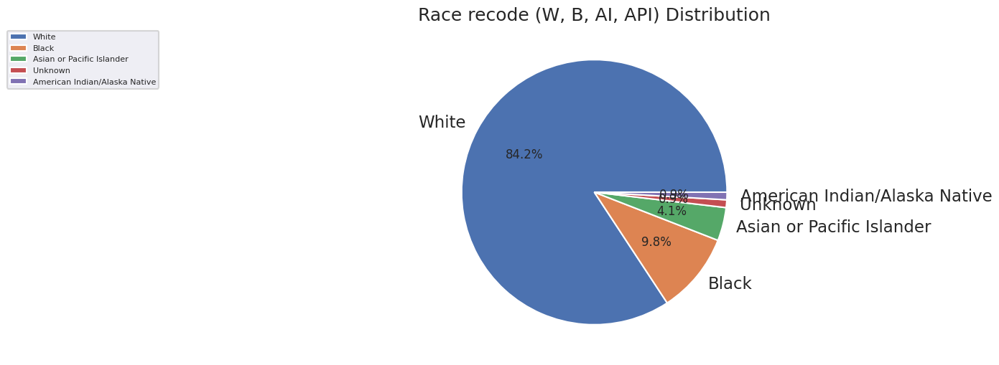

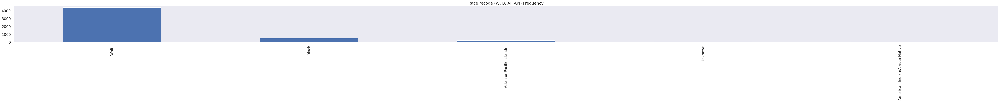

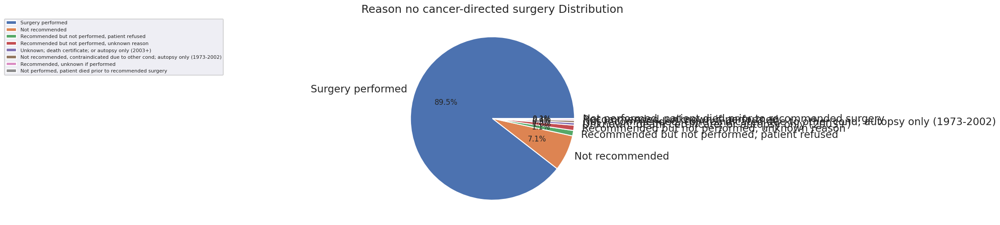

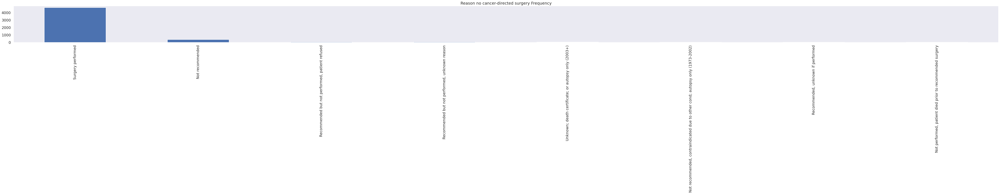

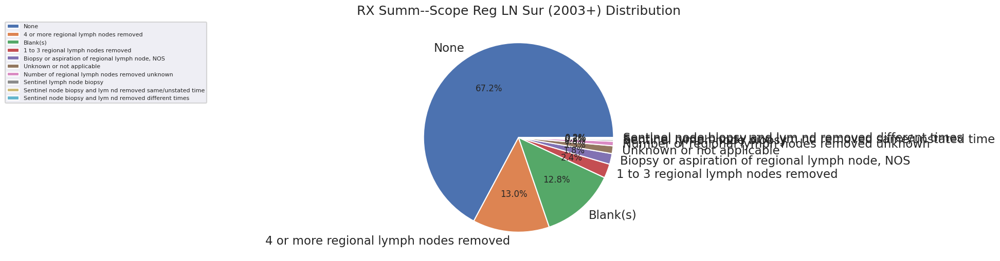

...

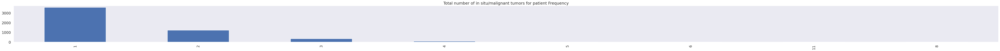

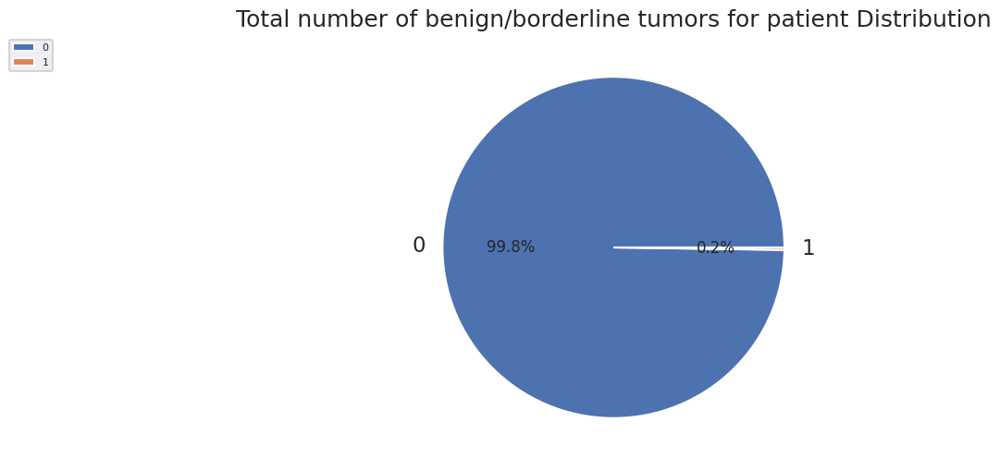

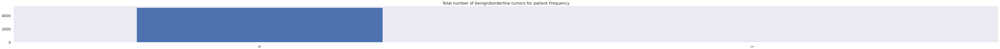

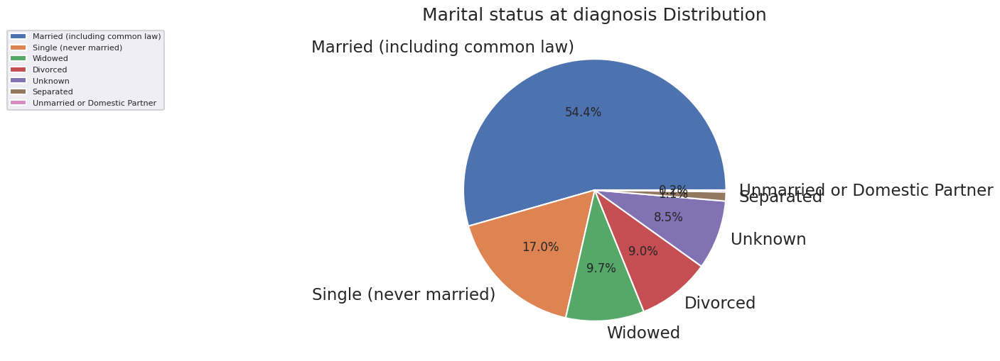

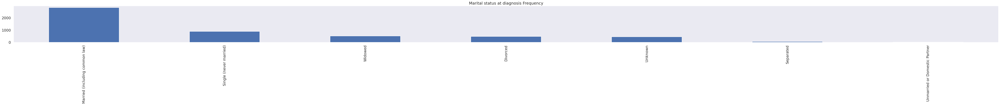

<Figure size 8000x300 with 0 Axes>

In [ ]:
for column in df:
  try:
    print('\n\n\n\n—————————\n', df[column].value_counts(normalize=False))
    # print(df[column].value_counts(normalize=False).sort_index())
    print('\n\n')
    print(df[column].value_counts(normalize=True).sort_index())
    pie_maker(df, column)
    histogram_maker(df, column)
  except:
    print('Failure encountered on column', column)

Top Absolute Correlations

COD to site rec KM                      COD to site recode                        0.999996
SEER Combined Mets at DX-bone (2010+)   SEER Combined Mets at DX-liver (2010+)    0.999935
                                        SEER Combined Mets at DX-lung (2010+)     0.999785
Mets at DX-Distant LN (2016+)           Mets at DX-Other (2016+)                  0.999783
SEER Combined Mets at DX-liver (2010+)  SEER Combined Mets at DX-lung (2010+)     0.999715
SEER Combined Mets at DX-brain (2010+)  SEER Combined Mets at DX-liver (2010+)    0.997491
SEER Combined Mets at DX-bone (2010+)   SEER Combined Mets at DX-brain (2010+)    0.997078
SEER Combined Mets at DX-brain (2010+)  SEER Combined Mets at DX-lung (2010+)     0.996810
CS mets at dx (2004-2015)               CS Mets Eval (2004-2015)                  0.983165
Grade Clinical (2018+)                  Grade Pathological (2018+)                0.982798
dtype: float64
error 'Age recode with <1 year olds'
Iteration 1

<lifelines.CoxPHFitter: fitted with 61 total observations, 0 right-censored observations>
             duration col = 'Survival months'
      baseline estimation = breslow
   number of observations = 61
number of events observed = 61
   partial log-likelihood = -175.31
         time fit was run = 2023-11-30 22:20:26 UTC

---
                            coef  exp(coef)   se(coef)   coef lower 95%   coef upper 95%  exp(coef) lower 95%  exp(coef) upper 95%
covariate                                                                                                                         
RX Summ--Systemic/Sur Seq   3.24      25.63       0.67             1.92             4.56                 6.85                95.83
Grade (thru 2017)           3.30      27.02       0.65             2.02             4.58                 7.51                97.27

                            cmp to    z      p   -log2(p)
covariate                                                
RX Summ--Systemic/Sur Seq     0.00 4.82 <0.005      19.41
Grade (thru 2017)             0.00 5.04 <0.005      21.06
---
Concordance = 0.71
Partial AIC = 354.63
log-likelihood ratio test = 34.85 on 2 df
-log2(p) of ll-ratio test = 25.14

                                   RX Summ--Systemic/Sur Seq  Grade (thru 2017)  Survival months
Survival months                                    -0.157747          -0.127636         1.000000
RX Summ--Surg Prim Site (1998+)                    -0.018382          -0.135390         0.025962
Age recode with <1 year olds                        0.042315          -0.034025         0.097059
Race recode (W, B, AI, API)                        -0.000042          -0.004321        -0.006757
Reason no cancer-directed surgery                   0.002392          -0.071300        -0.052916


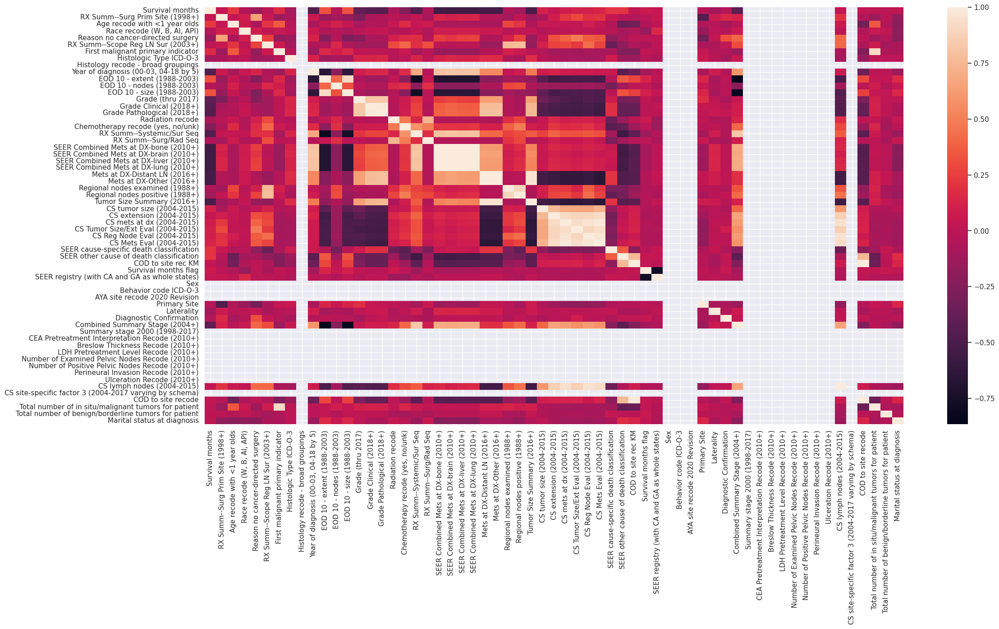

In [ ]:
generate_heatmap(df, 10)

In [ ]:
df['Regional nodes positive (1988+)'].value_counts()

98    3944
0      467
1      229
99     140
2      112
95      84
3       66
97      59
4       32
5       19
6       19
7        9
8        7
10       6
9        5
11       4
18       3
12       3
13       2
15       2
20       1
14       1
17       1
19       1
16       1
26       1
23       1
Name: Regional nodes positive (1988+), dtype: int64

In [ ]:
sorted(df['Regional nodes positive (1988+)'].unique())

reg_nod_pos_num_dict = {0: 'None',
 5: '5+',
 6: '5+',
 7: '5+',
 8: '5+',
 9: '5+',
 10: '5+',
 11: '5+',
 12: '5+',
 13: '5+',
 14: '5+',
 15: '5+',
 16: '5+',
 17: '5+',
 18: '5+',
 19: '5+',
 20: '5+',
 23: '5+',
 26: '5+'} # ignore > 95

In [ ]:
df['Race recode (W, B, AI, API)'].unique()

array(['White', 'Asian or Pacific Islander', 'Black',
       'American Indian/Alaska Native', 'Unknown'], dtype=object)

In [ ]:
white_df = df[df['Race recode (W, B, AI, API)'] == 'White']
black_df = df[df['Race recode (W, B, AI, API)'] == 'Black']
asian_df = df[df['Race recode (W, B, AI, API)'] == 'Asian or Pacific Islander']

In [ ]:
for col in df.columns:
  if len(df[col].unique()) < 25 and col != 'Survival months':
    for v in df[col].unique():
      if len(df[df[col] == v]['Survival months']) > 25:
        try:
          print('\n\n', col, '===>', v,
                'White:\n', pd.to_numeric(white_df[white_df[col] == v]['Survival months']).describe(),
                'Black:\n', pd.to_numeric(black_df[black_df[col] == v]['Survival months']).describe(),
                'Asian:\n', pd.to_numeric(asian_df[asian_df[col] == v]['Survival months']).describe())
        except Exception as e:
          print('Ran into error here, code', e)



 RX Summ--Surg Prim Site (1998+) ===> 60 White:
 count    149.000000
mean      45.476510
std       53.025311
min        1.000000
25%        9.000000
50%       19.000000
75%       67.000000
max      223.000000
Name: Survival months, dtype: float64 Black:
 count     18.000000
mean      67.611111
std       76.307535
min        0.000000
25%        5.250000
50%       43.000000
75%      107.000000
max      216.000000
Name: Survival months, dtype: float64 Asian:
 count      9.000000
mean      44.333333
std       58.330952
min        3.000000
25%        9.000000
50%       18.000000
75%       35.000000
max      162.000000
Name: Survival months, dtype: float64


 RX Summ--Surg Prim Site (1998+) ===> 30 White:
 count    2100.000000
mean       56.030000
std        54.038907
min         0.000000
25%        13.000000
50%        36.500000
75%        86.000000
max       225.000000
Name: Survival months, dtype: float64 Black:
 count    234.000000
mean      52.568376
std       50.823071
min        2.0

In [ ]:
df['Histology recode - broad groupings'].value_counts().index

Index(['8050-8089: squamous cell neoplasms'], dtype='object')

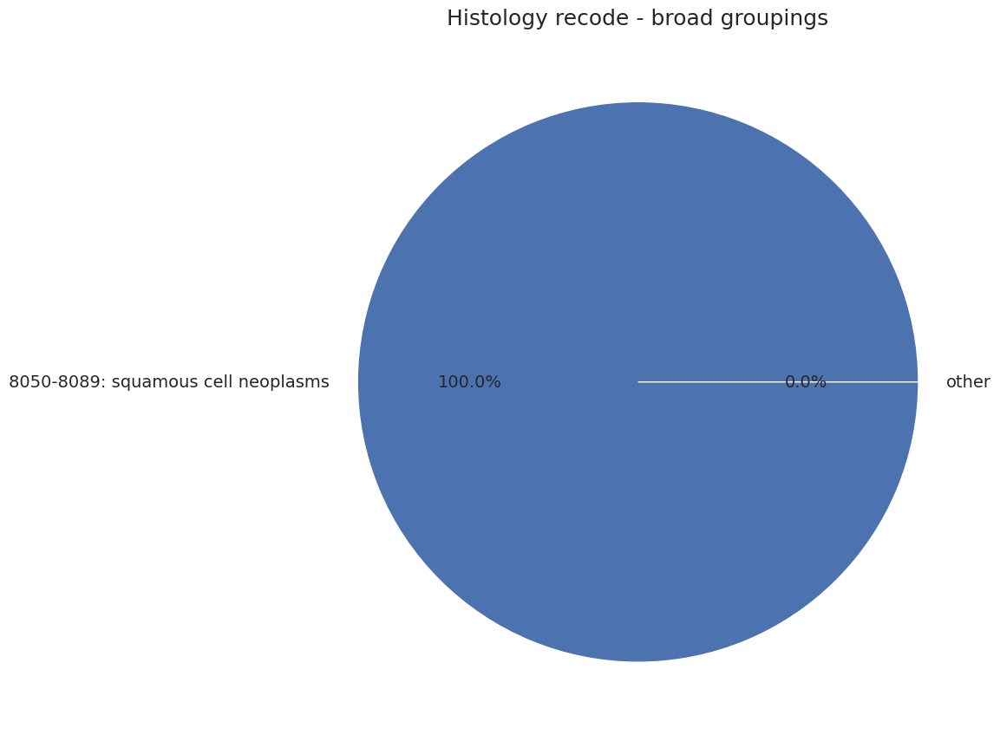

In [ ]:
res = pd.Series(df['Histology recode - broad groupings'].value_counts(), index=df['Histology recode - broad groupings'].value_counts().index).sort_values(ascending=False)

abridged_res = res[:10]
other = sum(res[10:])

res = pd.concat((abridged_res, pd.Series({'other': other})))

# print(res)

fig, ax = plt.subplots()
ax.pie(res, labels=res.index, textprops={'fontsize': 14}, autopct='%1.1f%%',)

plt.title('Histology recode - broad groupings',size = 18)
plt.ticklabel_format(style='plain')
# plt.legend()

fig = plt.gcf()
fig.set_size_inches(18.5, 10.5)


In [ ]:
useful_df = df[df['Survival months'] != 'Unknown']

l1 = list(useful_df['Year of diagnosis (00-03, 04-18 by 5)'].unique())
l2 = [pd.Series(useful_df[useful_df['Year of diagnosis (00-03, 04-18 by 5)'] == x]['Survival months']).astype(int).mean() for x in l1]

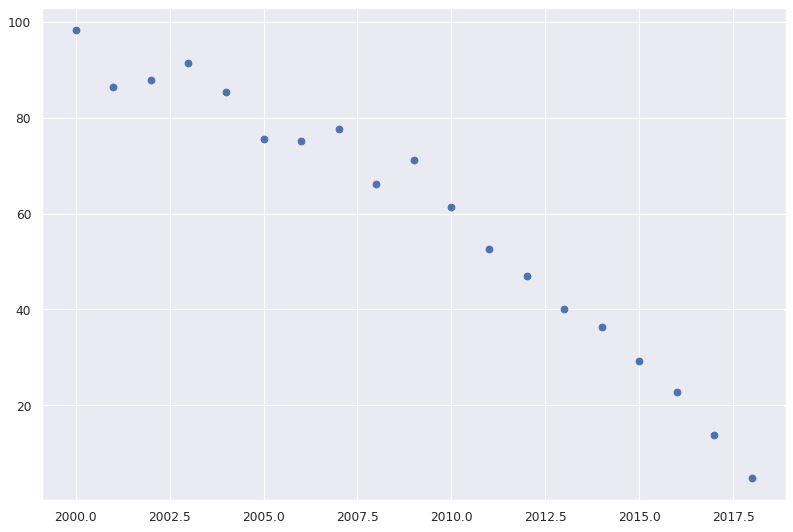

In [ ]:
plt.figure(figsize=(12, 8), dpi=80)
plt.scatter(l1, l2)

array([[<Axes: title={'center': 'Year of diagnosis (00-03, 04-18 by 5)'}>]],
      dtype=object)

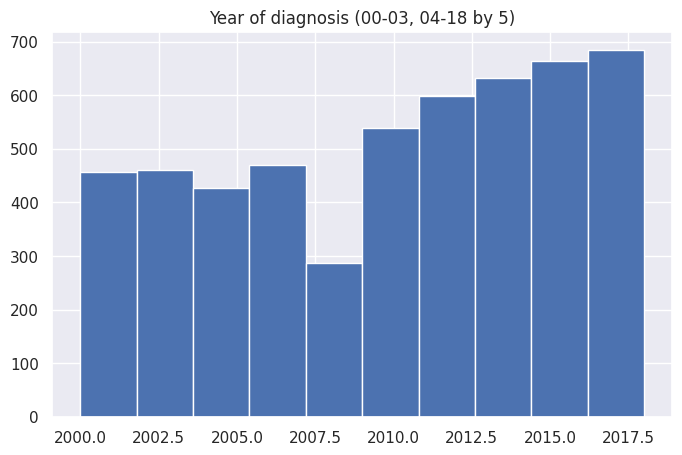

In [ ]:
df.hist('Year of diagnosis (00-03, 04-18 by 5)', figsize=(8,5))

8050-8089: squamous cell neoplasms 				 cases_looked: 1136 	 cases_+: 668 	 cases_total: 5219 	 0.12799386855719486


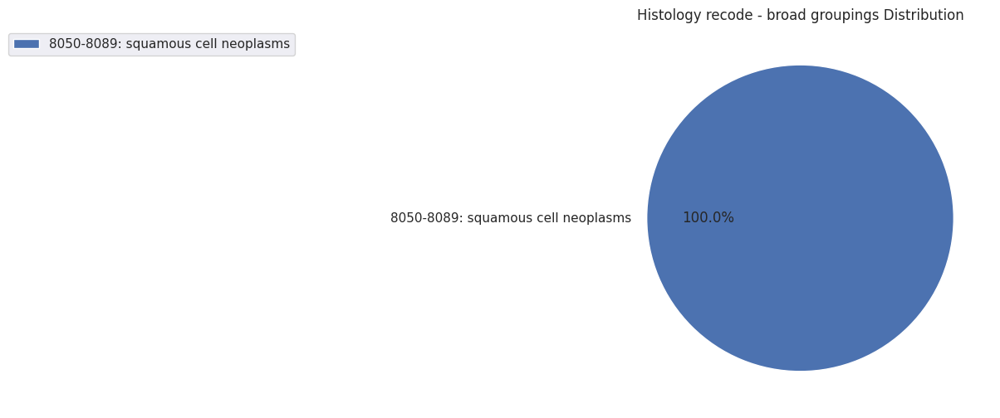

<Figure size 2500x1200 with 0 Axes>

In [ ]:
for hist in df['Histology recode - broad groupings'].unique():

  total_cases = df[df['Histology recode - broad groupings'] == hist].shape[0]
  pos_cases = df[
      (df['Histology recode - broad groupings'] == hist) &
      (~df['Regional nodes positive (1988+)'].isin([0, 99, 98]))
    ].shape[0]

  cases_looked = df[
      (df['Histology recode - broad groupings'] == hist) &
      (~df['Regional nodes examined (1988+)'].isin([0, 99]))
    ].shape[0]

  print(hist, '\t\t\t\t', 'cases_looked:', cases_looked, '\t', 'cases_+:', pos_cases, '\t', 'cases_total:', total_cases, '\t', pos_cases/total_cases)

pie_maker(df[~df['Regional nodes examined (1988+)'].isin([0, 99, '00'])], 'Histology recode - broad groupings', MAX_OVERRIDE=True)

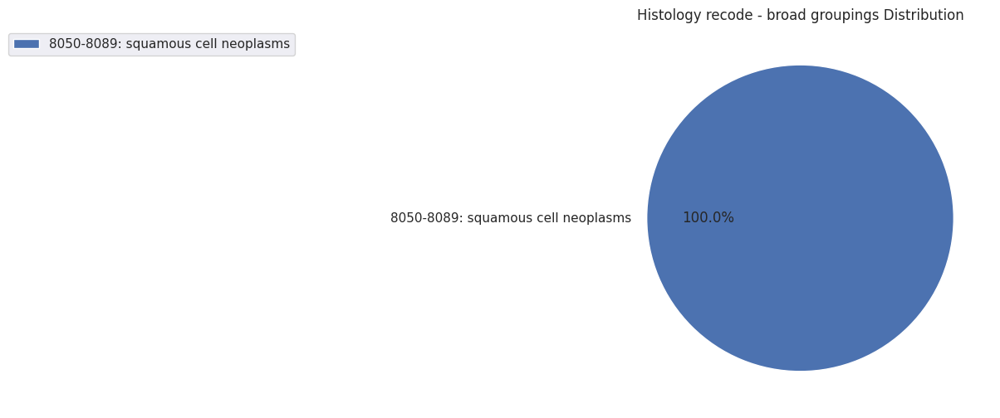

<Figure size 2500x1200 with 0 Axes>

In [ ]:
pie_maker(
    df[
        ~df['Regional nodes examined (1988+)'].isin([0, 99])
      ], 'Histology recode - broad groupings')

In [ ]:
#@title
# pie_maker(df[df['Surgery Performed'] == 'Surgery'], 'Regional nodes positive (1988+)')

In [ ]:
df['Regional nodes positive (1988+)'].value_counts()

98    3944
0      467
1      229
99     140
2      112
95      84
3       66
97      59
4       32
5       19
6       19
7        9
8        7
10       6
9        5
11       4
18       3
12       3
13       2
15       2
20       1
14       1
17       1
19       1
16       1
26       1
23       1
Name: Regional nodes positive (1988+), dtype: int64

In [ ]:
df['Regional nodes examined (1988+)'].value_counts()

0     3944
99     139
1      113
95     108
98      54
2       40
14      37
16      36
17      36
8       31
97      31
10      29
11      28
15      28
3       27
18      27
12      26
20      26
9       25
4       24
7       24
5       23
21      22
19      20
23      18
22      18
13      18
25      17
27      17
31      15
6       15
24      14
26      14
32      14
30      13
28      13
29      12
41      10
38       9
34       9
33       8
35       8
36       7
42       7
37       6
39       6
40       6
49       5
50       5
45       4
46       3
96       3
51       3
47       2
53       2
43       2
59       1
44       1
56       1
54       1
63       1
84       1
67       1
48       1
57       1
66       1
82       1
55       1
90       1
69       1
64       1
52       1
73       1
78       1
Name: Regional nodes examined (1988+), dtype: int64

# Survival Analysis

### Lifelines

These make sense to do with every date.

#### Code

In [ ]:
def custom_sanitize_fx(lifelines_df):
  lifelines_df['Age recode with <1 year olds'] = lifelines_df['Age recode with <1 year olds'].apply(lambda i: i[0:2])
  return lifelines_df

In [ ]:
# Function that finds indices of variables with >n unique values. Practically useful to distinguish categorical & quantitative variables.
# Used here as a way to approximate columns that contain dates.

MAX_QUAL_GROUP_SIZE = 50000042 # calculated by going through value counts for each variable


def find_quant_and_cat(df):
  cat_list = []
  ctr = 0
  quant_list = list(range(len(df.columns)))


  for column in df:
    ser = df[column]
    if len(df[column].unique()) <= MAX_QUAL_GROUP_SIZE:
      cat_list.append(ctr)
      quant_list.remove(ctr)

    ctr += 1

  return cat_list, quant_list

In [ ]:
cat_list, quant_list = find_quant_and_cat(df)
cat_list_names = []
quant_list_names = []

for i in quant_list:
  quant_list_names.append(df.columns[i])

for i in cat_list:
  cat_list_names.append(df.columns[i])

print(quant_list_names)

[]


In [ ]:
sns.set(style='dark', context='talk')

In [ ]:
# This function is used to convert months of survival into years

def helper_function(val):
  if val == 'Unknown':
    pass
  else:
    return int(val)/12

In [ ]:
def prepare_obs_for_lifelines(df, start_pt_col_name, year = True, col_sort = None):
  lifelines_df = custom_sanitize_fx(df)

  if col_sort:
    lifelines_df.sort_values(by=[col_sort], inplace=True, ignore_index=True)

  # groups=lifelines_df.pivot_table(index=['Survival months'],aggfunc='size').value_counts()

  obs = pd.DataFrame()

  if year:
    obs['start'] = pd.to_numeric(lifelines_df[start_pt_col_name].apply(lambda i: int(i - 2000))) # min is 1975
  else:
    obs['start'] = pd.to_numeric(lifelines_df[start_pt_col_name])

  obs['end'] = obs['start'] + lifelines_df['Survival months'].apply(lambda i: helper_function(i))
  # survival in months/12
  obs['status'] = [0] * len(lifelines_df['Survival months'])

  return obs

In [ ]:
def plot_lifelines(obs, title_start_pt, sort = None):
    """Plot a line for each observation.

    obs: DataFrame
    """

    for y, row in obs.iterrows():
        start = row['start']
        end = row['end']
        status = row['status']

        if status == 0:
            # ongoing
            plt.hlines(y, start, end, color='C0')
        else:
            # complete
            plt.hlines(y, start, end, color='C1')
            plt.plot(end, y, marker='o', color='C1')

    sort_phrase = ' Sorted (D->A) by ' + str(sort)

    plt.xlabel('Survival (years)')
    plt.ylabel('Patient index' + sort_phrase)
    plt.rcParams["figure.figsize"] = (80,3)
    plt.gca().invert_yaxis()
    plt.title('Survival in Years Based on ' + title_start_pt +  ' By Patient')
    plt.show()

In [ ]:
def plot_duration_lifeline(df, obs, title_start_pt):
  duration = pd.Series(df['Survival months'].apply(lambda i: helper_function(i))).dropna()

  shifted = obs.copy()
  shifted['start'] = 0
  shifted['end'] = duration

  plot_lifelines(shifted, title_start_pt + " Duration")
  plt.xlabel('Duration (weeks)');


In [ ]:
def master_lifelines_fx(df, start_pt_col_name, year = True, sort = None):
  lifelines_df = copy.deepcopy(df)
  obs = prepare_obs_for_lifelines(lifelines_df, start_pt_col_name, year, sort)
  plot_lifelines(obs, start_pt_col_name, sort)
  plot_duration_lifeline(lifelines_df, obs, start_pt_col_name)

#### Outputs (user input necessary)

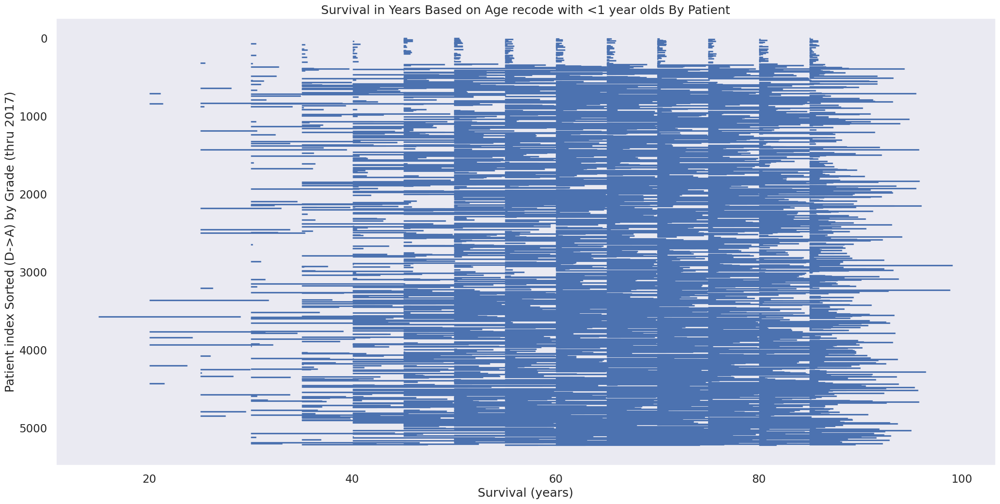

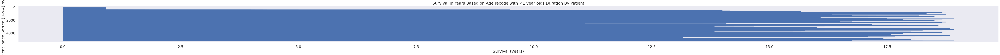

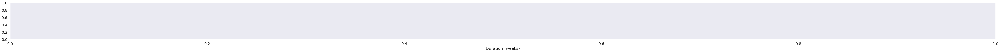

In [ ]:
master_lifelines_fx(df, 'Age recode with <1 year olds', year=False, sort='Grade (thru 2017)')

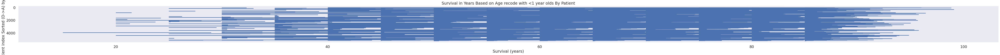

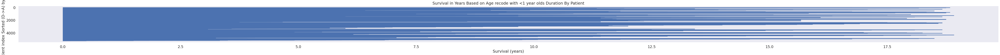

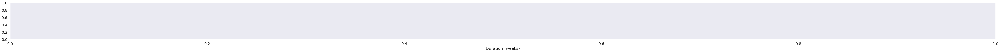

In [ ]:
master_lifelines_fx(df, 'Age recode with <1 year olds', year=False)

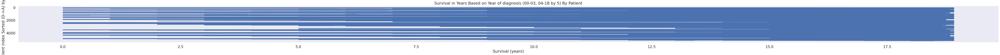

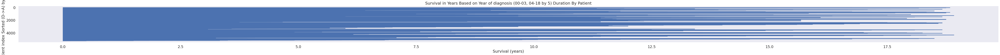

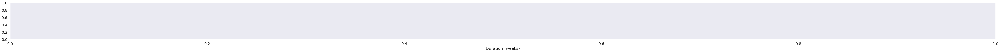

In [ ]:
master_lifelines_fx(df, 'Year of diagnosis (00-03, 04-18 by 5)', True)

In [ ]:
df_trial = pd.DataFrame({'A': ['a', 'b', 'a'], 'B': ['b', 'a', 'c'],
                   'C': [1, 2, 3]})

In [ ]:
pd.get_dummies(df_trial, prefix=['col1', 'col2'])

,C,col1_a,col1_b,col2_a,col2_b,col2_c
0,1,1,0,0,1,0
1,2,0,1,1,0,0
2,3,1,0,0,0,1


In [ ]:
# Make everything in df quantitative
df = df[df['Survival months'] != 'Unknown']
df['Survival months]'] = df['Survival months'].astype(int)
df['Age recode with <1 year olds'] = df['Age recode with <1 year olds'].str[:2].astype(int)

In [ ]:
for col in df.columns:
  failure_list = []
  try:
    df[col] = df[col].astype(int)
  except:
    failure_list.append(col)

### KM Curve Generation

###### Code

In [ ]:
# Only Relevant for SEERS Cancer Studies
def mets_anywhere(row):
  MET_LIST = ['SEER Combined Mets at DX-bone (2010+)',
            'SEER Combined Mets at DX-brain (2010+)',
            'SEER Combined Mets at DX-liver (2010+)',
            'SEER Combined Mets at DX-lung (2010+)',
            'Mets at DX-Distant LN (2016+)',
            'Mets at DX-Other (2016+)',
            'EOD Mets (2018+)']
  for col in MET_LIST:
    if row[col] == 'Yes':
      return 1

  return 0

In [ ]:
def simple_KM(df):
  T = df['Survival months'].apply(lambda i: helper_function(i)).dropna()
  E = pd.Series(1, index=range(len(T)))

  kmf = KaplanMeierFitter()
  kmf.fit(T, event_observed=E)  # or, more succinctly, kmf.fit(T, E)
  plt.rcParams["figure.figsize"] = (10,3)
  plt.xlabel('Time (years)')
  plt.title('Overall Survival of ' + DATA_PATH)

  kmf.survival_function_
  kmf.cumulative_density_
  kmf.plot_survival_function()

In [ ]:
import time

#subpop is a dictionary of {column name, dictionary{value before: value after}}
def KM_generator(group_nameS, df = df, subpop = None, title_add = '', figsize = (8, 6)):
  figure(figsize=figsize)
  kmf = KaplanMeierFitter()
  plt.rc('legend',fontsize=8) # using a size in points
  for group_name in group_nameS:
    # print('\n\n', group_name)

    if df[group_name].empty or df[group_name].dropna().empty:
      print("Aborting... empty array.")
      continue

    else:
      try:
        ax = plt.gca()

              # set our base dataframe as the df where condition is true
          # df = df

        # Level of each individual plot

        manip_df = copy.deepcopy(df) # get ready / start anew

        if subpop: # if we want to look at a subpopulation
          if group_name in subpop.keys(): #subpop is a dictionary of {column name, dictionary{value before: value after}}
            # so if we want to group things within *this* column
            manip_df[group_name] = manip_df[group_name].replace(subpop[group_name])

        # group_name is the column name for which we want to group values.
        # name is each unique instance the variable takes
        # grouped_df is the dataframe for all values where name is the same thing
        for name, grouped_df in manip_df.groupby(group_name):

            T = grouped_df['Survival months'].apply(lambda i: helper_function(i)).dropna()
            E = pd.Series(1, index=range(len(T)))

            kmf.fit(T, E, label=name)
            kmf.plot_survival_function(ax=ax)

        ax.set_ylabel('% Surviving')
        ax.set_xlabel('Time (years)')
        ax.set_xlim(0, 5)
        ax.set_title(group_name + ' ' + title_add)
        # plt.legend(bbox_to_anchor=(1.1, -0.2))
        plt.show()
        figure(num=1, figsize=figsize)
        plt.cla()
      except Exception as e:
        print('group name that threw error =', group_name)
        print(e)
        plt.cla()

def simple_single_grouped_KM_wrapper(group_name, groups = None, df = df, title_add = '', ax=None):
  if not groups:
    ax = KM_generator([group_name], df,
                      title_add = title_add,
                      # ax=ax
                      )
    return ax
  else:
    subpop = {group_name: groups}
    ax = KM_generator([group_name], df, subpop,
                      title_add = title_add,
                      # ax=ax
                      )
    return ax

######Outputs (user input necessary)


Keep in mind KM_generator requires a 'Survival months' column— if your dataset does not have this, you'll need to re-engineer this a bit.

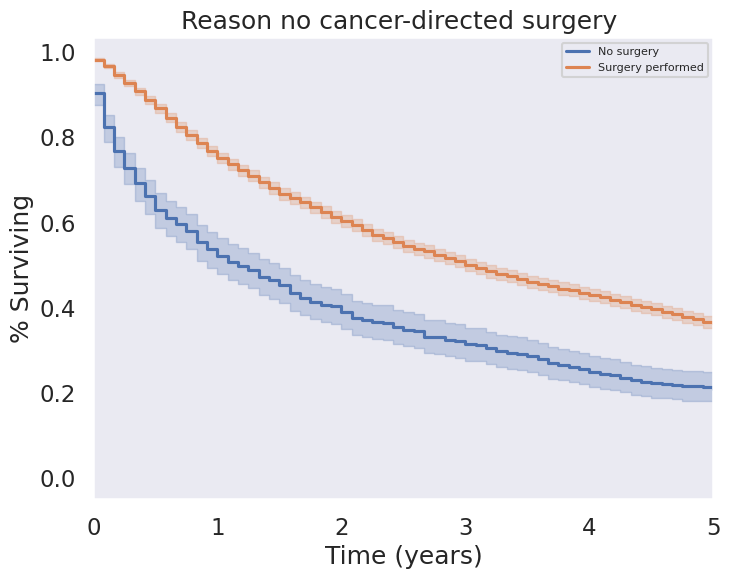

0       Surgery performed
1       Surgery performed
2       Surgery performed
3       Surgery performed
4       Surgery performed
5              No surgery
6              No surgery
7       Surgery performed
8       Surgery performed
9       Surgery performed
10      Surgery performed
11      Surgery performed
12      Surgery performed
13      Surgery performed
14      Surgery performed
15      Surgery performed
16      Surgery performed
17      Surgery performed
18      Surgery performed
19             No surgery
20      Surgery performed
21      Surgery performed
22      Surgery performed
23      Surgery performed
24      Surgery performed
25      Surgery performed
26      Surgery performed
27      Surgery performed
28      Surgery performed
29      Surgery performed
30      Surgery performed
31      Surgery performed
32      Surgery performed
33             No surgery
34      Surgery performed
35             No surgery
36      Surgery performed
37      Surgery performed
38      Surg

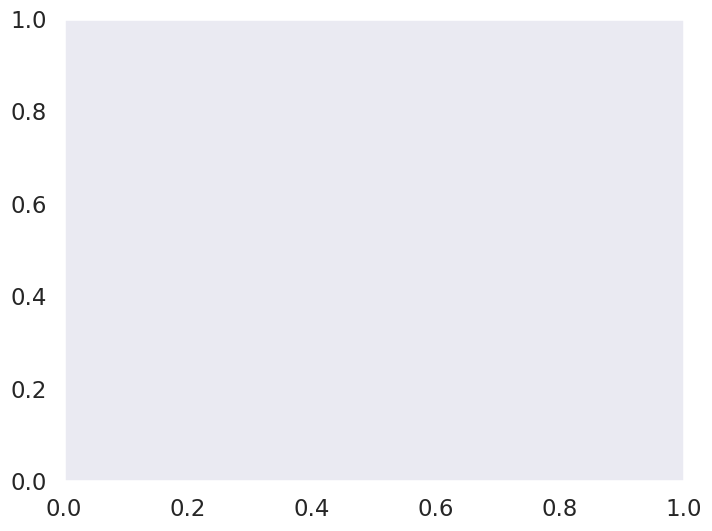

In [ ]:
simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', reason_no_surg_dict)
df['Surgery Performed'] = df['Reason no cancer-directed surgery'].replace(reason_no_surg_dict)
df['Reason no cancer-directed surgery'].replace(reason_no_surg_dict)

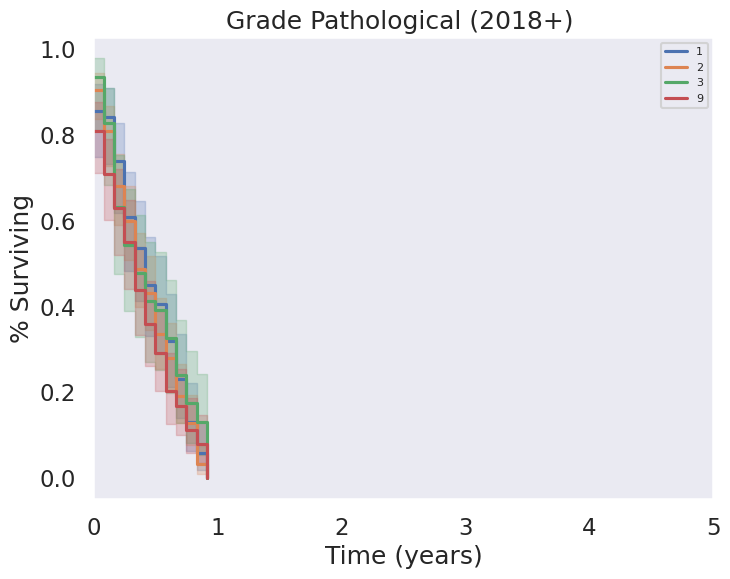

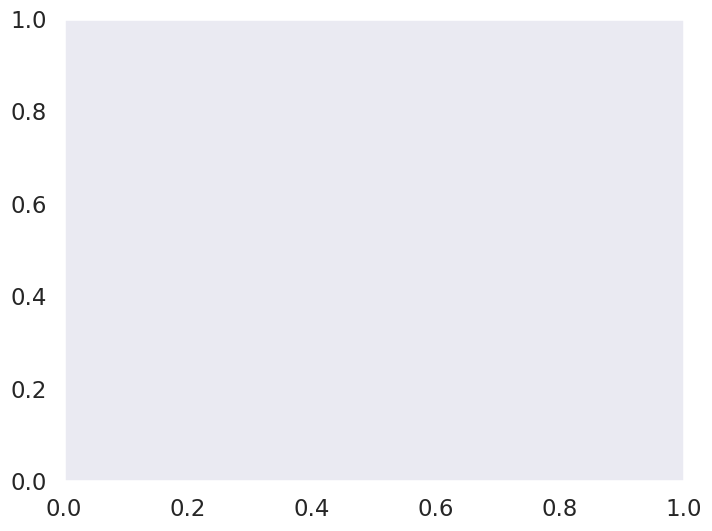

In [ ]:
# df['Grade Clinical (2018+)']
ax = simple_single_grouped_KM_wrapper('Grade Pathological (2018+)', df=df[df['Grade Pathological (2018+)'] != "Blank(s)"])

In [ ]:
print(ax)

None


In [ ]:
reg_n_xam_dict = {
  0 : "None",
#  99 : ">90",
 1 : "1-3 nodes examined",
#  95: ">90",
#  98: ">90",
 2 : "1-3 nodes examined",
 14 : ">4 nodes examined",
 16 : ">4 nodes examined",
 17 : ">4 nodes examined",
 8 : ">4 nodes examined",
#  97: ">90",
 10 : ">4 nodes examined",
 11 : ">4 nodes examined",
 15 : ">4 nodes examined",
 3: "1-3 nodes examined",
 18 : ">4 nodes examined",
 12 : ">4 nodes examined",
 20 : ">4 nodes examined",
 9 : ">4 nodes examined",
 4 : ">4 nodes examined",
 7 : ">4 nodes examined",
 5 : ">4 nodes examined",
 21 : ">4 nodes examined",
 19 : ">4 nodes examined",
 23 : ">4 nodes examined",
 22 : ">4 nodes examined",
 13 : ">4 nodes examined",
 25 : ">4 nodes examined",
 27 : ">4 nodes examined",
 31 : ">4 nodes examined",
 6 : ">4 nodes examined",
 24 : ">4 nodes examined",
 26 : ">4 nodes examined",
 32 : ">4 nodes examined",
 30 : ">4 nodes examined",
 28 : ">4 nodes examined",
 29 : ">4 nodes examined",
 41 : ">4 nodes examined",
 38 : ">4 nodes examined",
 34 : ">4 nodes examined",
 33 : ">4 nodes examined",
 35 : ">4 nodes examined",
 36 : ">4 nodes examined",
 42 : ">4 nodes examined",
 37 : ">4 nodes examined",
 39 : ">4 nodes examined",
 40 : ">4 nodes examined",
 49 : ">4 nodes examined",
 50 : ">4 nodes examined",
 45 : ">4 nodes examined",
 46 : ">4 nodes examined",
 96 : ">4 nodes examined",
 51 : ">4 nodes examined",
 47 : ">4 nodes examined",
 53 : ">4 nodes examined",
 43 : ">4 nodes examined",
 59 : ">4 nodes examined",
 44 : ">4 nodes examined",
 56 : ">4 nodes examined",
 54 : ">4 nodes examined",
 63 : ">4 nodes examined",
 84 : ">4 nodes examined",
 67 : ">4 nodes examined",
 48 : ">4 nodes examined",
 57 : ">4 nodes examined",
 66 : ">4 nodes examined",
 82 : ">4 nodes examined",
 55 : ">4 nodes examined",
 90 : ">4 nodes examined",
 69 : ">4 nodes examined",
 64 : ">4 nodes examined",
 52 : ">4 nodes examined",
 73 : ">4 nodes examined",
 78 : ">4 nodes examined"
 }

reg_n_xam_dict_binary = {
  0 : "<4 nodes examined",
#  99 : ">90",
 1 : "<4 nodes examined",
#  95: ">90",
#  98: ">90",
 2 : "<4 nodes examined",
 14 : ">4 nodes examined",
 16 : ">4 nodes examined",
 17 : ">4 nodes examined",
 8 : ">4 nodes examined",
#  97: ">90",
 10 : ">4 nodes examined",
 11 : ">4 nodes examined",
 15 : ">4 nodes examined",
 3: "<4 nodes examined",
 18 : ">4 nodes examined",
 12 : ">4 nodes examined",
 20 : ">4 nodes examined",
 9 : ">4 nodes examined",
 4 : ">4 nodes examined",
 7 : ">4 nodes examined",
 5 : ">4 nodes examined",
 21 : ">4 nodes examined",
 19 : ">4 nodes examined",
 23 : ">4 nodes examined",
 22 : ">4 nodes examined",
 13 : ">4 nodes examined",
 25 : ">4 nodes examined",
 27 : ">4 nodes examined",
 31 : ">4 nodes examined",
 6 : ">4 nodes examined",
 24 : ">4 nodes examined",
 26 : ">4 nodes examined",
 32 : ">4 nodes examined",
 30 : ">4 nodes examined",
 28 : ">4 nodes examined",
 29 : ">4 nodes examined",
 41 : ">4 nodes examined",
 38 : ">4 nodes examined",
 34 : ">4 nodes examined",
 33 : ">4 nodes examined",
 35 : ">4 nodes examined",
 36 : ">4 nodes examined",
 42 : ">4 nodes examined",
 37 : ">4 nodes examined",
 39 : ">4 nodes examined",
 40 : ">4 nodes examined",
 49 : ">4 nodes examined",
 50 : ">4 nodes examined",
 45 : ">4 nodes examined",
 46 : ">4 nodes examined",
 96 : ">4 nodes examined",
 51 : ">4 nodes examined",
 47 : ">4 nodes examined",
 53 : ">4 nodes examined",
 43 : ">4 nodes examined",
 59 : ">4 nodes examined",
 44 : ">4 nodes examined",
 56 : ">4 nodes examined",
 54 : ">4 nodes examined",
 63 : ">4 nodes examined",
 84 : ">4 nodes examined",
 67 : ">4 nodes examined",
 48 : ">4 nodes examined",
 57 : ">4 nodes examined",
 66 : ">4 nodes examined",
 82 : ">4 nodes examined",
 55 : ">4 nodes examined",
 90 : ">4 nodes examined",
 69 : ">4 nodes examined",
 64 : ">4 nodes examined",
 52 : ">4 nodes examined",
 73 : ">4 nodes examined",
 78 : ">4 nodes examined"
 }

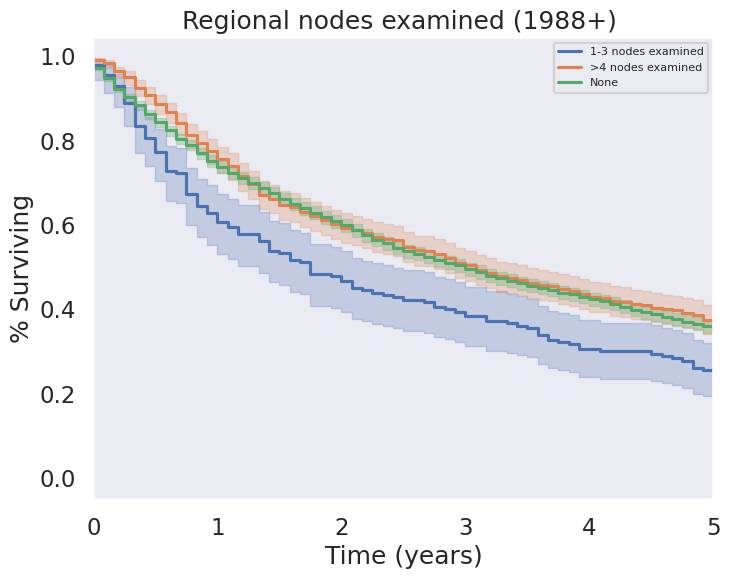

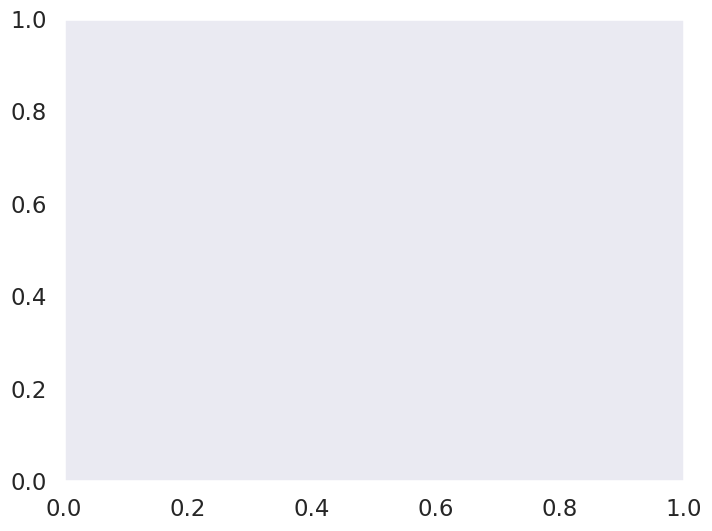

In [ ]:
simple_single_grouped_KM_wrapper('Regional nodes examined (1988+)', reg_n_xam_dict, df=df[df['Regional nodes examined (1988+)'] < 91])

In [ ]:
df['Regional nodes examined (1988+)'].value_counts()

0     3943
99     138
1      113
95     108
98      54
2       40
14      37
16      36
17      36
8       31
97      31
10      29
11      28
15      28
3       27
18      27
12      26
20      26
9       25
4       24
7       24
5       23
21      22
19      20
23      18
22      18
13      18
25      17
27      17
31      15
6       15
24      14
26      14
32      14
30      13
28      13
29      12
41      10
38       9
34       9
33       8
35       8
36       7
42       7
37       6
39       6
40       6
49       5
50       5
45       4
46       3
96       3
51       3
47       2
53       2
43       2
59       1
44       1
56       1
54       1
63       1
84       1
67       1
48       1
57       1
66       1
82       1
55       1
90       1
69       1
64       1
52       1
73       1
78       1
Name: Regional nodes examined (1988+), dtype: int64

In [ ]:
df['RX Summ--Scope Reg LN Sur (2003+)'].value_counts()

None                                                          3507
4 or more regional lymph nodes removed                         681
Blank(s)                                                       666
1 to 3 regional lymph nodes removed                            126
Biopsy or aspiration of regional lymph node, NOS                95
Unknown or not applicable                                       68
Number of regional lymph nodes removed unknown                  40
Sentinel lymph node biopsy                                      14
Sentinel node biopsy and lym nd removed same/unstated time      10
Sentinel node biopsy and lym nd removed different times         10
Name: RX Summ--Scope Reg LN Sur (2003+), dtype: int64

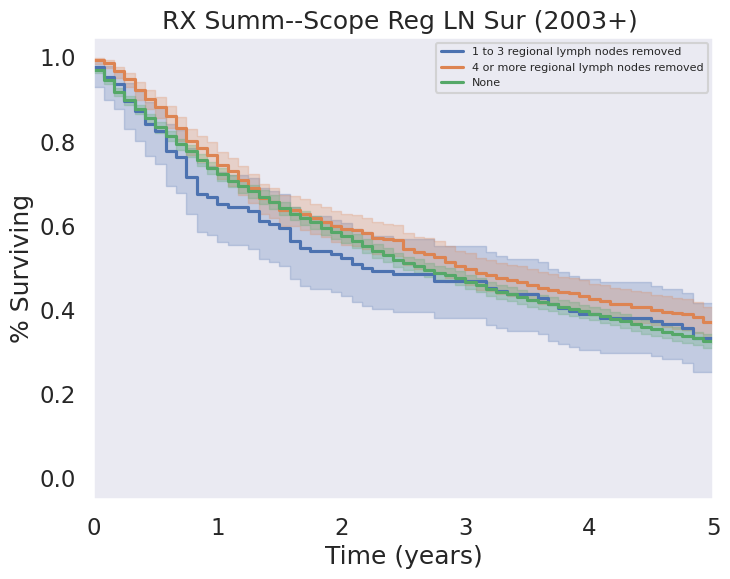

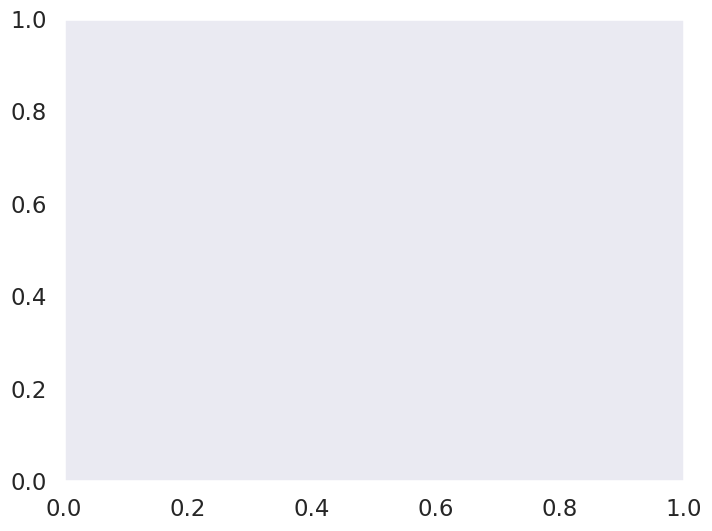

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Scope Reg LN Sur (2003+)',
                                 df=df[
                                     (df['RX Summ--Scope Reg LN Sur (2003+)'] == '4 or more regional lymph nodes removed') |
                                     (df['RX Summ--Scope Reg LN Sur (2003+)'] == '1 to 3 regional lymph nodes removed') |
                                     (df['RX Summ--Scope Reg LN Sur (2003+)'] == 'None')
                                     ])

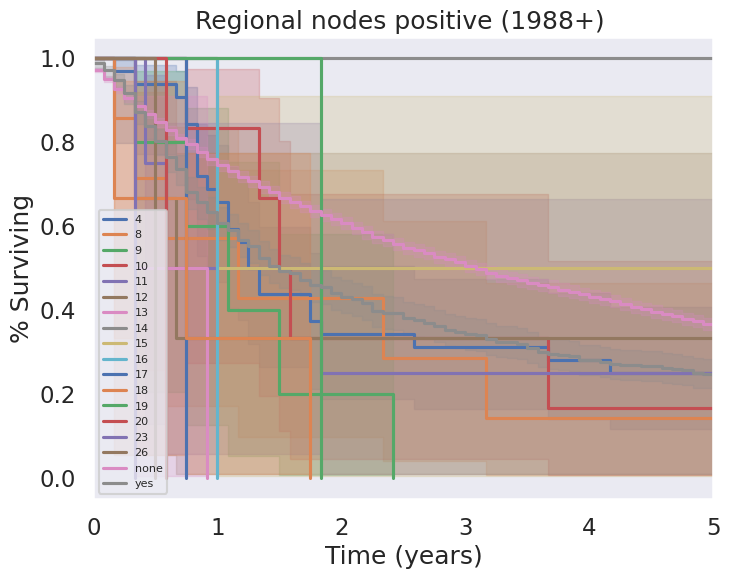

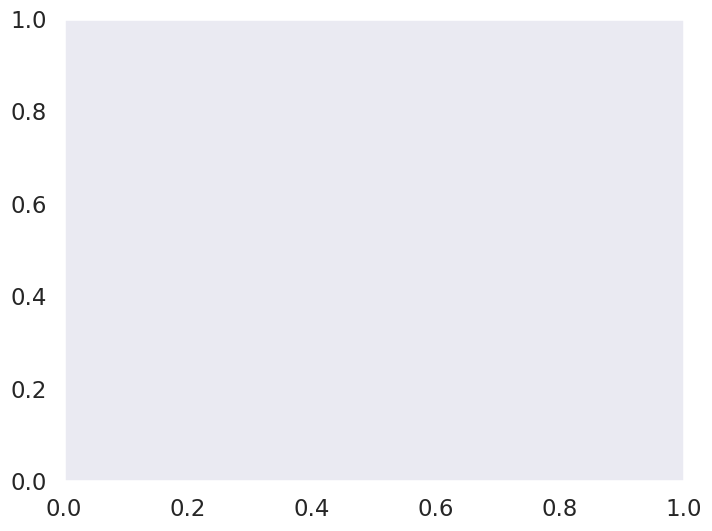

In [ ]:
simple_single_grouped_KM_wrapper('Regional nodes positive (1988+)', reg_nod_pos_dict, df=df[df['Regional nodes positive (1988+)'] != 99])

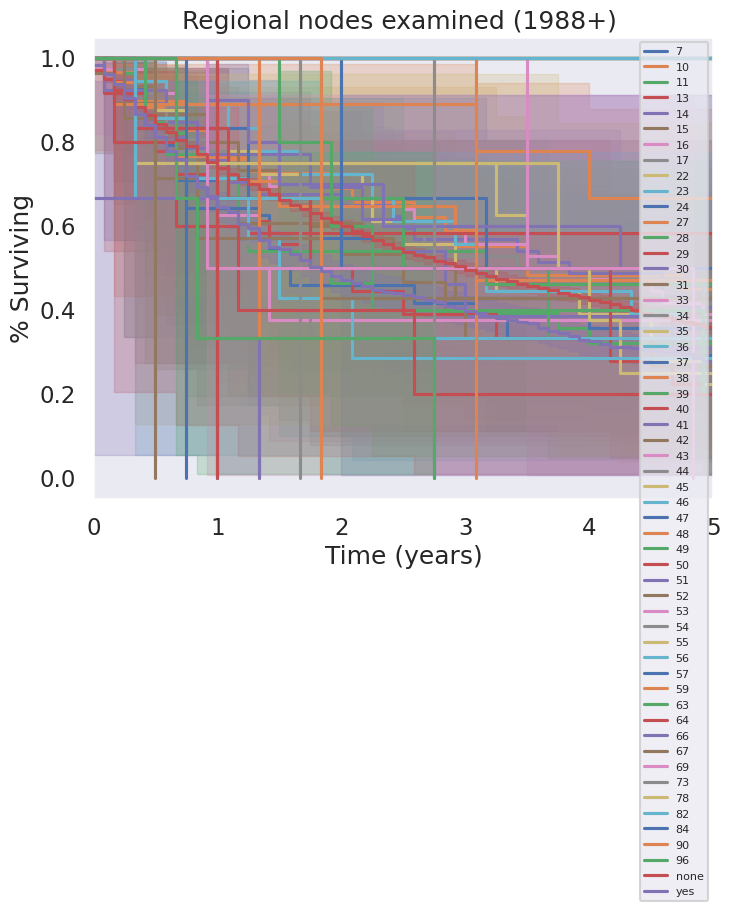

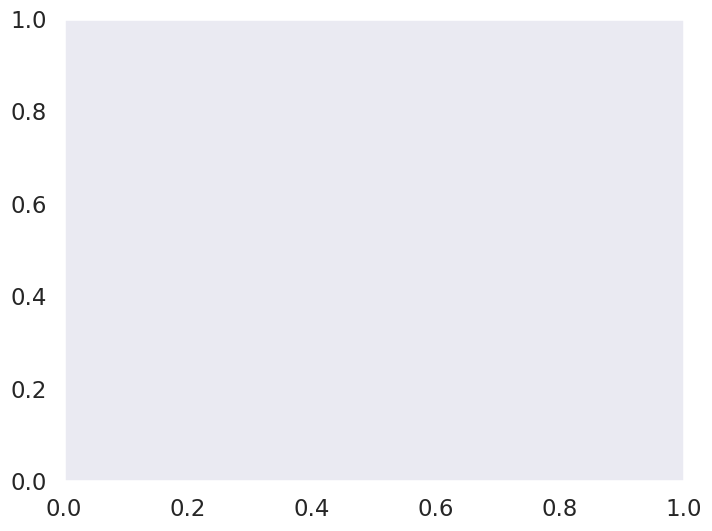

In [ ]:
simple_single_grouped_KM_wrapper('Regional nodes examined (1988+)', reg_examin_translate, df=df[df['Regional nodes examined (1988+)'] != 99])

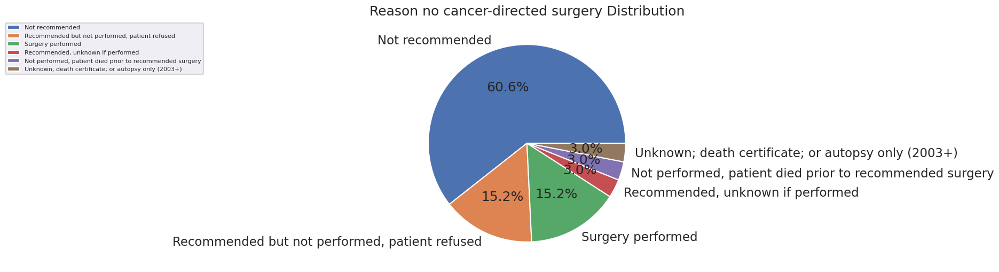

<Figure size 8000x300 with 0 Axes>

In [ ]:
pie_maker(df[df['Diagnostic Confirmation'] != 'Positive histology'], 'Reason no cancer-directed surgery')

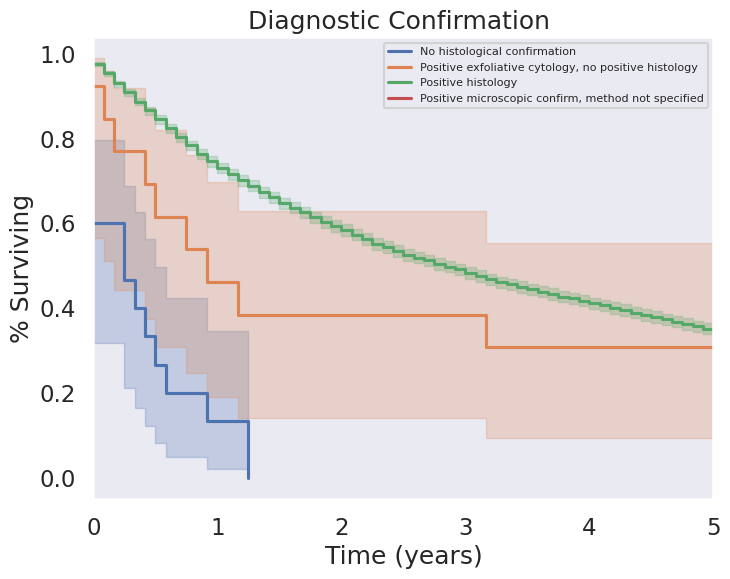

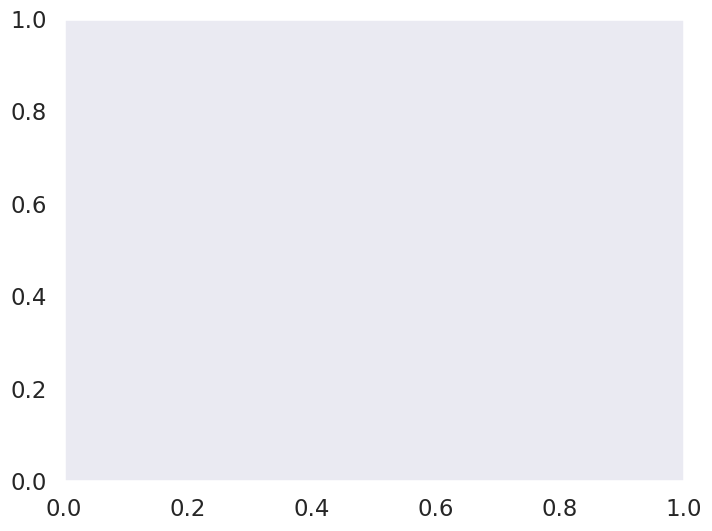

In [ ]:
simple_single_grouped_KM_wrapper('Diagnostic Confirmation', dx_meth_dict, df=df[df['Diagnostic Confirmation'] != 'Unknown'])

In [ ]:
df['Marital status at diagnosis']

0                              Unknown
1               Single (never married)
2       Married (including common law)
3       Married (including common law)
4                              Widowed
5                              Widowed
6                              Widowed
7       Married (including common law)
8       Married (including common law)
9       Married (including common law)
10      Married (including common law)
11                             Unknown
12      Married (including common law)
13      Married (including common law)
14              Single (never married)
15              Single (never married)
16              Single (never married)
17                           Separated
18      Married (including common law)
19                            Divorced
20              Single (never married)
21                            Divorced
22      Married (including common law)
23      Married (including common law)
24      Married (including common law)
25                       

In [ ]:
lymphomas_df = df[
    df['Histology recode - broad groupings'].isin(
        ['9590-9599: malignant lymphomas, NOS or diffuse',
         '9670-9699: nhl - mature b-cell lymphomas',
         '9700-9719: nhl - mature t and nk-cell lymphomas',
         ])
]

non_lymphomas_df = df[
    ~df['Histology recode - broad groupings'].isin(
        ['9590-9599: malignant lymphomas, NOS or diffuse',
         '9670-9699: nhl - mature b-cell lymphomas',
         '9700-9719: nhl - mature t and nk-cell lymphomas',
         ])
]

both_df = pd.concat([lymphomas_df, non_lymphomas_df])

In [ ]:
df['Surgery Performed'] = ['Surgery' if x =='Surgery performed' else "No Surgery" for x in df['Reason no cancer-directed surgery']]
df['Radiation'] = ['No Radiation' if x == 'None/Unknown' else "Radiation" for x in df['Radiation recode']]
df['Chemotherapy'] = ['Chemotherapy' if x =='Yes' else "No Chemotherapy" for x in df['Chemotherapy recode (yes, no/unk)']]
venn_df = df[['Surgery Performed', 'Radiation', 'Chemotherapy']]

In [ ]:
surg_chemo = venn_df[(venn_df['Surgery Performed'] == 'Surgery') & (venn_df['Radiation'] != 'Radiation') & (venn_df['Chemotherapy'] == 'Chemotherapy')].shape[0]
surg_rad = venn_df[(venn_df['Surgery Performed'] == 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')].shape[0]
surg_chemo_rad = venn_df[(venn_df['Surgery Performed'] == 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] == 'Chemotherapy')].shape[0]
chemo_rad = venn_df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] == 'Chemotherapy')].shape[0]

chemo = venn_df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] != 'Radiation') & (venn_df['Chemotherapy'] == 'Chemotherapy')].shape[0]
rad = venn_df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')].shape[0]
surg = venn_df[(venn_df['Surgery Performed'] == 'Surgery') & (venn_df['Radiation'] != 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')].shape[0]

rad_df = df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')]

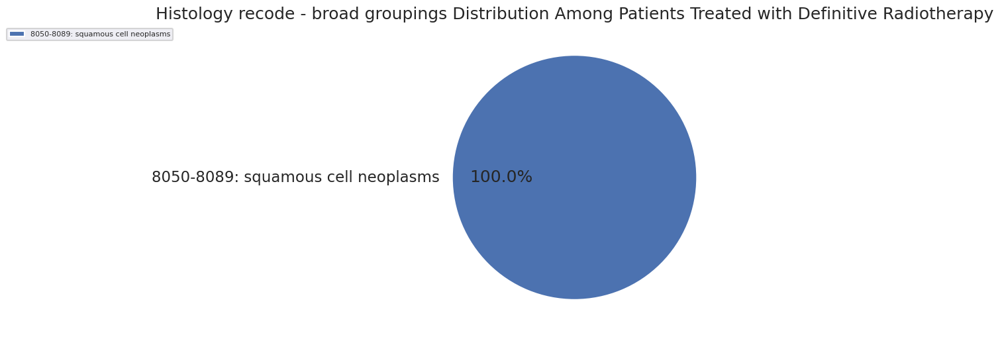

<Figure size 8000x300 with 0 Axes>

In [ ]:
plt.rcParams['font.family'] = 'sans serif'
pie_maker(rad_df, 'Histology recode - broad groupings', title_add=' Among Patients Treated with Definitive Radiotherapy')

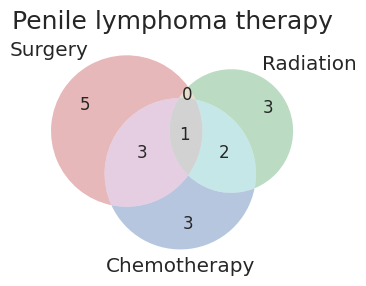

In [ ]:
from matplotlib_venn import venn3

# 1 patients had all 3

# Given No Surgery:::
# 2 patients had no surgery but yes chemo and radiation
# 3 patients had just chemo
# 3 patients had just radiation

# Given Surgery:::
# 5 patients had surgery and nothing else
# 0 patients had just surgery and radiation
# 3 patients had just surgery and chemo

# 3 patients had nothing

font = {
    # 'family' : 'normal',
        'size'   : 12}

plt.rc('font', **font)

venn3(subsets = (5, 3, 0, 3, 3, 2, 1), set_labels = ('Surgery', 'Radiation', 'Chemotherapy'))

plt.title('Penile lymphoma therapy')
plt.show()

In [ ]:
venn_df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] == 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')].shape[0]

72

In [ ]:
plt.rcParams['font.family'] = 'sans serif'


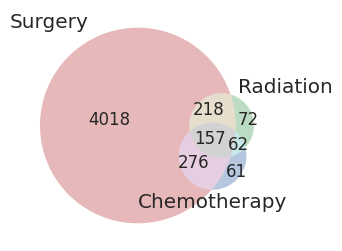

In [ ]:
from matplotlib_venn import venn3

# 7 patients had all 3

# Given No Surgery:::
# 6 patients had no surgery but yes chemo and radiation
# 9 patients had just chemo
# 23 patients had just radiation

# Given Surgery:::
# 279 patients had surgery and nothing else
# 15 patients had just surgery and radiation
# 21 patients had just surgery and chemo

# 187 patients had nothing

# font = {'family' : 'normal',
        # 'size'   : 12}


venn3(subsets = (surg, rad, surg_rad, chemo, surg_chemo, chemo_rad, surg_chemo_rad), set_labels = ('Surgery', 'Radiation', 'Chemotherapy'))


plt.show()

In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Size Summary (20

In [ ]:
received_radiation_dict['Combination of beam with implants or isotopes'] = 'Delivered'

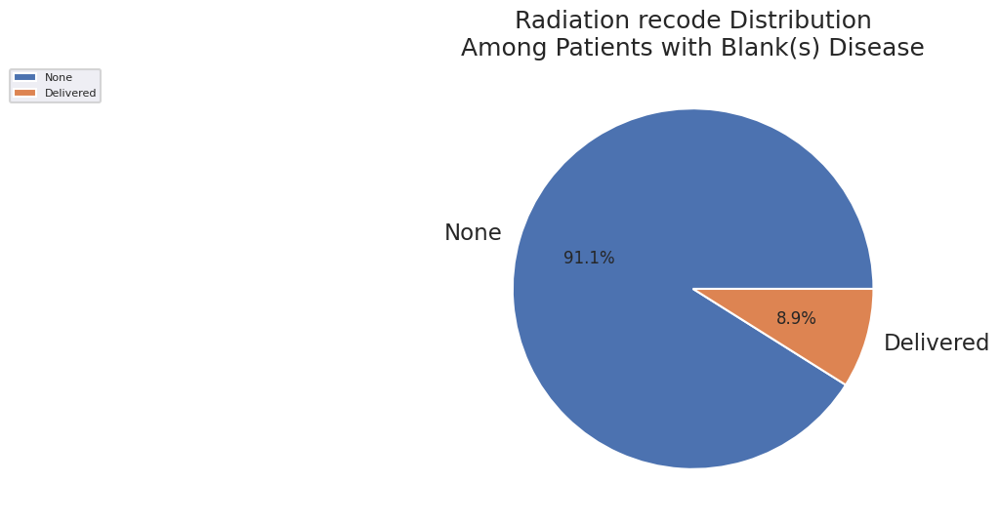

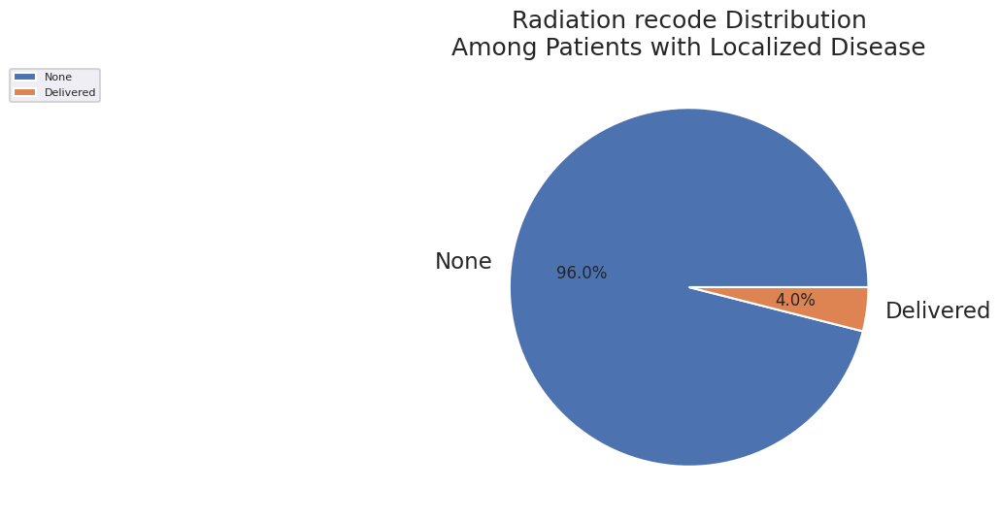

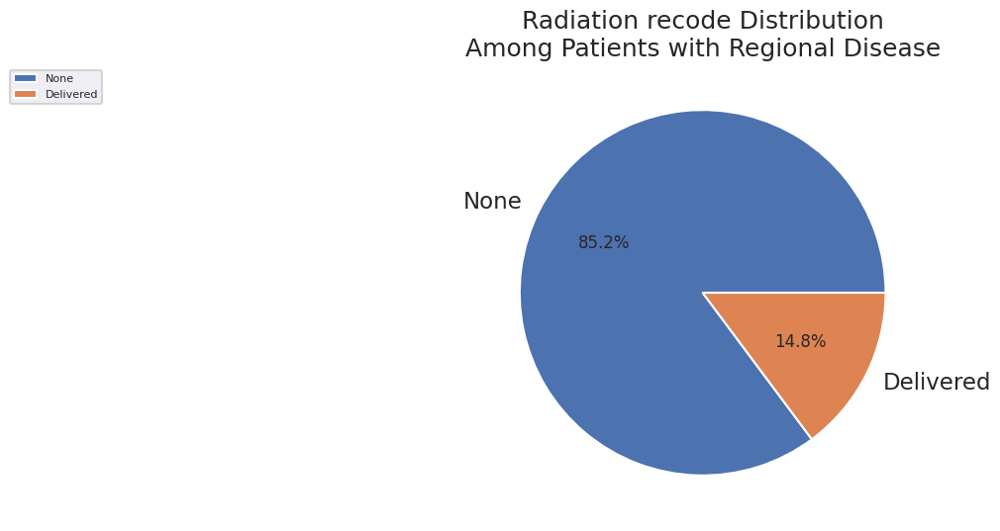

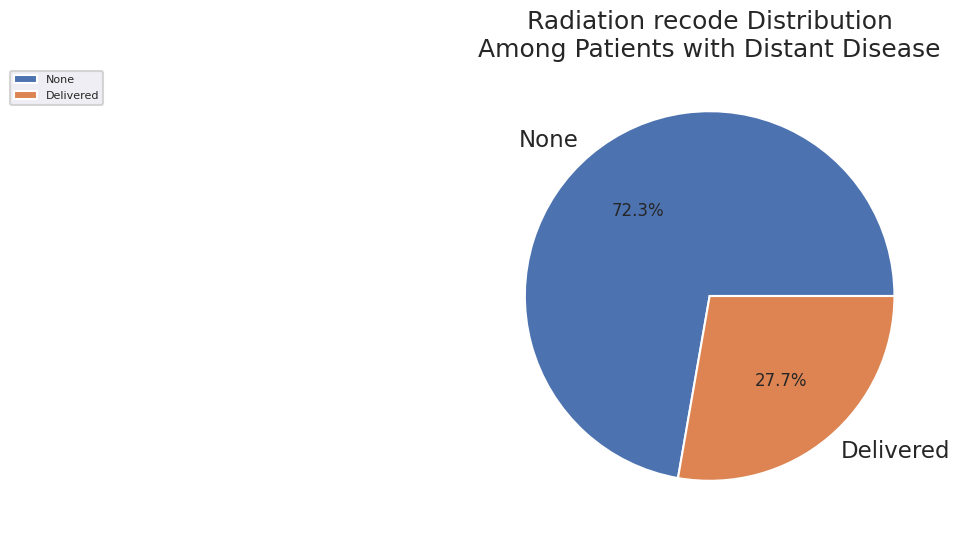

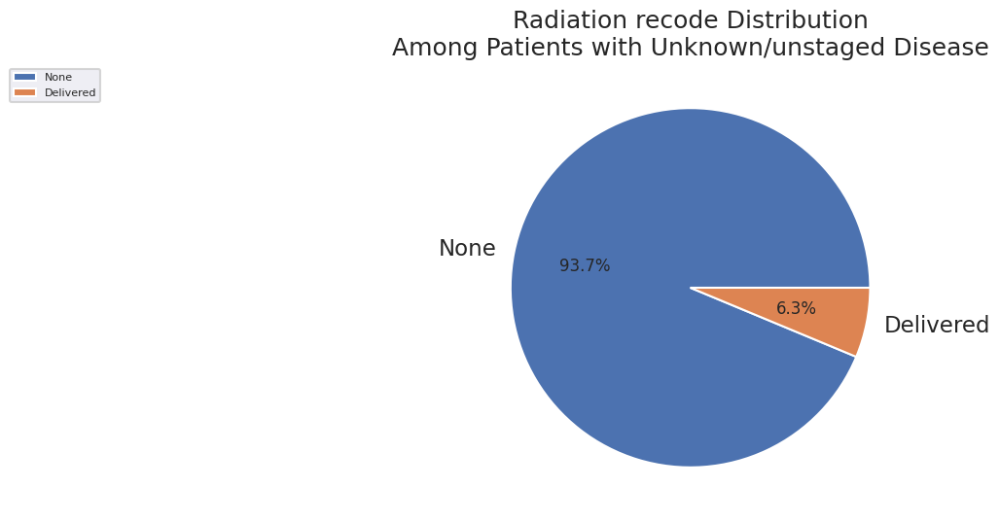

<Figure size 8000x300 with 0 Axes>

In [ ]:
for i in df['Combined Summary Stage (2004+)'].unique():
  pie_maker(df[df['Combined Summary Stage (2004+)'] == i].replace(received_radiation_dict), 'Radiation recode', title_add = str('\nAmong Patients with ') + i + ' Disease')

In [ ]:
venn_df[(venn_df['Surgery Performed'] != 'Surgery') & (venn_df['Radiation'] != 'Radiation') & (venn_df['Chemotherapy'] != 'Chemotherapy')].shape[0]


353

In [ ]:
df.head()

,Survival months,RX Summ--Surg Prim Site (1998+),Age recode with <1 year olds,"Race recode (W, B, AI, API)",Reason no cancer-directed surgery,RX Summ--Scope Reg LN Sur (2003+),First malignant primary indicator,Histologic Type ICD-O-3,Site recode ICD-O-3/WHO 2008,Histology recode - broad groupings,"Year of diagnosis (00-03, 04-18 by 5)",EOD 10 - extent (1988-2003),EOD 10 - nodes (1988-2003),EOD 10 - size (1988-2003),Grade (thru 2017),Grade Clinical (2018+),Grade Pathological (2018+),Radiation recode,"Chemotherapy recode (yes, no/unk)",RX Summ--Systemic/Sur Seq,RX Summ--Surg/Rad Seq,B Symptoms Recode (2010+),SEER Combined Mets at DX-bone (2010+),SEER Combined Mets at DX-brain (2010+),SEER Combined Mets at DX-liver (2010+),SEER Combined Mets at DX-lung (2010+),Mets at DX-Distant LN (2016+),Mets at DX-Other (2016+),Regional nodes examined (1988+),Regional nodes positive (1988+),Tumor Size Summary (2016+),CS tumor size (2004-2015),CS extension (2004-2015),CS mets at dx (2004-2015),CS Tumor Size/Ext Eval (2004-2015),CS Reg Node Eval (2004-2015),CS Mets Eval (2004-2015),SEER cause-specific death classification,SEER other cause of death classification,COD to site rec KM,Survival months flag,SEER registry (with CA and GA as whole states),Sex,Behavior code ICD-O-3,AYA site recode 2020 Revision,Primary Site,Laterality,Diagnostic Confirmation,Combined Summary Stage (2004+),Summary stage 2000 (1998-2017),CEA Pretreatment Interpretation Recode (2010+),Breslow Thickness Recode (2010+),LDH Pretreatment Level Recode (2010+),Number of Examined Pelvic Nodes Recode (2010+),Number of Positive Pelvic Nodes Recode (2010+),Perineural Invasion Recode (2010+),Ulceration Recode (2010+),CS lymph nodes (2004-2015),CS site-specific factor 3 (2004-2017 varying by schema),COD to site recode,Total number of in situ/malignant tumors for patient,Total number of benign/borderline tumors for patient,Marital status at diagnosis,Survival months],Surgery Performed,Radiation,Chemotherapy
0,126,60,65,White,Surgery performed,None,No,8070,Penis,8050-8089: squamous cell neoplasms,2003,30,0,015,Unknown,Blank(s),Blank(s),None/Unknown,No/Unknown,Blank(s),No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Dead (attributable to this cancer dx),Alive or dead due to cancer,Other Cause of Death,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,609,Not a paired site,Positive histology,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Other Cause of Death,3,0,Unknown,126,Surgery,No Radiation,No Chemotherapy
1,116,30,65,White,Surgery performed,None,No,8070,Penis,8050-8089: squamous cell neoplasms,2009,Blank(s),Blank(s),Blank(s),Moderately differentiated; Grade II,Blank(s),Blank(s),None/Unknown,No/Unknown,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),015,350,00,3,0,0,Alive or dead of other cause,Alive or dead due to cancer,Alive,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,602,Not a paired site,Positive histology,Localized,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),000,Blank(s),Alive,2,0,Single (never married),116,Surgery,No Radiation,No Chemotherapy
2,3,40,85,White,Surgery performed,Blank(s),No,8070,Penis,8050-8089: squamous cell neoplasms,2000,30,0,999,Well differentiated; Grade I,Blank(s),Blank(s),None/Unknown,No/Unknown,Blank(s),No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Alive or dead of other cause,Dead (attributable to causes other than this c...,Other Cause of Death,Complete dates are available and there are mor...,Californ

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
kg_df = df[df['Combined Summary Stage (2004+)'] != 'Blank(s)']

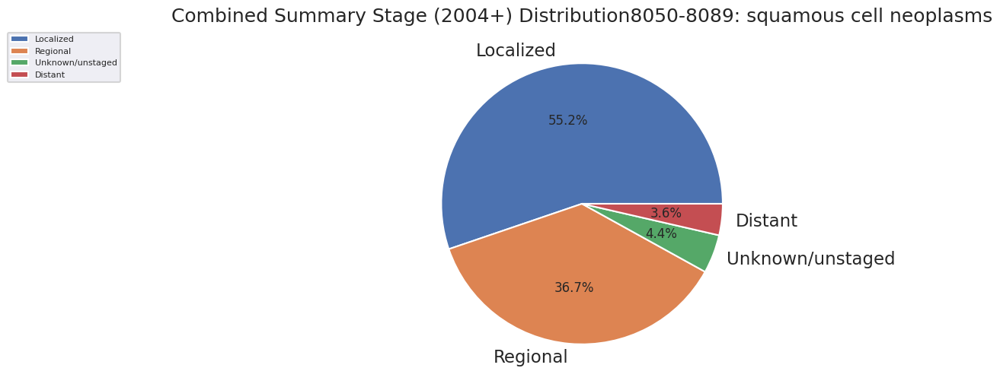

<Figure size 8000x300 with 0 Axes>

In [ ]:
for hist in kg_df['Histology recode - broad groupings'].unique():
  pie_maker(kg_df[kg_df['Histology recode - broad groupings'] == hist], 'Combined Summary Stage (2004+)', title_add=hist)

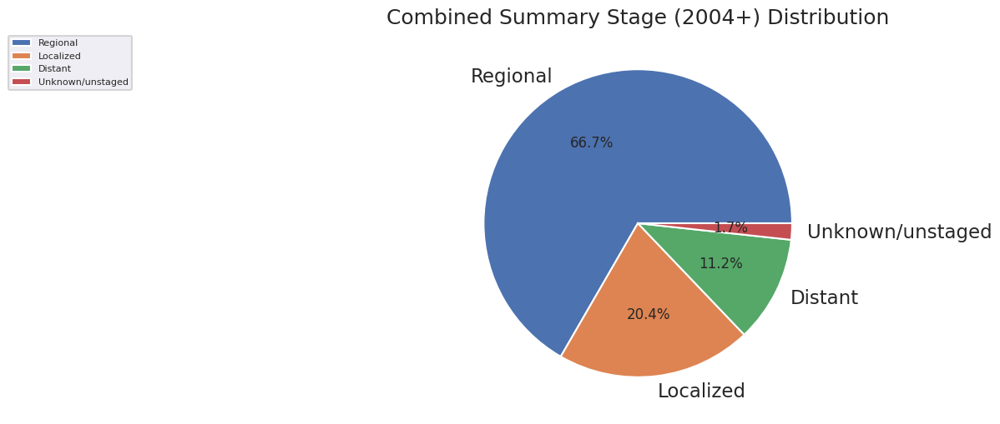

<Figure size 8000x300 with 0 Axes>

In [ ]:
pie_maker(kg_df[
    (~kg_df['RX Summ--Systemic/Sur Seq'].isin(['No systemic therapy and/or surgical procedures', 'Blank(s)']))
     | (~kg_df['RX Summ--Surg/Rad Seq'].isin(['No radiation and/or cancer-directed surgery']))
  ],
   'Combined Summary Stage (2004+)')

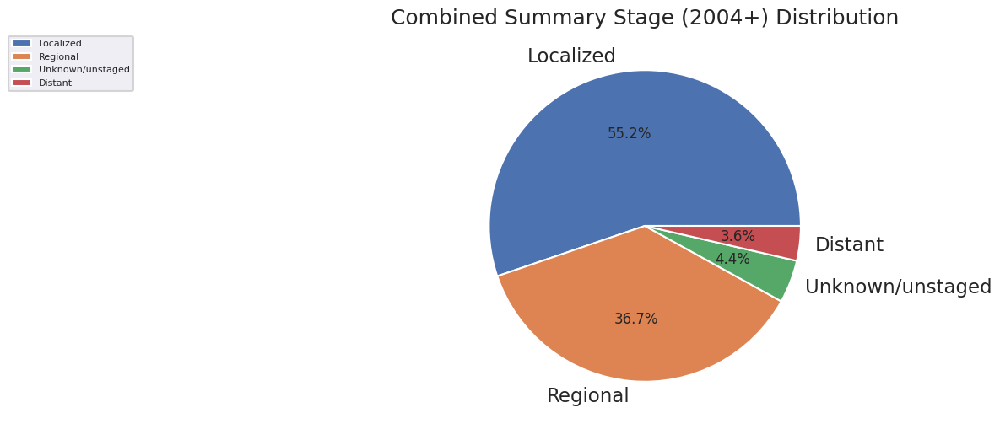

<Figure size 8000x300 with 0 Axes>

In [ ]:
pie_maker(kg_df, 'Combined Summary Stage (2004+)')

In [ ]:
df['RX Summ--Surg/Rad Seq'].value_counts()

No radiation and/or cancer-directed surgery               4852
Radiation after surgery                                    339
Radiation prior to surgery                                  12
Sequence unknown, but both were given                        7
Radiation before and after surgery                           3
Surgery both before and after radiation                      2
Intraoperative rad with other rad before/after surgery       1
Intraoperative radiation                                     1
Name: RX Summ--Surg/Rad Seq, dtype: int64

In [ ]:
df[df['Histology recode - broad groupings'] == '8000-8009: unspecified neoplasms']['Grade Pathological (2018+)'].value_counts()

Series([], Name: Grade Pathological (2018+), dtype: int64)

In [ ]:
df[~df['CS Mets Eval (2004-2015)'].isin(['0', 'Blank(s)', '9'])]

,Survival months,RX Summ--Surg Prim Site (1998+),Age recode with <1 year olds,"Race recode (W, B, AI, API)",Reason no cancer-directed surgery,RX Summ--Scope Reg LN Sur (2003+),First malignant primary indicator,Histologic Type ICD-O-3,Site recode ICD-O-3/WHO 2008,Histology recode - broad groupings,"Year of diagnosis (00-03, 04-18 by 5)",EOD 10 - extent (1988-2003),EOD 10 - nodes (1988-2003),EOD 10 - size (1988-2003),Grade (thru 2017),Grade Clinical (2018+),Grade Pathological (2018+),Radiation recode,"Chemotherapy recode (yes, no/unk)",RX Summ--Systemic/Sur Seq,RX Summ--Surg/Rad Seq,B Symptoms Recode (2010+),SEER Combined Mets at DX-bone (2010+),SEER Combined Mets at DX-brain (2010+),SEER Combined Mets at DX-liver (2010+),SEER Combined Mets at DX-lung (2010+),Mets at DX-Distant LN (2016+),Mets at DX-Other (2016+),Regional nodes examined (1988+),Regional nodes positive (1988+),Tumor Size Summary (2016+),CS tumor size (2004-2015),CS extension (2004-2015),CS mets at dx (2004-2015),CS Tumor Size/Ext Eval (2004-2015),CS Reg Node Eval (2004-2015),CS Mets Eval (2004-2015),SEER cause-specific death classification,SEER other cause of death classification,COD to site rec KM,Survival months flag,SEER registry (with CA and GA as whole states),Sex,Behavior code ICD-O-3,AYA site recode 2020 Revision,Primary Site,Laterality,Diagnostic Confirmation,Combined Summary Stage (2004+),Summary stage 2000 (1998-2017),CEA Pretreatment Interpretation Recode (2010+),Breslow Thickness Recode (2010+),LDH Pretreatment Level Recode (2010+),Number of Examined Pelvic Nodes Recode (2010+),Number of Positive Pelvic Nodes Recode (2010+),Perineural Invasion Recode (2010+),Ulceration Recode (2010+),CS lymph nodes (2004-2015),CS site-specific factor 3 (2004-2017 varying by schema),COD to site recode,Total number of in situ/malignant tumors for patient,Total number of benign/borderline tumors for patient,Marital status at diagnosis,Survival months],Surgery Performed,Radiation,Chemotherapy
74,10,0,65,Black,Not recommended,1 to 3 regional lymph nodes removed,Yes,8070,Penis,8050-8089: squamous cell neoplasms,2005,Blank(s),Blank(s),Blank(s),Poorly differentiated; Grade III,Blank(s),Blank(s),Beam radiation,Yes,Blank(s),Radiation after surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),1,1,Blank(s),999,999,40,1,3,1,Dead (attributable to this cancer dx),Alive or dead due to cancer,Penis,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,609,Not a paired site,Positive histology,Distant,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),300,Blank(s),Penis,1,0,Divorced,10,No Surgery,Radiation,Chemotherapy
222,68,40,85,White,Surgery performed,None,No,8051,Penis,8050-8089: squamous cell neoplasms,2010,Blank(s),Blank(s),Blank(s),Well differentiated; Grade I,Blank(s),Blank(s),None/Unknown,No/Unknown,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),No,No,No,No,Blank(s),Blank(s),0,98,Blank(s),035,350,00,3,1,1,Alive or dead of other cause,Dead (attributable to causes other than this c...,Colon excluding Rectum,Complete dates are available and there are mor...,Connecticut,Male,Malignant,9.7.4 Carcinoma of penis,601,Not a paired site,Positive histology,Localized,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),000,Blank(s),Colon excluding Rectum,6,0,Married (including common law),68,Surgery,No Radiation,No Chemotherapy
225,1,0,85,White,"Not recommended, contraindicated due to other ...",None,No,8070,Penis,8050-8089: squamous cell neoplasms,2012,Blank(s),Blank(s),Blank(s),Moderately differentiated; Grade II,Blank(s),Blank(s),None/Unknown,Yes,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),No,No,Yes,Yes,Blank(s),Blank(s),0,98,Blank(s),999,460,40,1,0,1,Dead (attributable to this cancer dx),Alive or dead due to cancer,Miscellaneous Malignant Cancer,Complete dates are available 

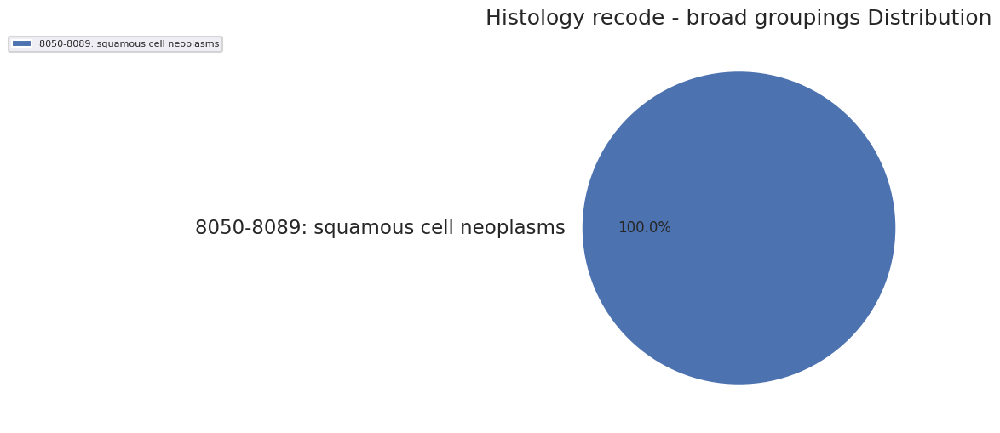

<Figure size 8000x300 with 0 Axes>

In [ ]:
# histogram_maker(
pie_maker(df[(df['Radiation'] == 'Radiation') & (df['Chemotherapy'] != 'Chemotherapy') & (df['Surgery Performed'] != 'Surgery')], 'Histology recode - broad groupings')

In [ ]:
df[
        (df['Radiation'] == 'Radiation') & (df['Chemotherapy'] == 'No Chemotherapy') & (df['Surgery Performed'] == 'No Surgery')
      ].head()

,Survival months,RX Summ--Surg Prim Site (1998+),Age recode with <1 year olds,"Race recode (W, B, AI, API)",Reason no cancer-directed surgery,RX Summ--Scope Reg LN Sur (2003+),First malignant primary indicator,Histologic Type ICD-O-3,Site recode ICD-O-3/WHO 2008,Histology recode - broad groupings,"Year of diagnosis (00-03, 04-18 by 5)",EOD 10 - extent (1988-2003),EOD 10 - nodes (1988-2003),EOD 10 - size (1988-2003),Grade (thru 2017),Grade Clinical (2018+),Grade Pathological (2018+),Radiation recode,"Chemotherapy recode (yes, no/unk)",RX Summ--Systemic/Sur Seq,RX Summ--Surg/Rad Seq,B Symptoms Recode (2010+),SEER Combined Mets at DX-bone (2010+),SEER Combined Mets at DX-brain (2010+),SEER Combined Mets at DX-liver (2010+),SEER Combined Mets at DX-lung (2010+),Mets at DX-Distant LN (2016+),Mets at DX-Other (2016+),Regional nodes examined (1988+),Regional nodes positive (1988+),Tumor Size Summary (2016+),CS tumor size (2004-2015),CS extension (2004-2015),CS mets at dx (2004-2015),CS Tumor Size/Ext Eval (2004-2015),CS Reg Node Eval (2004-2015),CS Mets Eval (2004-2015),SEER cause-specific death classification,SEER other cause of death classification,COD to site rec KM,Survival months flag,SEER registry (with CA and GA as whole states),Sex,Behavior code ICD-O-3,AYA site recode 2020 Revision,Primary Site,Laterality,Diagnostic Confirmation,Combined Summary Stage (2004+),Summary stage 2000 (1998-2017),CEA Pretreatment Interpretation Recode (2010+),Breslow Thickness Recode (2010+),LDH Pretreatment Level Recode (2010+),Number of Examined Pelvic Nodes Recode (2010+),Number of Positive Pelvic Nodes Recode (2010+),Perineural Invasion Recode (2010+),Ulceration Recode (2010+),CS lymph nodes (2004-2015),CS site-specific factor 3 (2004-2017 varying by schema),COD to site recode,Total number of in situ/malignant tumors for patient,Total number of benign/borderline tumors for patient,Marital status at diagnosis,Survival months],Surgery Performed,Radiation,Chemotherapy
19,42,0,75,White,Not recommended,Blank(s),No,8070,Penis,8050-8089: squamous cell neoplasms,2002,10,1,070,Moderately differentiated; Grade II,Blank(s),Blank(s),Beam radiation,No/Unknown,Blank(s),No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),1,1,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Alive or dead of other cause,Dead (attributable to causes other than this c...,Colon excluding Rectum,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,609,Not a paired site,Positive histology,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Colon excluding Rectum,3,0,Divorced,42,No Surgery,Radiation,No Chemotherapy
99,32,0,70,Black,"Recommended but not performed, patient refused",None,No,8070,Penis,8050-8089: squamous cell neoplasms,2015,Blank(s),Blank(s),Blank(s),Well differentiated; Grade I,Blank(s),Blank(s),Beam radiation,No/Unknown,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),No,No,No,No,Blank(s),Blank(s),0,98,Blank(s),058,350,00,1,0,0,Dead (attributable to this cancer dx),Alive or dead due to cancer,Penis,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,609,Not a paired site,Positive histology,Localized,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),000,Blank(s),Penis,3,0,Single (never married),32,No Surgery,Radiation,No Chemotherapy
181,43,0,65,White,Not recommended,None,Yes,8070,Penis,8050-8089: squamous cell neoplasms,2015,Blank(s),Blank(s),Blank(s),Moderately differentiated; Grade II,Blank(s),Blank(s),Beam radiation,No/Unknown,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),No,No,No,No,Blank(s),Blank(s),0,98,Blank(s),020,300,00,1,0,0,Alive or dead of other cause,Alive or dead due to cancer,Alive,Complete dates are available and there

In [ ]:
lymphomas_df.shape

(0, 65)

In [ ]:
# simple_single_grouped_KM_wrapper('Radiation', df=lymphomas_df[(lymphomas_df['Surgery Performed'] == 'No Surgery') & (lymphomas_df['Chemotherapy'] == 'No Chemotherapy')])

In [ ]:
simple_single_grouped_KM_wrapper('Chemotherapy recode (yes, no/unk)', df=lymphomas_df)

Aborting... empty array.


<Figure size 800x600 with 0 Axes>

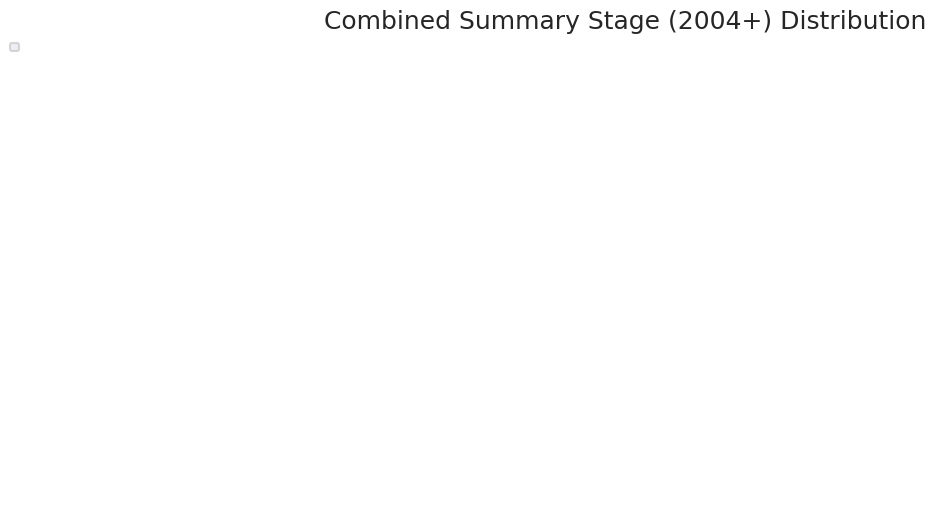

<Figure size 8000x300 with 0 Axes>

In [ ]:
pie_maker(lymphomas_df, 'Combined Summary Stage (2004+)')

In [ ]:
df_known = df[df['Survival months'] != 'Unknown']

In [ ]:
df_70 = df_known.replace(marriage_replace_dict)
for i in df_70['Marital status at diagnosis'].unique():
  print('\nValue ', i)
  print('5 year survival =', (pd.to_numeric(df_70[df_70['Marital status at diagnosis'] == i]['Survival months']) > 5).mean())
  print('10 year survival =', (pd.to_numeric(df_70[df_70['Marital status at diagnosis'] == i]['Survival months']) > 10).mean())
  print(pd.to_numeric(df_70[df_70['Marital status at diagnosis'] == i]['Survival months']).describe())

# simple_single_grouped_KM_wrapper('Age recode with <1 year olds', age_recode_dict_70)


Value  Unknown
5 year survival = 0.8565022421524664
10 year survival = 0.8071748878923767
count    446.000000
mean      55.284753
std       52.455799
min        0.000000
25%       15.000000
50%       38.000000
75%       83.750000
max      224.000000
Name: Survival months, dtype: float64

Value  Unmarried
5 year survival = 0.8343685300207039
10 year survival = 0.7287784679089027
count    1932.000000
mean       48.962733
std        52.601348
min         0.000000
25%        10.000000
50%        28.000000
75%        71.000000
max       227.000000
Name: Survival months, dtype: float64

Value  Married (including common law)
5 year survival = 0.8844663613948573
10 year survival = 0.7770341669601972
count    2839.000000
mean       58.822120
std        56.683751
min         0.000000
25%        12.000000
50%        38.000000
75%        94.000000
max       227.000000
Name: Survival months, dtype: float64


In [ ]:
df_70 = df_known.replace(reason_no_surg_dict)
for i in df_70['Reason no cancer-directed surgery'].unique():
  print('Value ', i)
  print('5 year survival =', (pd.to_numeric(df_70[df_70['Reason no cancer-directed surgery'] == i]['Survival months']) > 5).mean())
  print('10 year survival =', (pd.to_numeric(df_70[df_70['Reason no cancer-directed surgery'] == i]['Survival months']) > 10).mean())
  print(pd.to_numeric(df_70[df_70['Reason no cancer-directed surgery'] == i]['Survival months']).describe())

# simple_single_grouped_KM_wrapper('Age recode with <1 year olds', age_recode_dict_70)

Value  Surgery performed
5 year survival = 0.8873420432640823
10 year survival = 0.7862497322767188
count    4669.000000
mean       57.156565
std        55.396484
min         0.000000
25%        13.000000
50%        37.000000
75%        89.000000
max       227.000000
Name: Survival months, dtype: float64
Value  No surgery
5 year survival = 0.6605839416058394
10 year survival = 0.5529197080291971
count    548.000000
mean      35.374088
std       47.614009
min        0.000000
25%        3.000000
50%       14.000000
75%       48.250000
max      225.000000
Name: Survival months, dtype: float64


Value  65
5 year survival = 0.38461538461538464
10 year survival = 0.16124260355029585
count    676.000000
mean      59.869822
std       55.771924
min        0.000000
25%       14.000000
50%       41.000000
75%       92.000000
max      227.000000
Name: Survival months, dtype: float64
Value  85
5 year survival = 0.12
10 year survival = 0.016363636363636365
count    550.000000
mean      26.872727
std       28.982913
min        0.000000
25%        7.000000
50%       17.000000
75%       38.000000
max      169.000000
Name: Survival months, dtype: float64
Value  80
5 year survival = 0.21584158415841584
10 year survival = 0.047524752475247525
count    505.000000
mean      36.770297
std       38.856353
min        0.000000
25%        7.000000
50%       23.000000
75%       53.000000
max      192.000000
Name: Survival months, dtype: float64
Value  75
5 year survival = 0.3146417445482866
10 year survival = 0.1043613707165109
count    642.000000
mean      48.919003
std       47.704103
min        0.

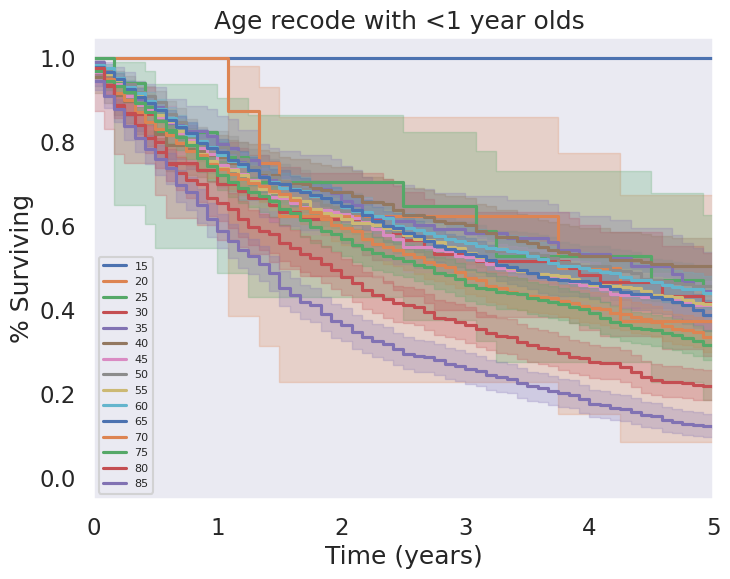

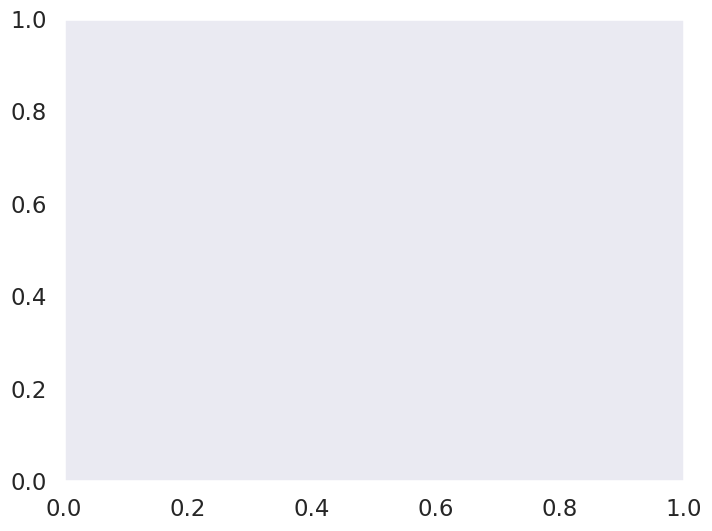

In [ ]:
df_70 = df_known.replace(age_recode_dict_70)
for i in df_70['Age recode with <1 year olds'].unique():
  print('Value ', i)
  print('5 year survival =', (pd.to_numeric(df_70[df_70['Age recode with <1 year olds'] == i]['Survival months']) > 60).mean())
  print('10 year survival =', (pd.to_numeric(df_70[df_70['Age recode with <1 year olds'] == i]['Survival months']) > 120).mean())
  print(pd.to_numeric(df_70[df_70['Age recode with <1 year olds'] == i]['Survival months']).describe())

simple_single_grouped_KM_wrapper('Age recode with <1 year olds', age_recode_dict_70)

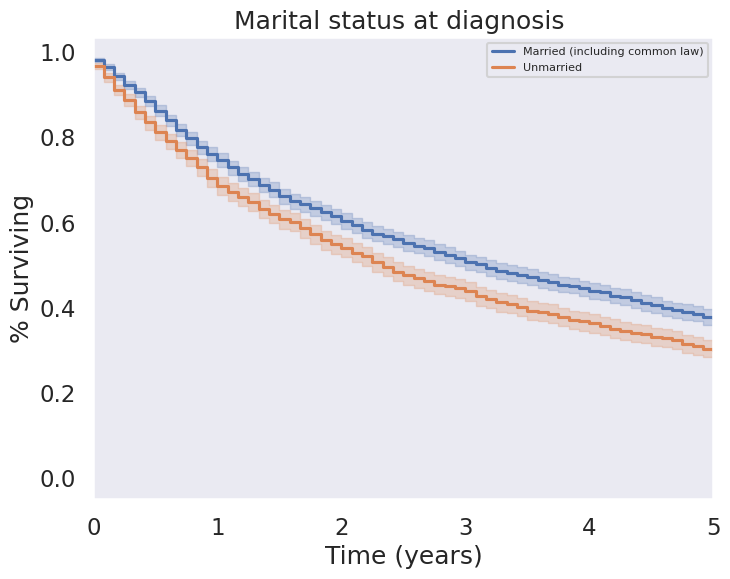

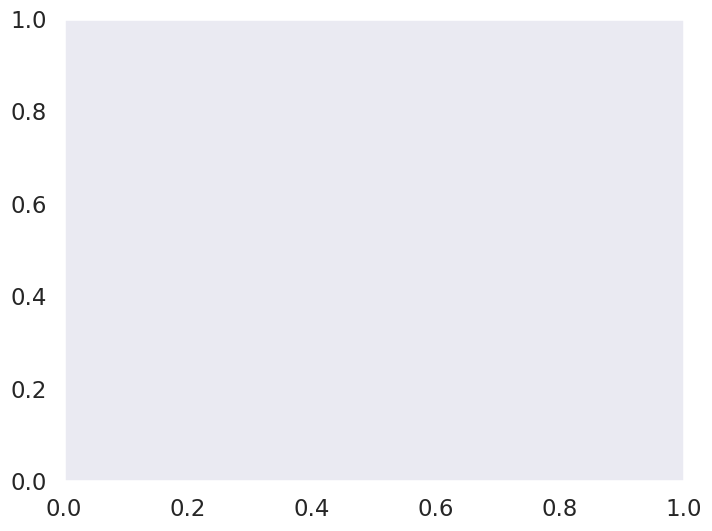

In [ ]:
simple_single_grouped_KM_wrapper('Marital status at diagnosis', marriage_replace_dict, df=df[df['Marital status at diagnosis'] != 'Unknown'])

In [ ]:
df['RX Summ--Scope Reg LN Sur (2003+)'].value_counts()

None                                                          3507
4 or more regional lymph nodes removed                         681
Blank(s)                                                       666
1 to 3 regional lymph nodes removed                            126
Biopsy or aspiration of regional lymph node, NOS                95
Unknown or not applicable                                       68
Number of regional lymph nodes removed unknown                  40
Sentinel lymph node biopsy                                      14
Sentinel node biopsy and lym nd removed same/unstated time      10
Sentinel node biopsy and lym nd removed different times         10
Name: RX Summ--Scope Reg LN Sur (2003+), dtype: int64

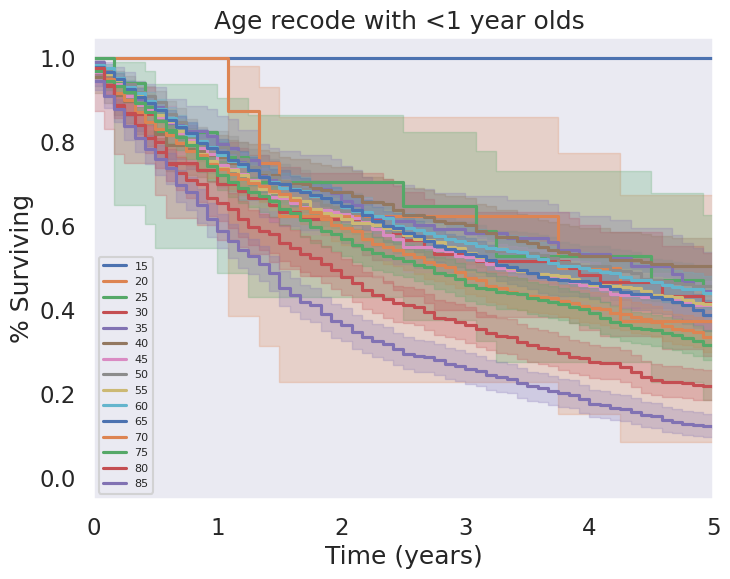

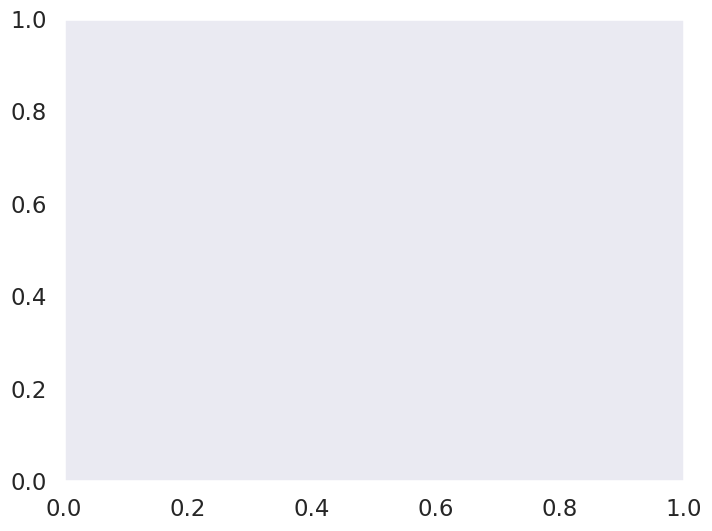

In [ ]:
simple_single_grouped_KM_wrapper('Age recode with <1 year olds', age_recode_dict)

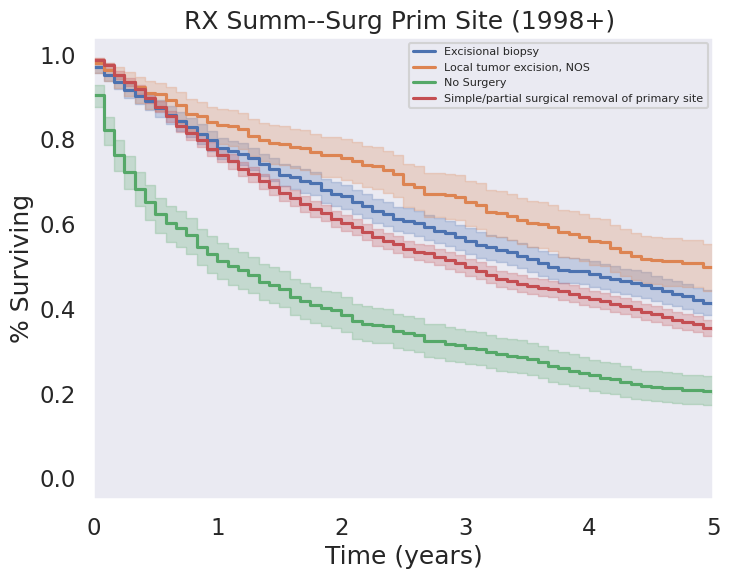

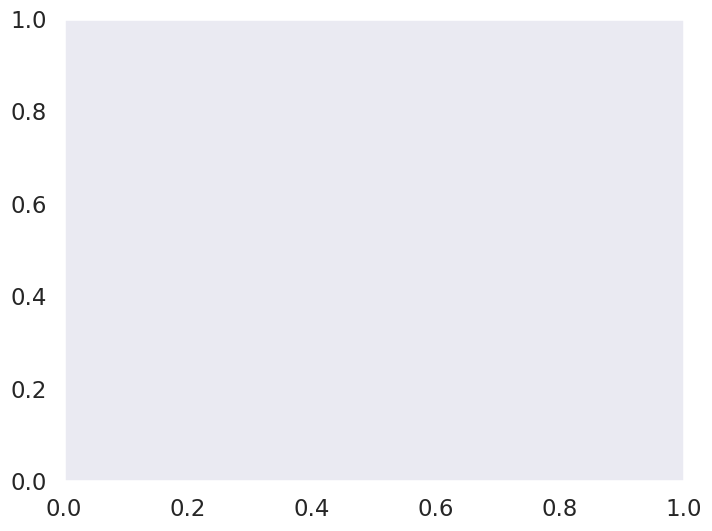

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Surg Prim Site (1998+)', penis_surg_replace_dict_simple, df=df[((df['RX Summ--Surg Prim Site (1998+)'] < 35) & (df['RX Summ--Surg Prim Site (1998+)'] > 14)) | (df['RX Summ--Surg Prim Site (1998+)'] == 0)])

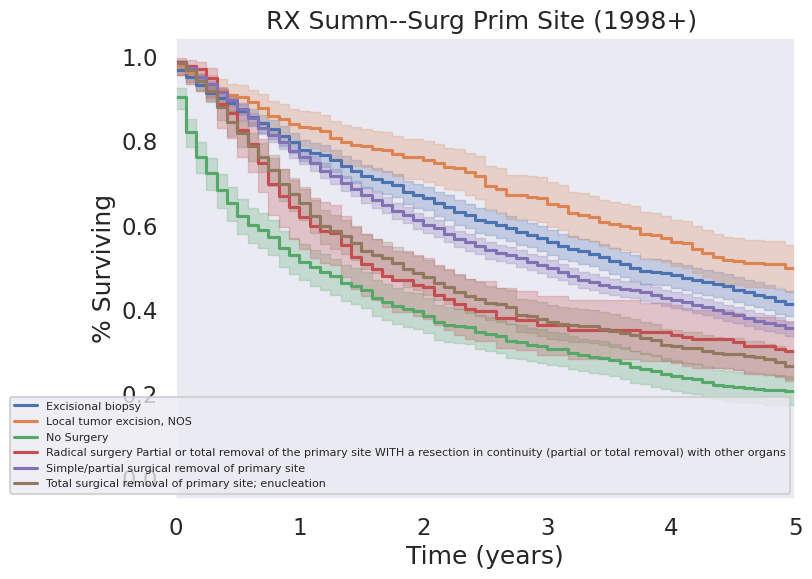

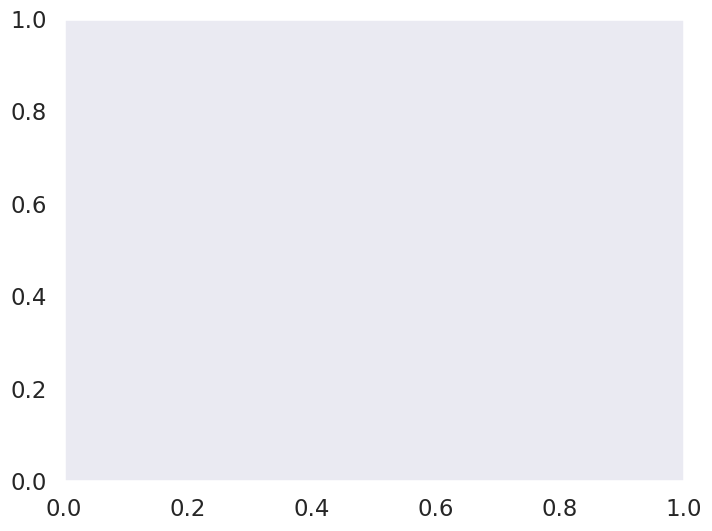

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Surg Prim Site (1998+)', penis_surg_replace_dict_simple, df=
                                 df[
                                    (
                                      (df['RX Summ--Surg Prim Site (1998+)'] > 14) &
                                      (~df['RX Summ--Surg Prim Site (1998+)'].isin([99, 50, 90]))
                                    ) | (df['RX Summ--Surg Prim Site (1998+)'] == 0)])



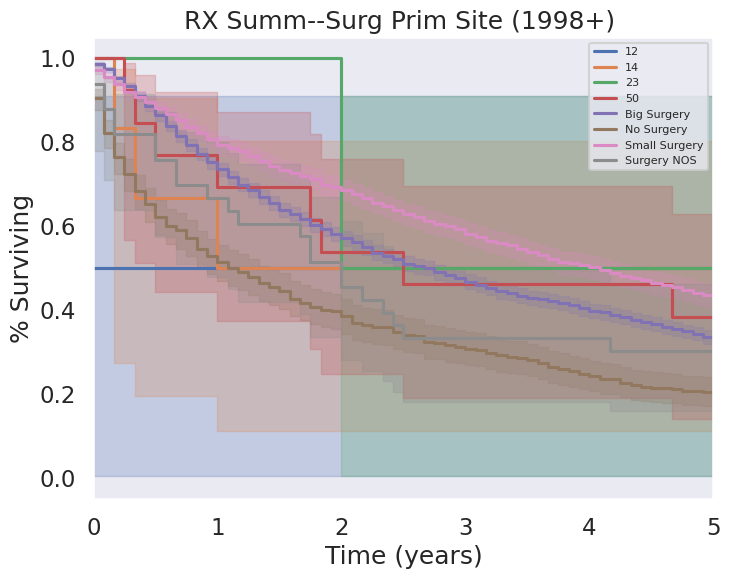

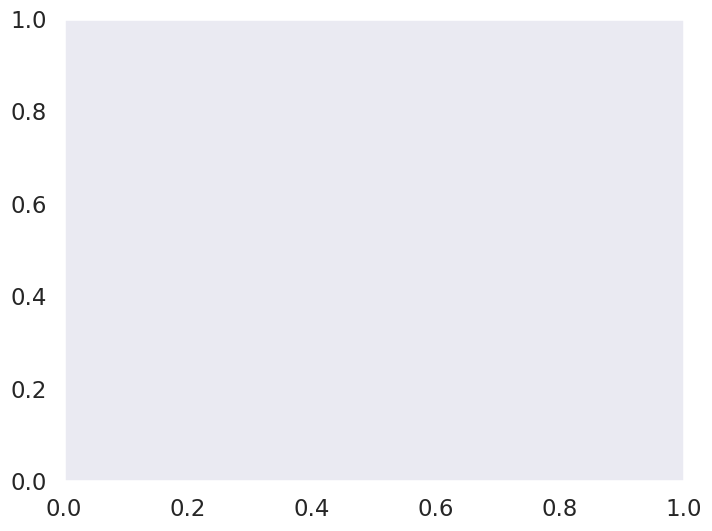

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Surg Prim Site (1998+)', surg_replace_dict, df=df[df['RX Summ--Surg Prim Site (1998+)'] != 99])

In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Size Summary (20

BASELINE:


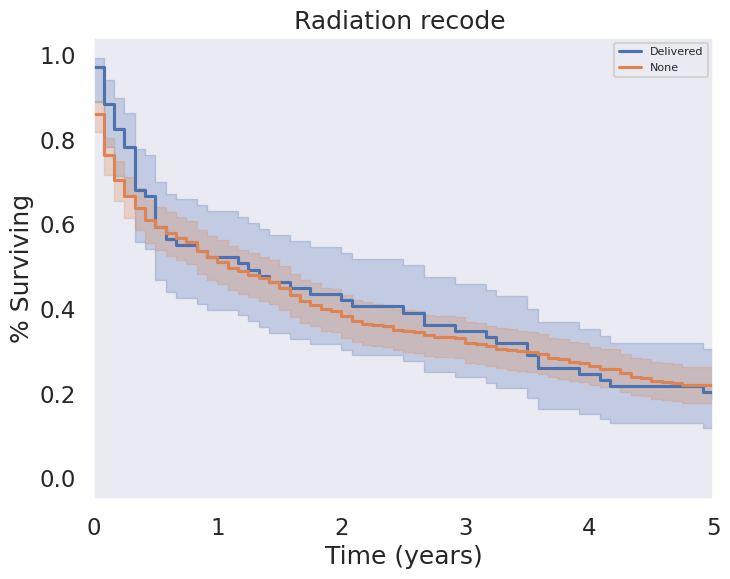

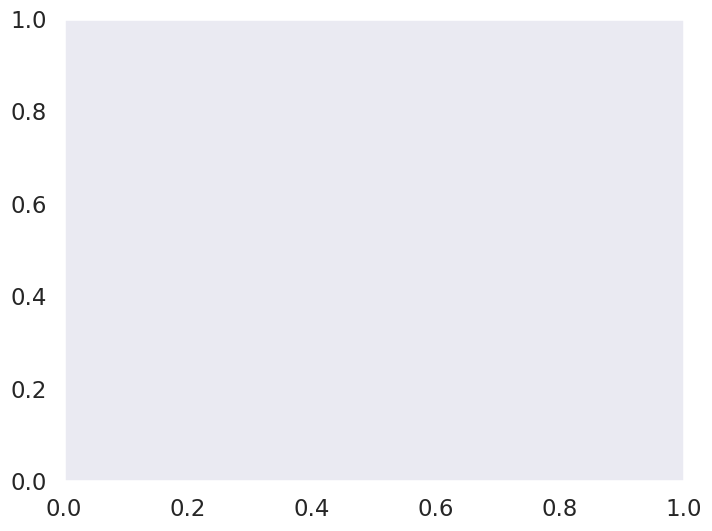

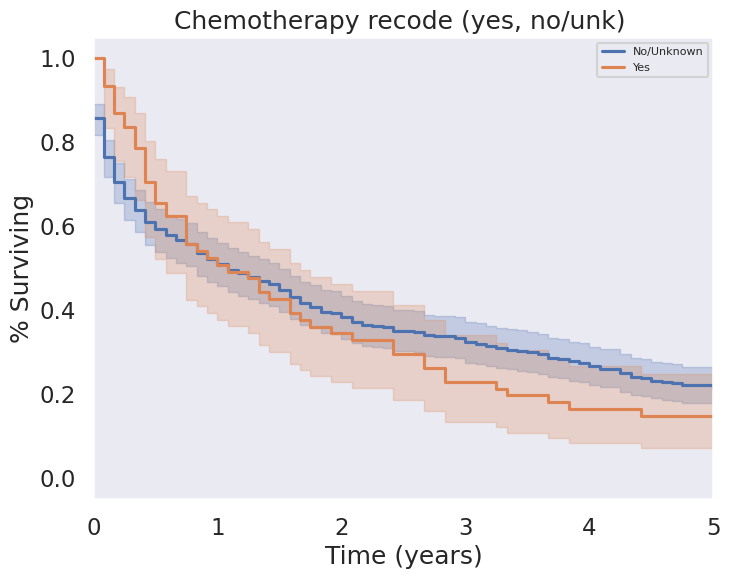

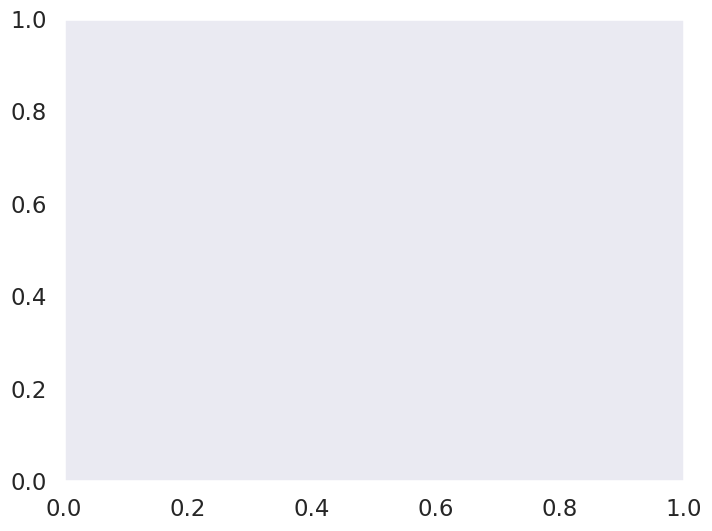

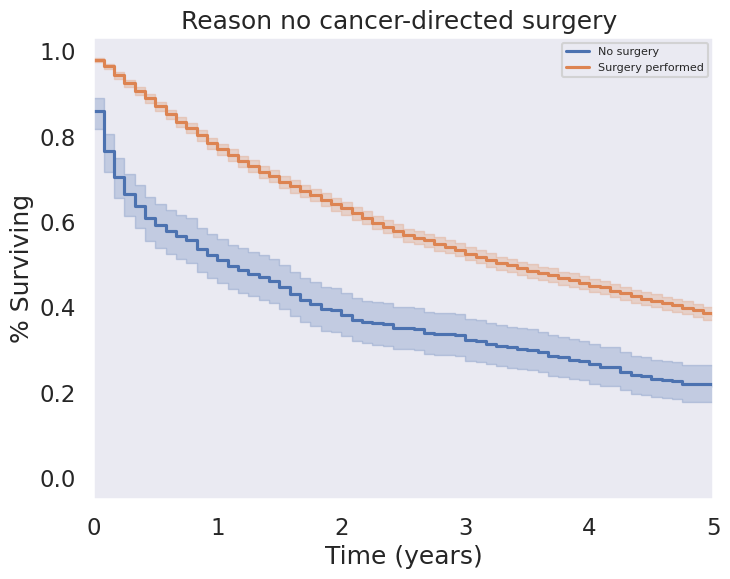

Just to explain: this answers the question 'does receiving chemo change the positive effect of surgery on survival?'


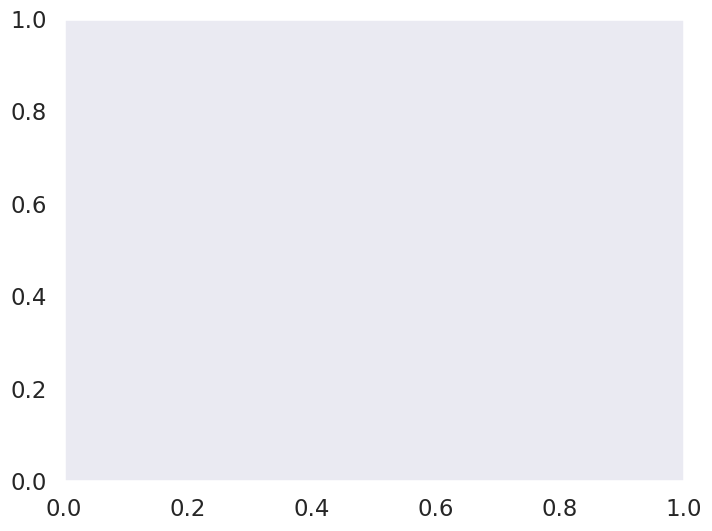

In [ ]:
# simple_single_grouped_KM_wrapper('Race recode (W, B, AI, API)', df=df.loc[df['Reason no cancer-directed surgery'] == 'Surgery performed'], title_add='among patients who received surgery')
# simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', reason_no_surg_dict, df=df.loc[df['Chemotherapy recode (yes, no/unk)'] == 'Yes'], title_add='among patients who received chemo')
print('BASELINE:')
ax_km = simple_single_grouped_KM_wrapper('Radiation recode', received_radiation_dict, df=df.loc[(df['Chemotherapy recode (yes, no/unk)'] == 'No/Unknown') & (df['Reason no cancer-directed surgery'] != 'Surgery performed')])
ax_km = simple_single_grouped_KM_wrapper('Chemotherapy recode (yes, no/unk)', df=df.loc[(df['Radiation recode'] == 'None/Unknown') & (df['Reason no cancer-directed surgery'] != 'Surgery performed')], ax=ax_km)
ax_km = simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', reason_no_surg_dict, df=df.loc[(df['Radiation recode'] == 'None/Unknown') & (df['Chemotherapy recode (yes, no/unk)'] == 'No/Unknown')], ax=ax_km)
# simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', reason_no_surg_dict, df=df.loc[df['Chemotherapy recode (yes, no/unk)'] == 'No/Unknown'], title_add='among patients who did not get chemo')
print("Just to explain: this answers the question 'does receiving chemo change the positive effect of surgery on survival?'")


In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Size Summary (20

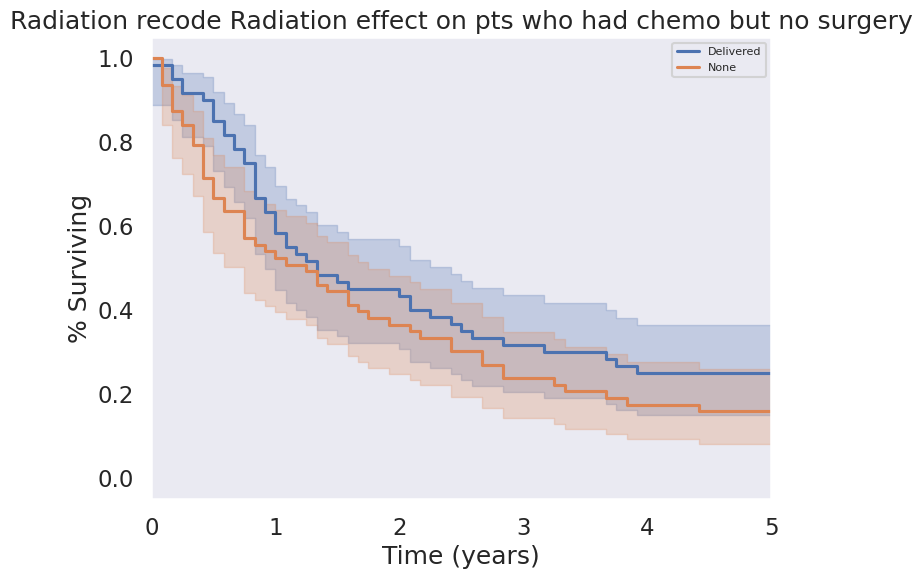

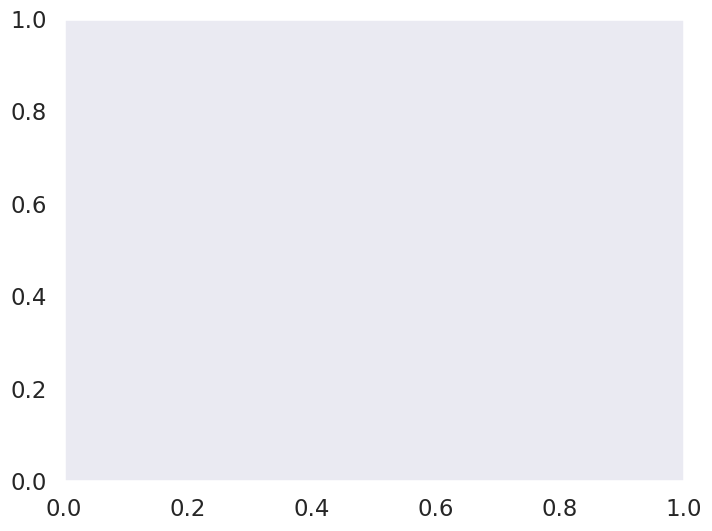

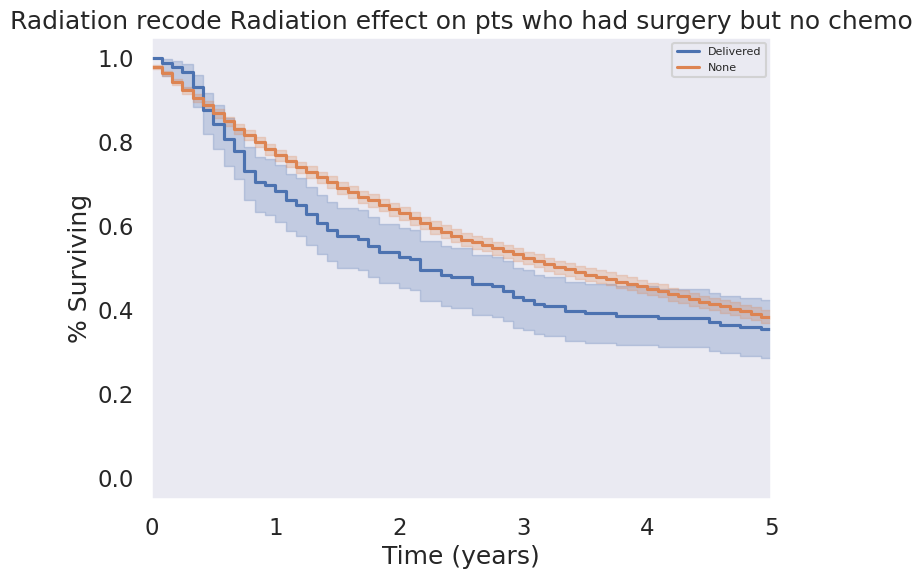

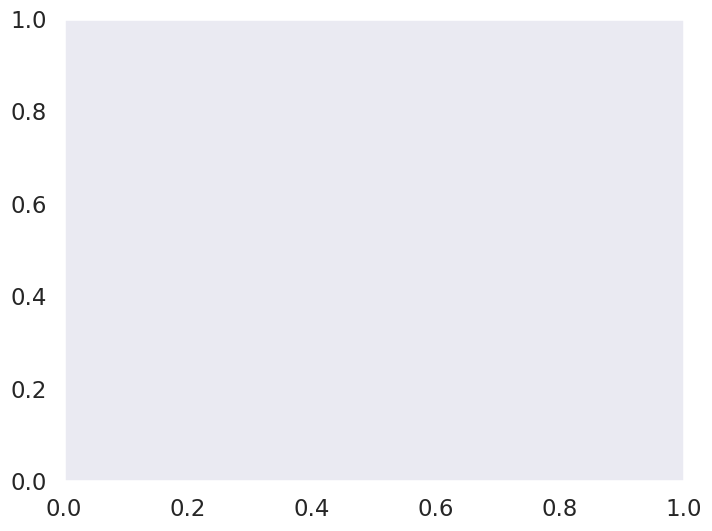

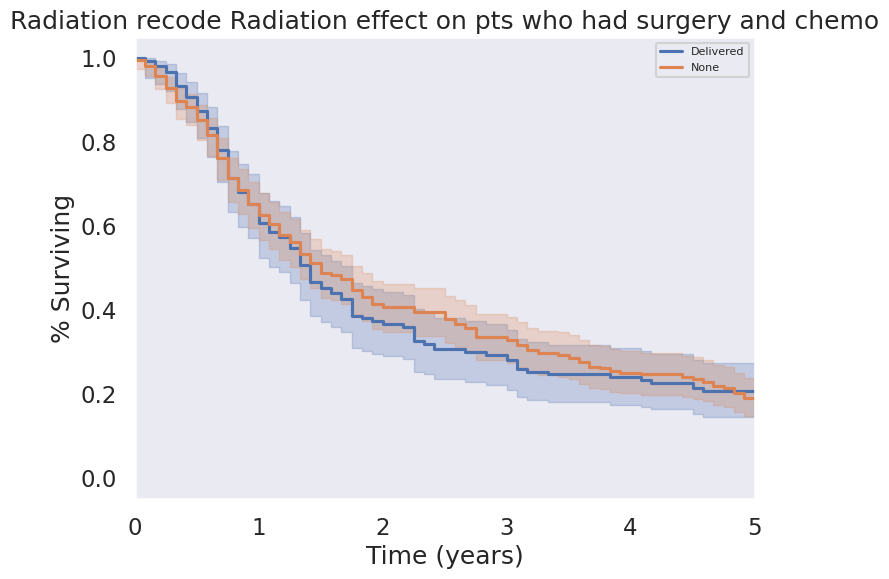

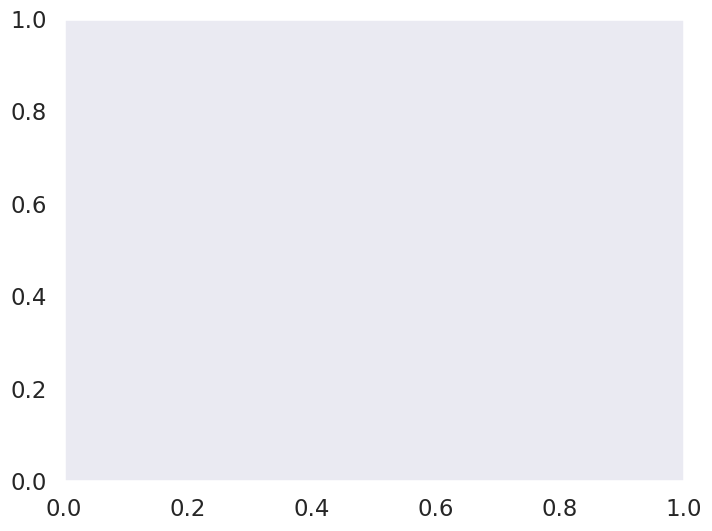

In [ ]:
simple_single_grouped_KM_wrapper('Radiation recode', received_radiation_dict, df=df.loc[(df['Chemotherapy recode (yes, no/unk)'] == 'Yes') & (df['Reason no cancer-directed surgery'] != 'Surgery performed')], title_add='Radiation effect on pts who had chemo but no surgery')
simple_single_grouped_KM_wrapper('Radiation recode', received_radiation_dict, df=df.loc[(df['Chemotherapy recode (yes, no/unk)'] == 'No/Unknown') & (df['Reason no cancer-directed surgery'] == 'Surgery performed')], title_add='Radiation effect on pts who had surgery but no chemo')
simple_single_grouped_KM_wrapper('Radiation recode', received_radiation_dict, df=df.loc[(df['Chemotherapy recode (yes, no/unk)'] == 'Yes') & (df['Reason no cancer-directed surgery'] == 'Surgery performed')], title_add='Radiation effect on pts who had surgery and chemo')



In [ ]:
df.columns

Index(['Survival months', 'RX Summ--Surg Prim Site (1998+)', 'Age recode with <1 year olds', 'Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'RX Summ--Scope Reg LN Sur (2003+)', 'First malignant primary indicator', 'Histologic Type ICD-O-3', 'Site recode ICD-O-3/WHO 2008', 'Histology recode - broad groupings', 'Year of diagnosis (00-03, 04-18 by 5)', 'EOD 10 - extent (1988-2003)', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - size (1988-2003)', 'Grade (thru 2017)', 'Grade Clinical (2018+)', 'Grade Pathological (2018+)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Systemic/Sur Seq', 'RX Summ--Surg/Rad Seq', 'B Symptoms Recode (2010+)', 'SEER Combined Mets at DX-bone (2010+)', 'SEER Combined Mets at DX-brain (2010+)', 'SEER Combined Mets at DX-liver (2010+)', 'SEER Combined Mets at DX-lung (2010+)', 'Mets at DX-Distant LN (2016+)', 'Mets at DX-Other (2016+)', 'Regional nodes examined (1988+)', 'Regional nodes positive (1988+)', 'Tumor Size Summary (20

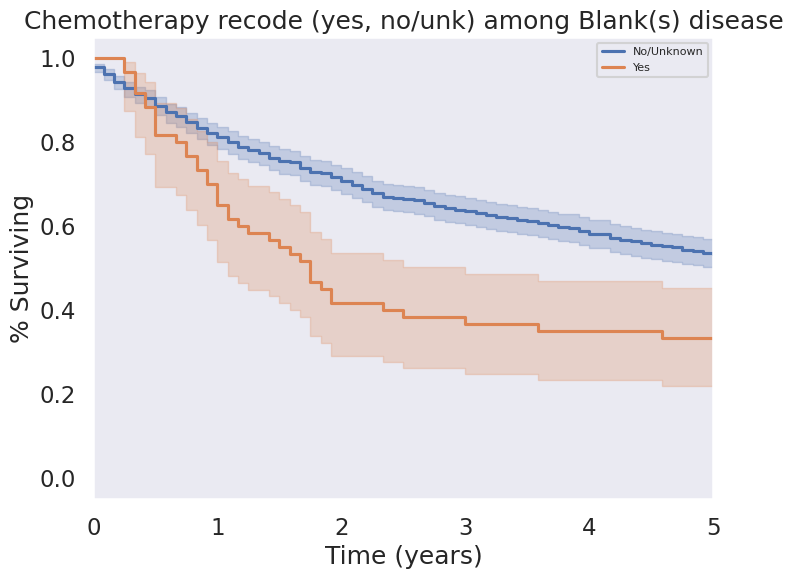

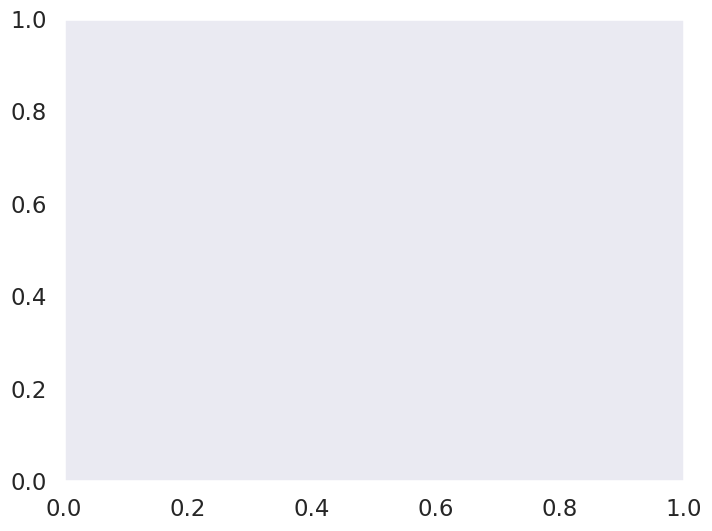

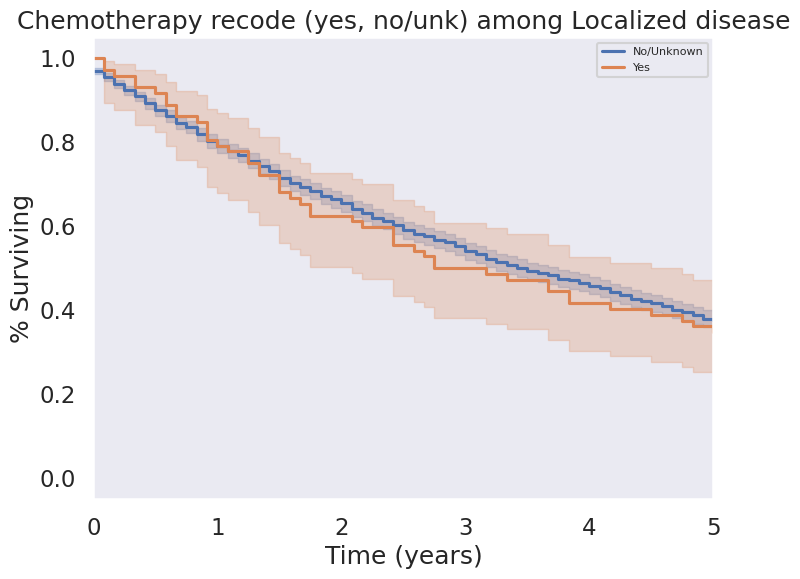

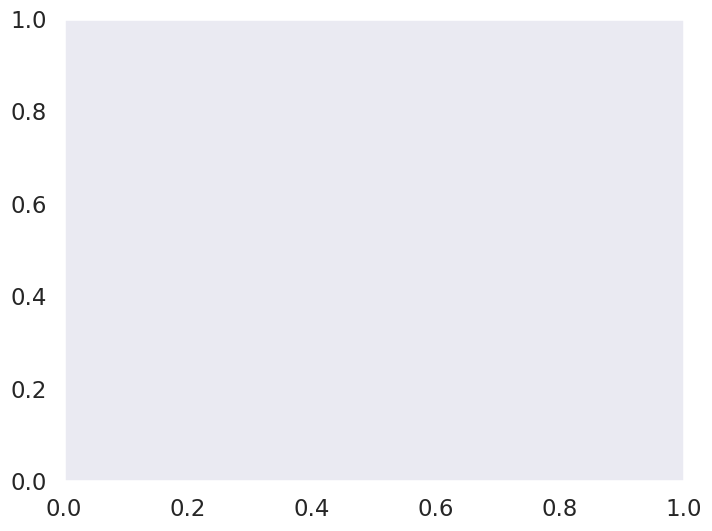

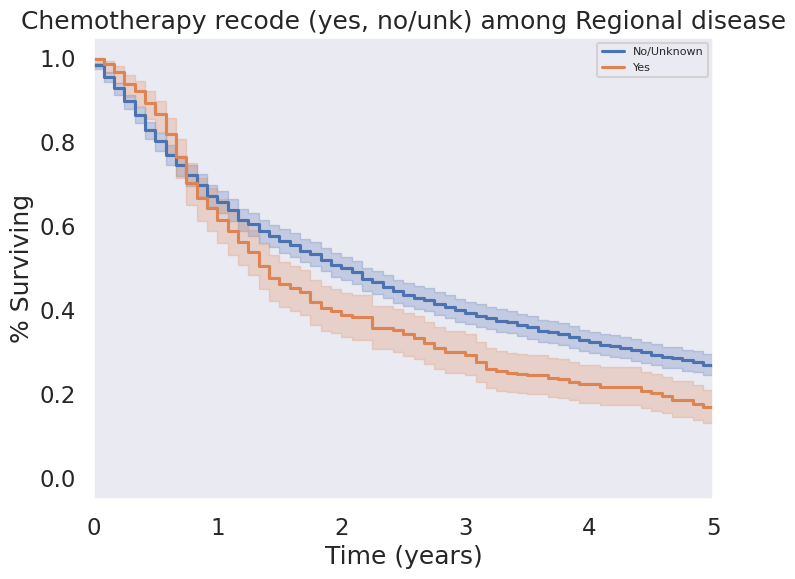

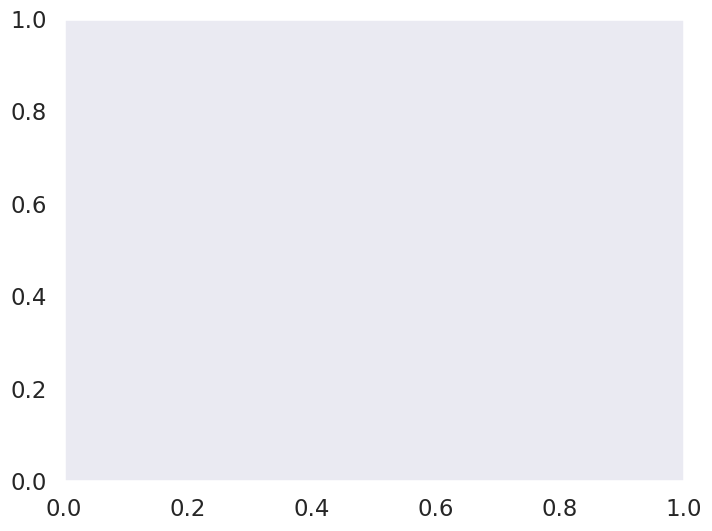

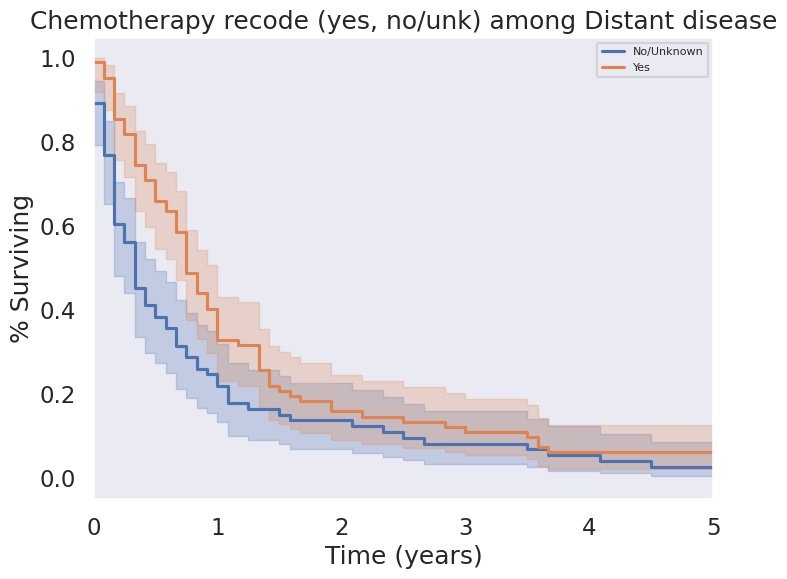

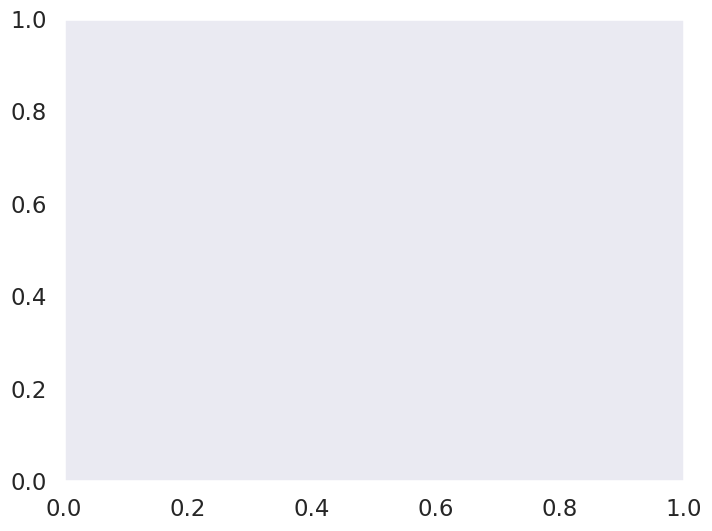

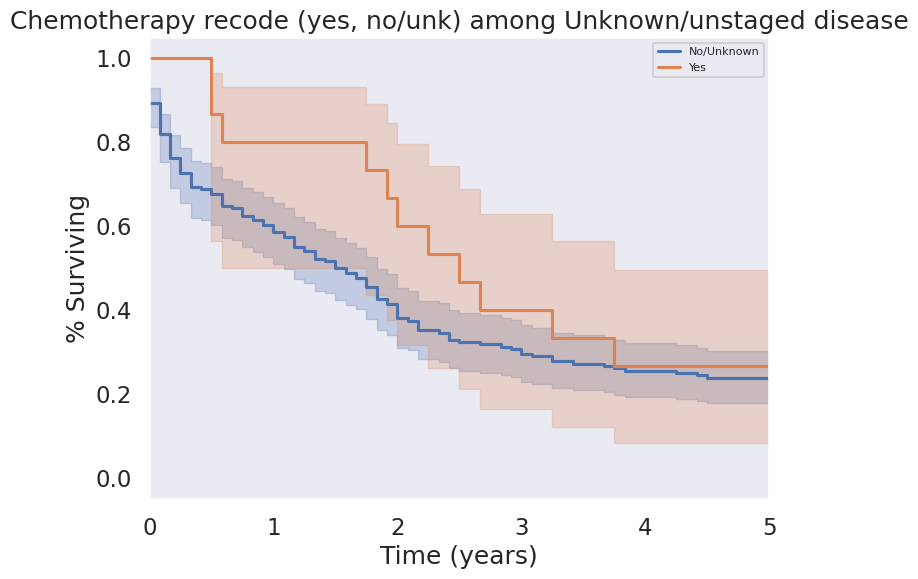

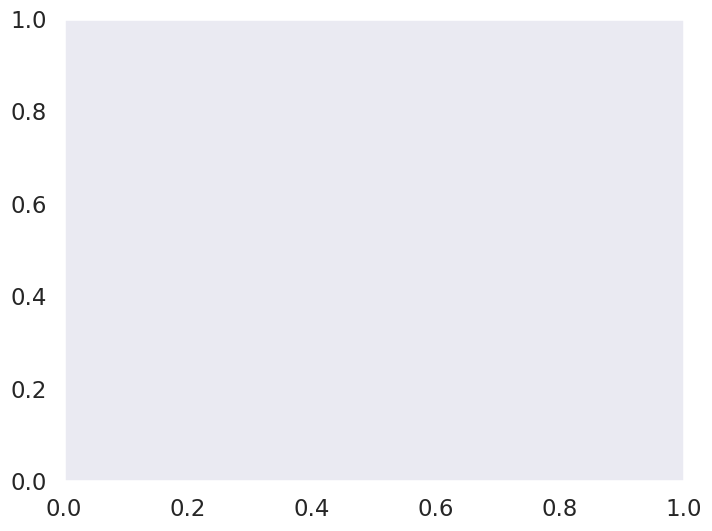

In [ ]:
for i in df['Combined Summary Stage (2004+)'].unique():
  simple_single_grouped_KM_wrapper('Chemotherapy recode (yes, no/unk)',
                                   received_radiation_dict,
                                   df=df[df['Combined Summary Stage (2004+)'] == i],
                                   title_add = 'among ' + i + ' disease')

In [ ]:
surg_rad_simple = ['No radiation and/or cancer-directed surgery',
       'Radiation after surgery',
       'Radiation before and after surgery',
                   'Radiation prior to surgery',]

sys_sur_relevant = ['Systemic therapy after surgery',
                    'Systemic therapy before surgery',
                    'Systemic therapy both before and after surgery',
                    'No systemic therapy and/or surgical procedures']

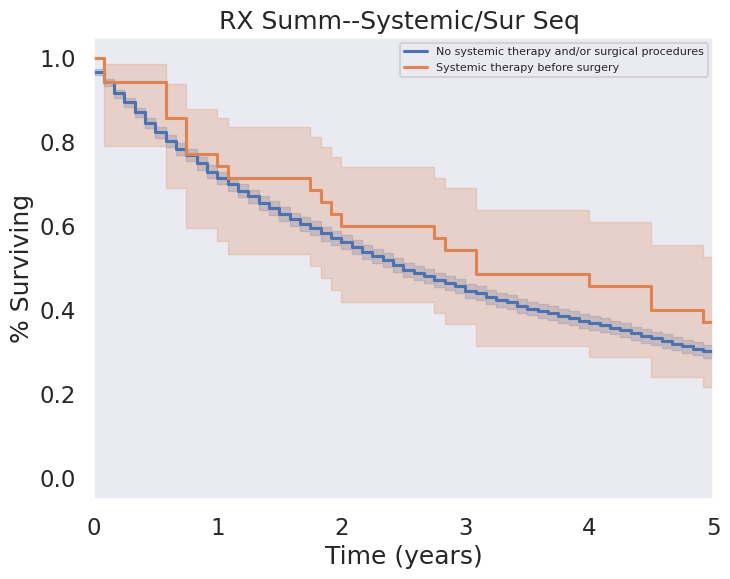

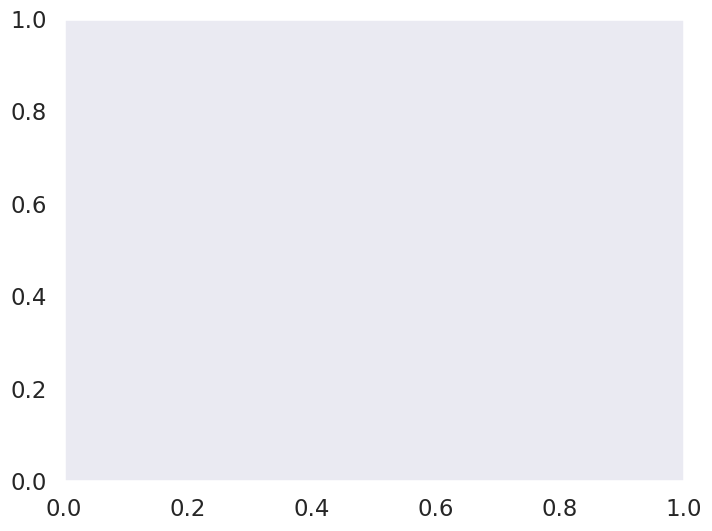

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Systemic/Sur Seq', df=
                                 df[df['RX Summ--Systemic/Sur Seq'].isin(['Systemic therapy before surgery',
                                                                          'No systemic therapy and/or surgical procedures'])])

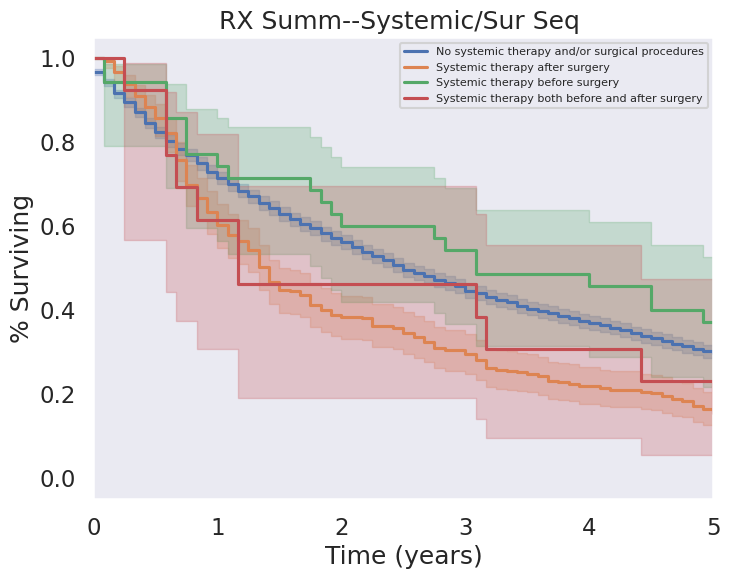

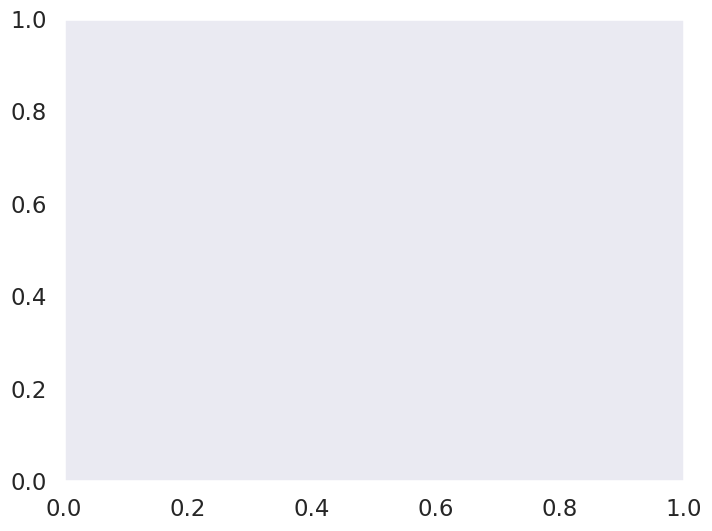

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Systemic/Sur Seq', df=
                                 df[df['RX Summ--Systemic/Sur Seq'].isin(['Systemic therapy after surgery',
                                                                       'Systemic therapy before surgery',
                                                                       'Systemic therapy both before and after surgery',
                                                                          'No systemic therapy and/or surgical procedures'])])

In [ ]:
df['RX Summ--Systemic/Sur Seq'].unique()

array(['Blank(s)', 'No systemic therapy and/or surgical procedures',
       'Systemic therapy after surgery',
       'Systemic therapy before surgery',
       'Systemic therapy both before and after surgery',
       'Sequence unknown',
       'Surgery both before and after systemic therapy'], dtype=object)

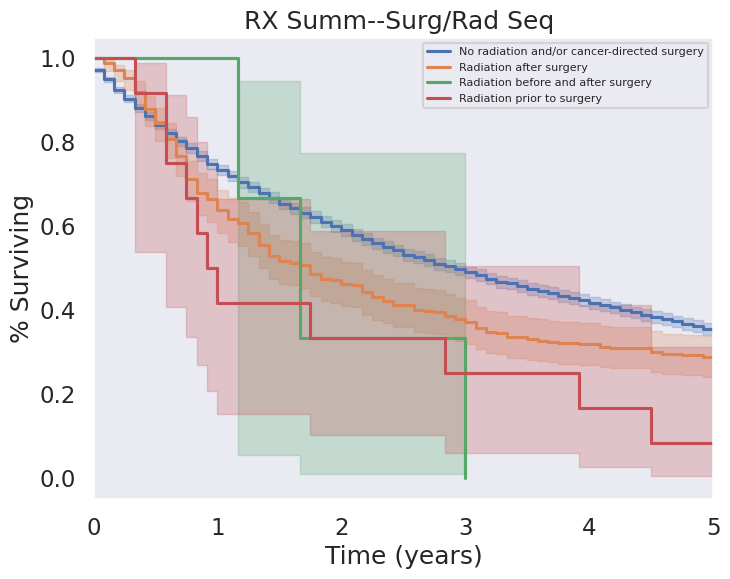

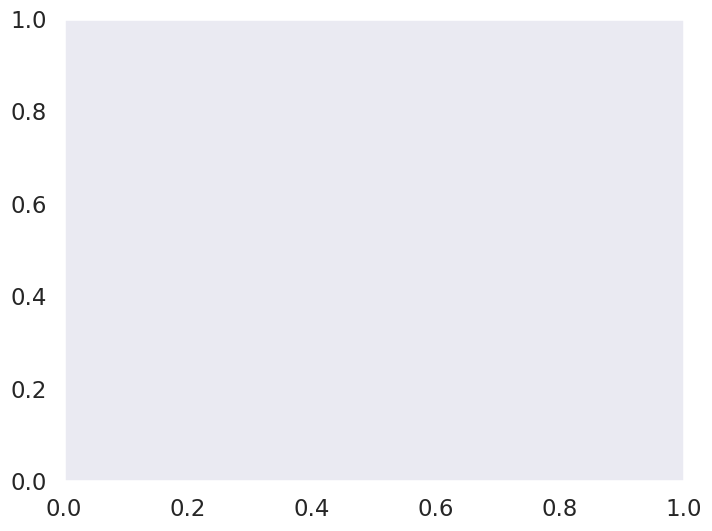

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Surg/Rad Seq', df=df[df['RX Summ--Surg/Rad Seq'].isin(surg_rad_simple)])

In [ ]:
df['RX Summ--Surg Prim Site (1998+)'].unique()

array([60, 30, 40, 20,  0, 27, 10, 90, 22, 25, 24, 50, 14, 99, 12, 23])

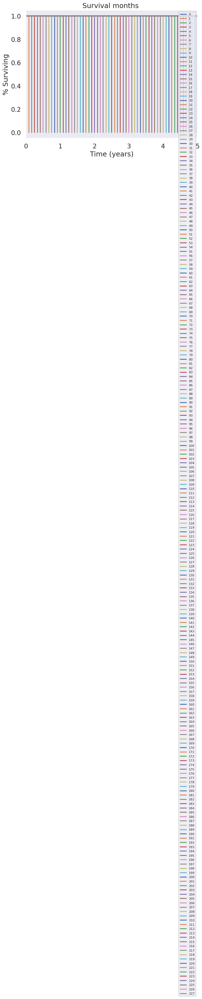

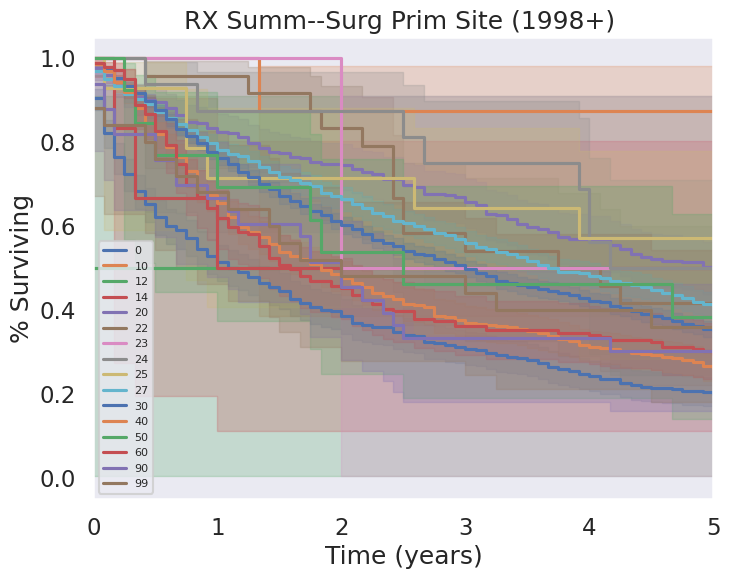

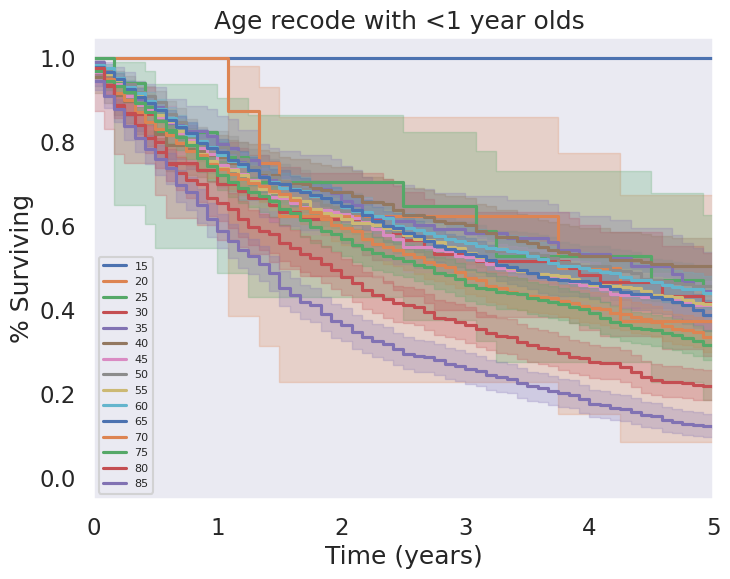

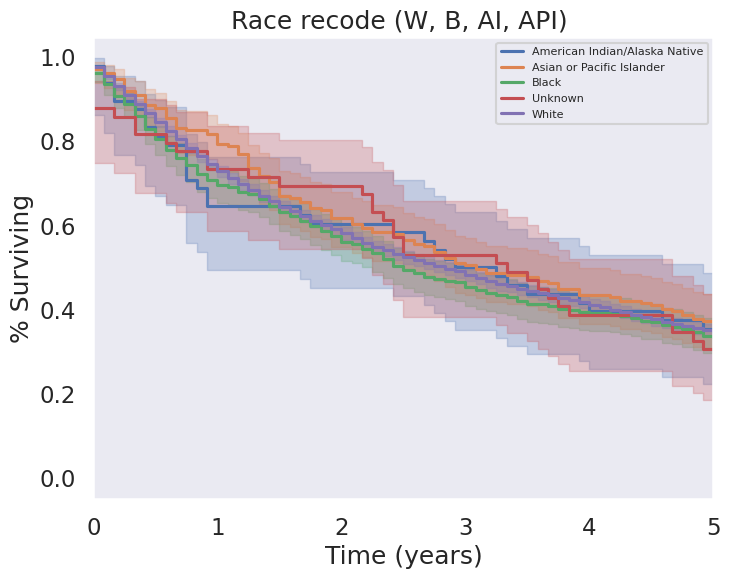

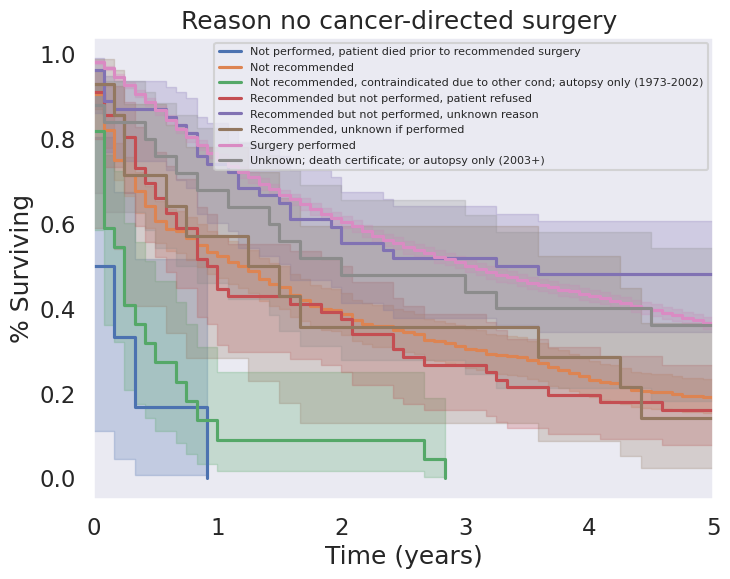

...

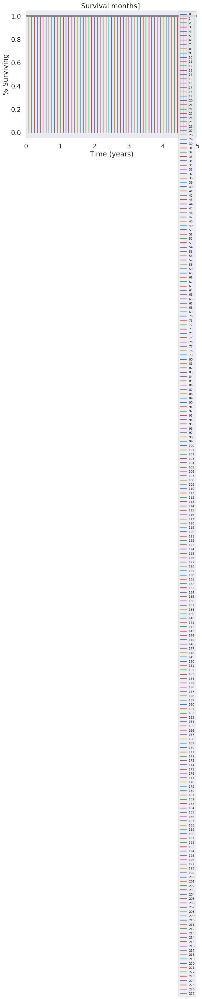

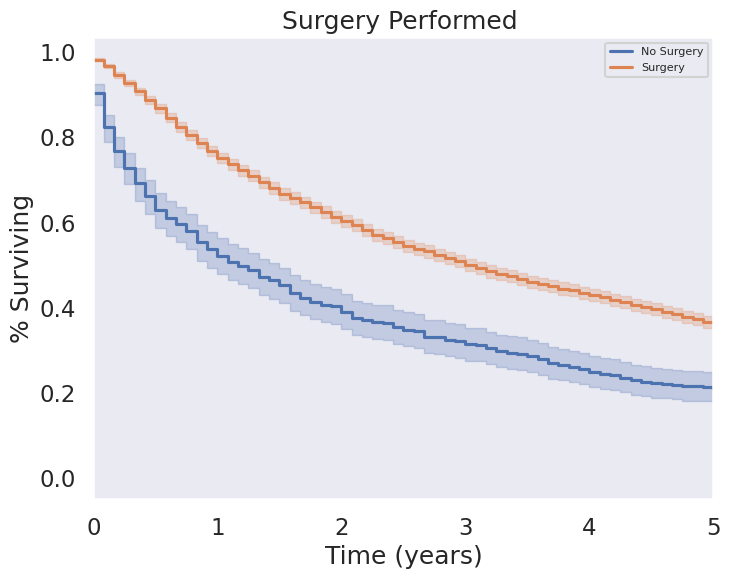

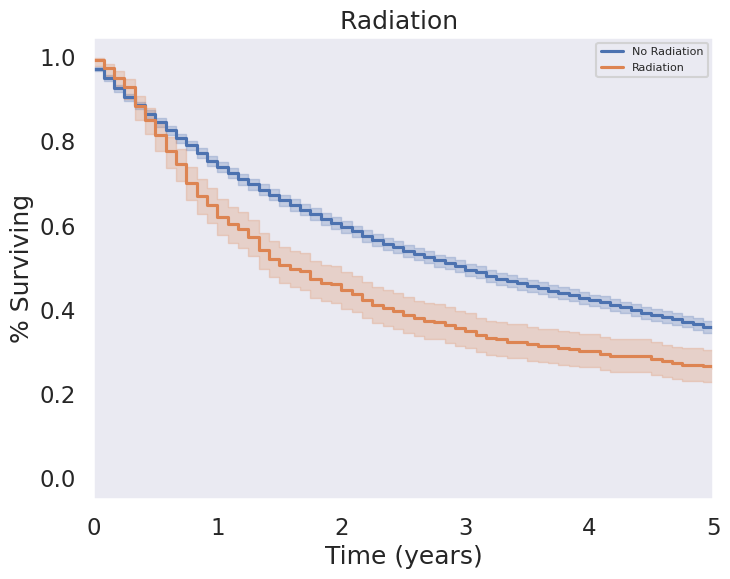

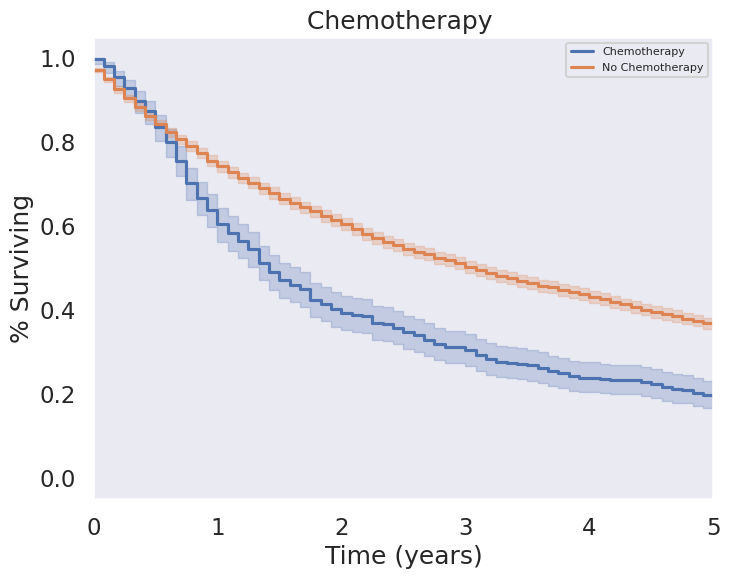

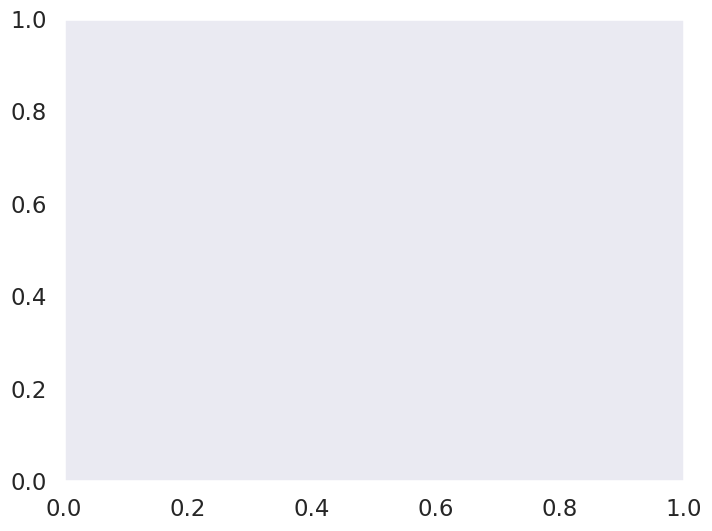

In [ ]:
# KM_generator(['Race recode (W, B, AI, API)', 'Reason no cancer-directed surgery', 'EOD 10 - nodes (1988-2003)', 'EOD 10 - extent (1988-2003)', 'Radiation recode', 'Chemotherapy recode (yes, no/unk)', 'RX Summ--Surg Prim Site (1998+)'])
KM_generator(df.columns)

In [ ]:
for col in df_known:
  if len(df_known[col].unique()) < 25:
    print('————————————————')
    for val in df_known[col].unique():
      print('\nVariable (', col, ') = Value ', val)
      # print('5 year survival =', (pd.to_numeric(df_known[df_known[col] == val]['Survival months']) > 60).mean())
      # print('10 year survival =', (pd.to_numeric(df_known[df_known[col] == val]['Survival months']) > 120).mean())
      print(pd.to_numeric(df_known[df_known[col] == val]['Survival months']).describe())

————————————————

Variable ( RX Summ--Surg Prim Site (1998+) ) = Value  60
count    179.000000
mean      47.357542
std       55.771359
min        0.000000
25%        8.500000
50%       19.000000
75%       70.500000
max      223.000000
Name: Survival months, dtype: float64

Variable ( RX Summ--Surg Prim Site (1998+) ) = Value  30
count    2477.000000
mean       55.936213
std        53.814211
min         0.000000
25%        13.000000
50%        36.000000
75%        85.000000
max       225.000000
Name: Survival months, dtype: float64

Variable ( RX Summ--Surg Prim Site (1998+) ) = Value  40
count    575.000000
mean      44.379130
std       50.719825
min        0.000000
25%        9.000000
50%       22.000000
75%       64.500000
max      224.000000
Name: Survival months, dtype: float64

Variable ( RX Summ--Surg Prim Site (1998+) ) = Value  20
count    251.000000
mean      75.143426
std       61.227276
min        0.000000
25%       23.000000
50%       61.000000
75%      121.000000
max      

In [ ]:
for col in df:
  print('\n————————————————')
  for val in df[col].unique():
    print('\nVariable (', col, ') = Value ', val)
    print('5 year survival =', (pd.to_numeric(df[df[col] == val]['Survival months']) > 60).mean())
    print('10 year survival =', (pd.to_numeric(df[df[col] == val]['Survival months']) > 120).mean())

Streaming output truncated to the last 5000 lines.

Variable ( Survival months ) = Value  92
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  106
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  87
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  84
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  19
5 year survival = 0.0
10 year survival = 0.0

Variable ( Survival months ) = Value  74
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  83
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  79
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  73
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  70
5 year survival = 1.0
10 year survival = 0.0

Variable ( Survival months ) = Value  25
5 year survival = 0.0
10 year surviv

In [ ]:
plt.rcParams['font.family'] = ['sans serif']


In [ ]:
stage_rephrase_dict = {
    'Distant': 'Distant (T4 or M1)',
    'Regional': 'Regional (T2, T3, or N1 to N3)',
    'Localized': 'Localized (T1a or T1b)',
    'Unknown/unstaged': 'Blank(s)',
}

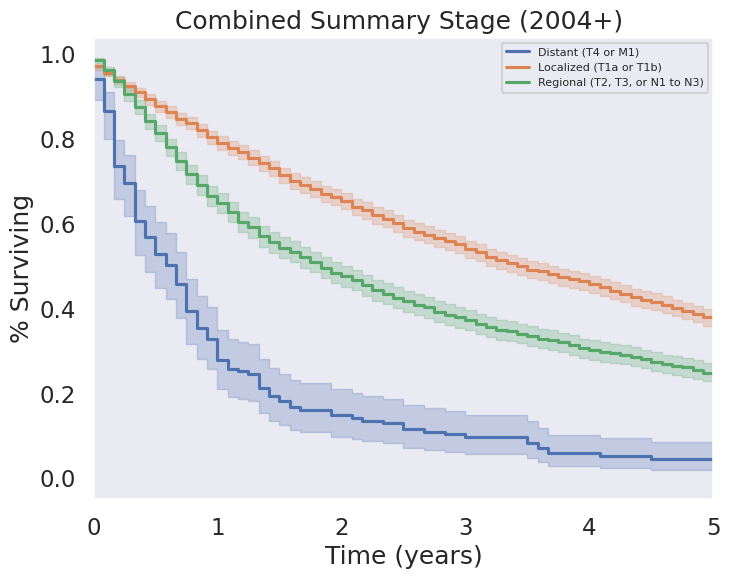

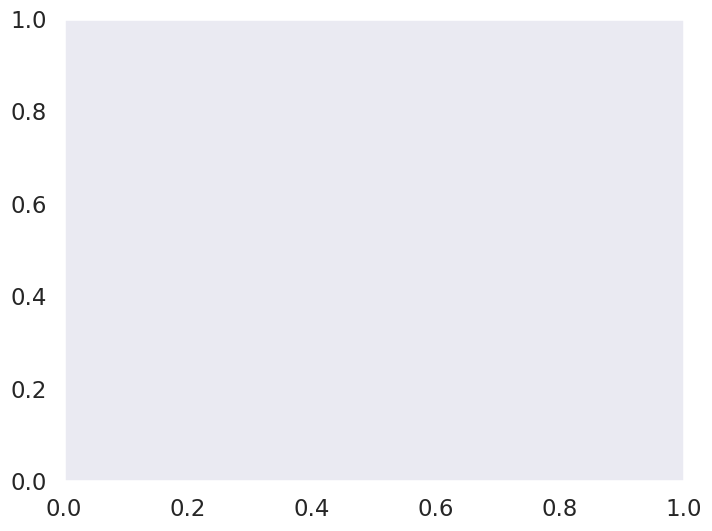

In [ ]:
simple_single_grouped_KM_wrapper('Combined Summary Stage (2004+)', stage_rephrase_dict,
                                 df=df[
                                    (df['Combined Summary Stage (2004+)'] != 'Blank(s)') & (df['Combined Summary Stage (2004+)'] != 'Unknown/unstaged')
                                    ])

In [ ]:
df[df['Marital status at diagnosis']=='Married (including common law)']['Combined Summary Stage (2004+)'].value_counts()

Localized           1283
Regional             895
Blank(s)             509
Distant               80
Unknown/unstaged      72
Name: Combined Summary Stage (2004+), dtype: int64

In [ ]:
df[df['Marital status at diagnosis']!='Married (including common law)']['Combined Summary Stage (2004+)'].value_counts()

Localized           1092
Regional             684
Blank(s)             408
Unknown/unstaged     119
Distant               75
Name: Combined Summary Stage (2004+), dtype: int64

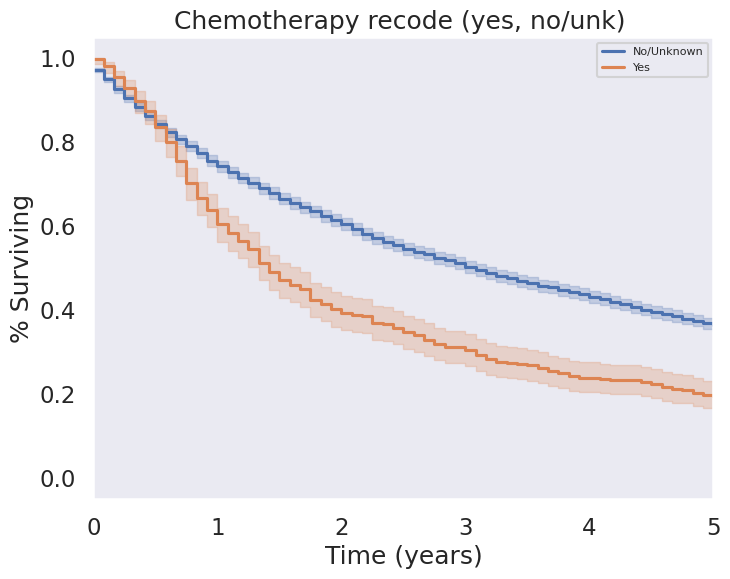

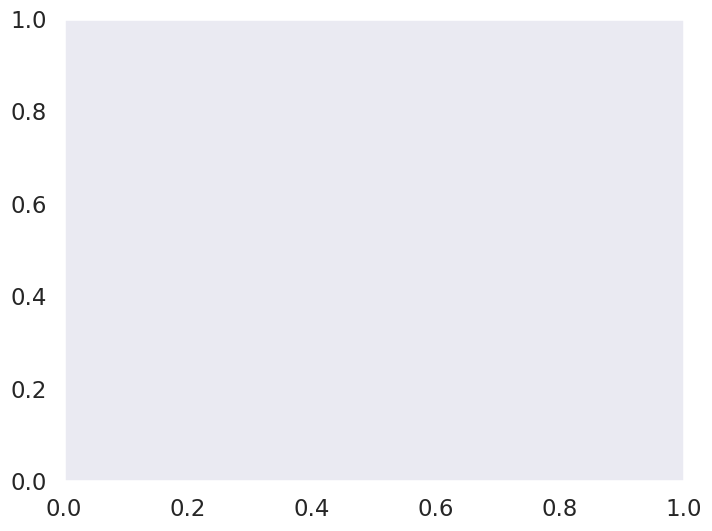

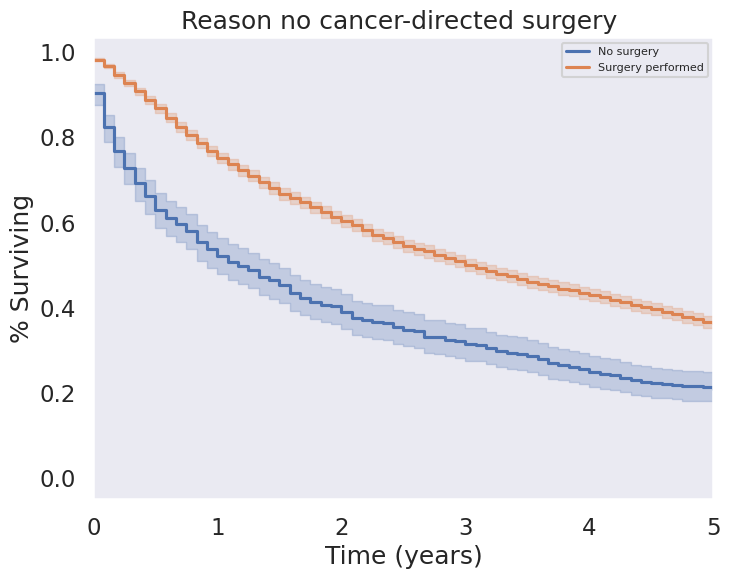

(290, 67)

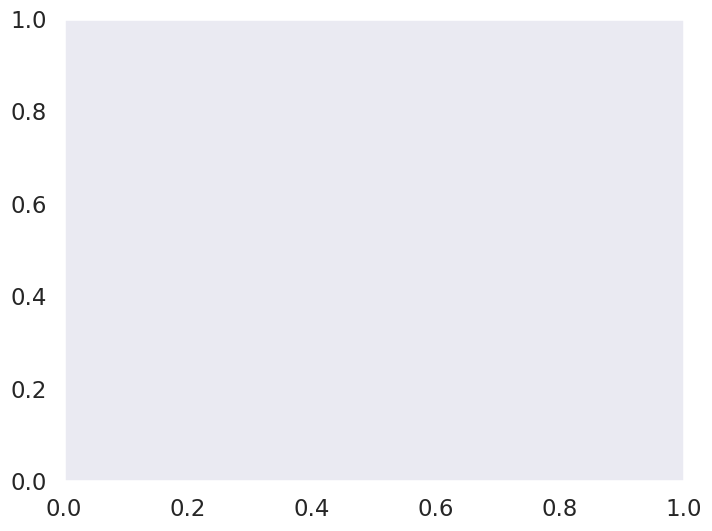

In [ ]:
simple_single_grouped_KM_wrapper('Chemotherapy recode (yes, no/unk)', df=df)
simple_single_grouped_KM_wrapper('Reason no cancer-directed surgery', reason_no_surg_dict)
df['Surgery Performed'] = df['Reason no cancer-directed surgery'].replace(reason_no_surg_dict)
df['Reason no cancer-directed surgery'].replace(reason_no_surg_dict)
df[df['Surgery Performed'] != 'Surgery']['Regional nodes examined (1988+)'].value_counts(normalize=True)
df[df['Surgery Performed'] == 'Surgery']['Regional nodes examined (1988+)'].value_counts(normalize=False)
df[
    (df['Radiation']!='No Radiation') & (df['Surgery Performed']!='Surgery') & (df['Chemotherapy']=='No Chemotherapy')
].shape

In [ ]:
simple_LN_surg = ['None', '4 or more regional lymph nodes removed',
       '1 to 3 regional lymph nodes removed']

LN_surg_dict = {'None': '<4 LN removed',
       '1 to 3 regional lymph nodes removed': '<4 LN removed'}

In [ ]:
df['RX Summ--Scope Reg LN Sur (2003+)'].unique()

array(['None', 'Blank(s)', '4 or more regional lymph nodes removed',
       'Sentinel node biopsy and lym nd removed same/unstated time',
       '1 to 3 regional lymph nodes removed',
       'Number of regional lymph nodes removed unknown',
       'Biopsy or aspiration of regional lymph node, NOS',
       'Sentinel lymph node biopsy', 'Unknown or not applicable',
       'Sentinel node biopsy and lym nd removed different times'],
      dtype=object)

In [ ]:
surg_replace_dict

{0: 'No Surgery',
 10: 'Small Surgery',
 13: 'Small Surgery',
 20: 'Small Surgery',
 22: 'Small Surgery',
 24: 'Small Surgery',
 25: 'Small Surgery',
 27: 'Small Surgery',
 30: 'Big Surgery',
 40: 'Big Surgery',
 60: 'Big Surgery',
 90: 'Surgery NOS'}

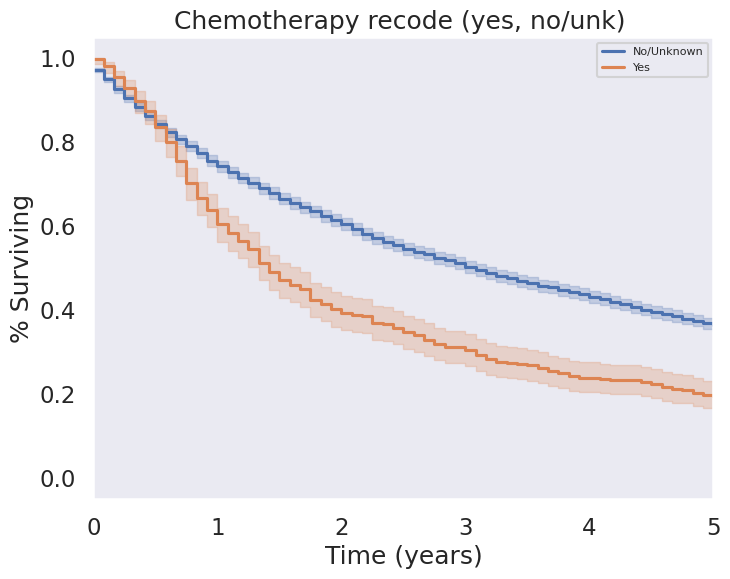

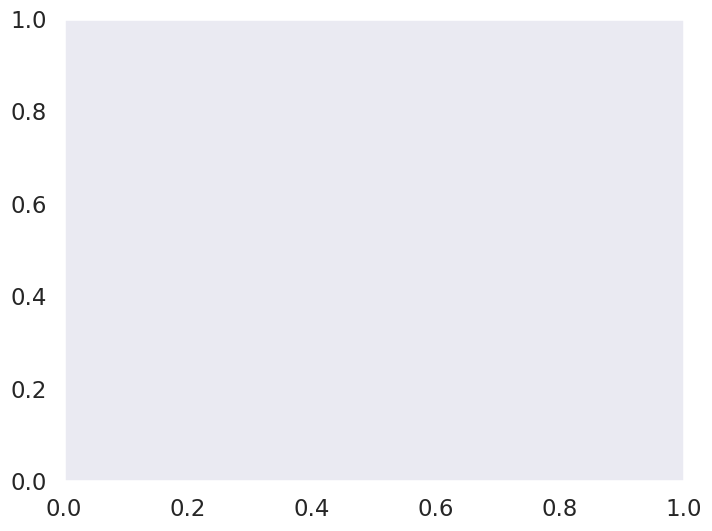

In [ ]:
simple_single_grouped_KM_wrapper('Chemotherapy recode (yes, no/unk)')

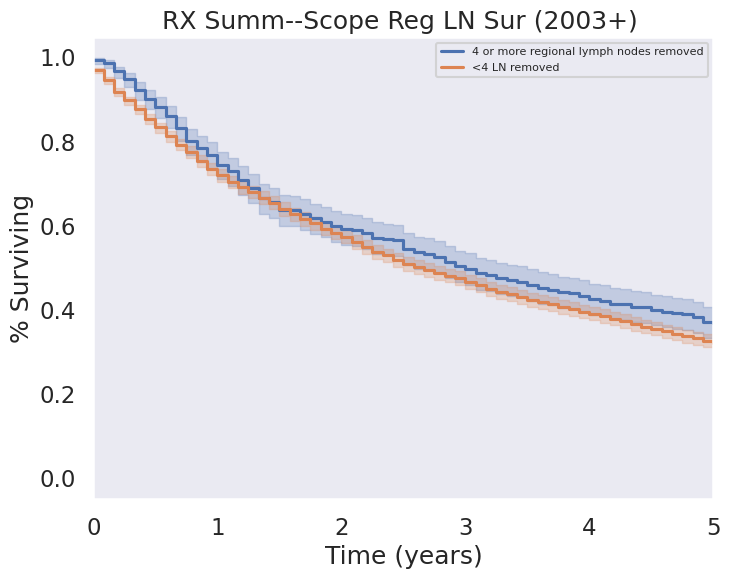

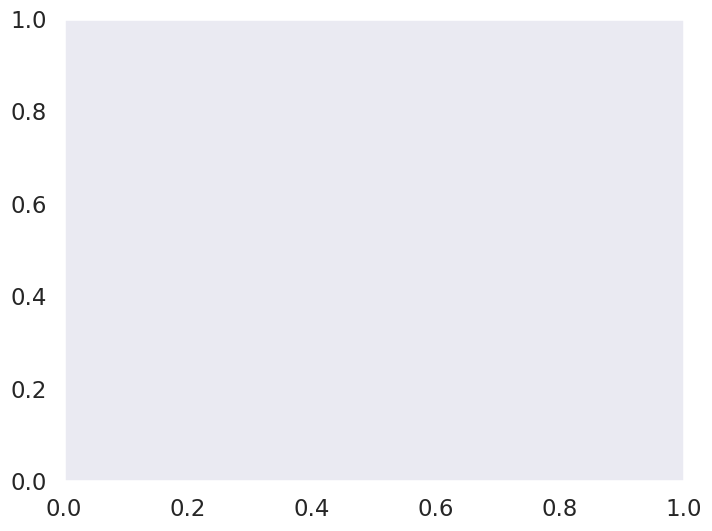

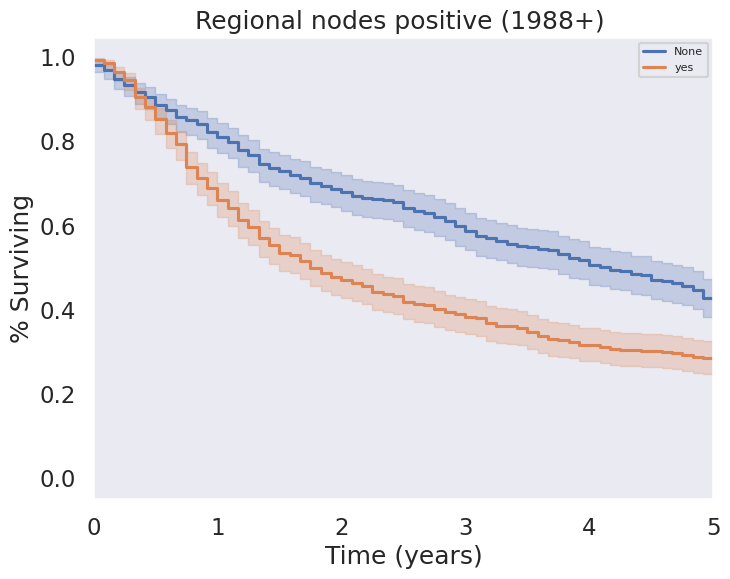

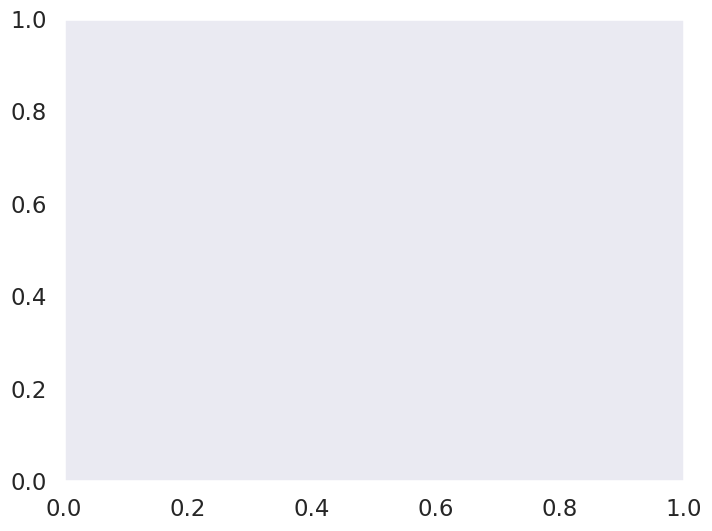

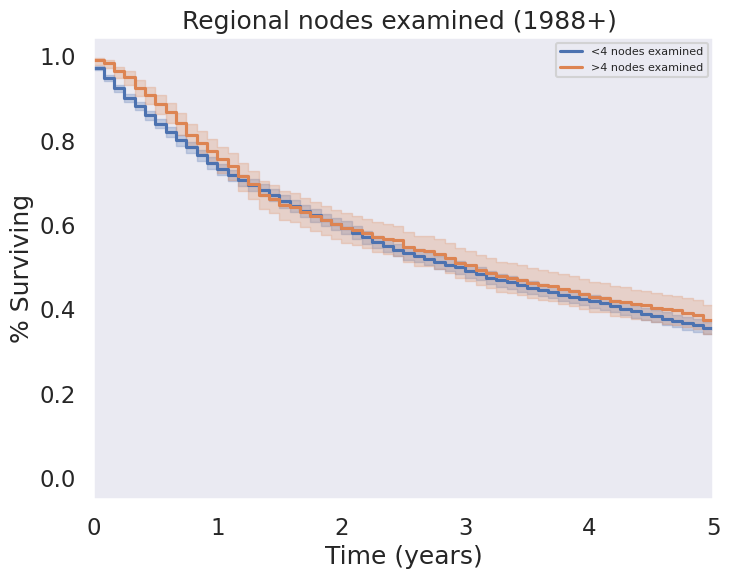

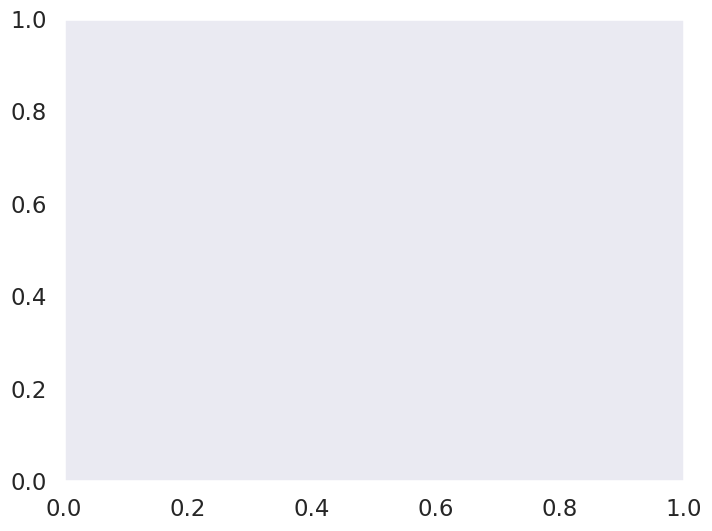

In [ ]:
simple_single_grouped_KM_wrapper('RX Summ--Scope Reg LN Sur (2003+)', LN_surg_dict, df=
                                   df[
                                      (df['RX Summ--Scope Reg LN Sur (2003+)'].isin(simple_LN_surg))
                                     ])

simple_single_grouped_KM_wrapper('Regional nodes positive (1988+)', reg_nod_pos_dict_bin, df=df[
    (df['Regional nodes positive (1988+)'] < 91)])

simple_single_grouped_KM_wrapper('Regional nodes examined (1988+)', reg_n_xam_dict_binary, df=
                                 df[(df['Regional nodes examined (1988+)'] < 91)])


In [ ]:
from lifelines.statistics import logrank_test

def compare_KM_curves(col1, trans_dict=None, input_df=df, title_add = None):
  new_col_title = col1
  temp_df_compare_KM = input_df[[col1, 'Survival months']]
  if trans_dict:
    new_col_title = new_col_title + "_translated"
    temp_df_compare_KM.loc[:, new_col_title] = [trans_dict[x] for x in temp_df_compare_KM[col1]]

  durations_l = []

  for i in range(len(temp_df_compare_KM[new_col_title].unique())):
    for j in range(len(temp_df_compare_KM[new_col_title].unique())):
      durations_A = temp_df_compare_KM[temp_df_compare_KM[new_col_title] == temp_df_compare_KM[new_col_title].unique()[i]]['Survival months']
      durations_B = temp_df_compare_KM[temp_df_compare_KM[new_col_title] == temp_df_compare_KM[new_col_title].unique()[j]]['Survival months']
      print('Comparing:', temp_df_compare_KM[new_col_title].unique()[i], temp_df_compare_KM[new_col_title].unique()[j], logrank_test(durations_A, durations_B))

  simple_single_grouped_KM_wrapper(col1, groups=trans_dict, df=input_df, title_add=title_add)

  return logrank_test(durations_A, durations_B)

Comparing: No systemic therapy and/or surgical procedures No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No systemic therapy and/or surgical procedures Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          36.23 <0.005     29.09
Comparing: Systemic therapy after surgery No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          36.23 <0.005     29.09
Comparing: Systemic therapy after 

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00

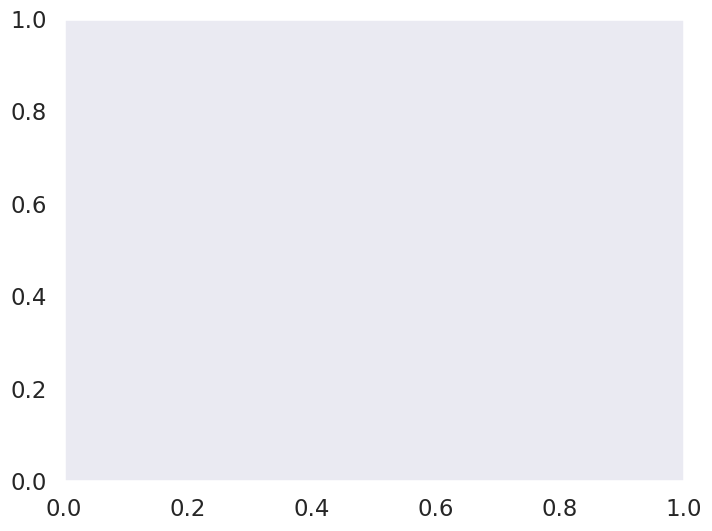

In [ ]:
compare_KM_curves('RX Summ--Systemic/Sur Seq', input_df=
                                 df[df['RX Summ--Systemic/Sur Seq'].isin(['Systemic therapy after surgery',
                                                                          'No systemic therapy and/or surgical procedures'])])

Comparing: Blank(s) Blank(s) <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Blank(s) No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
         667.05 <0.005    486.20
Comparing: Blank(s) Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
         257.31 <0.005    189.95
Comparing: Blank(s) Systemic therapy before surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedo

<lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00

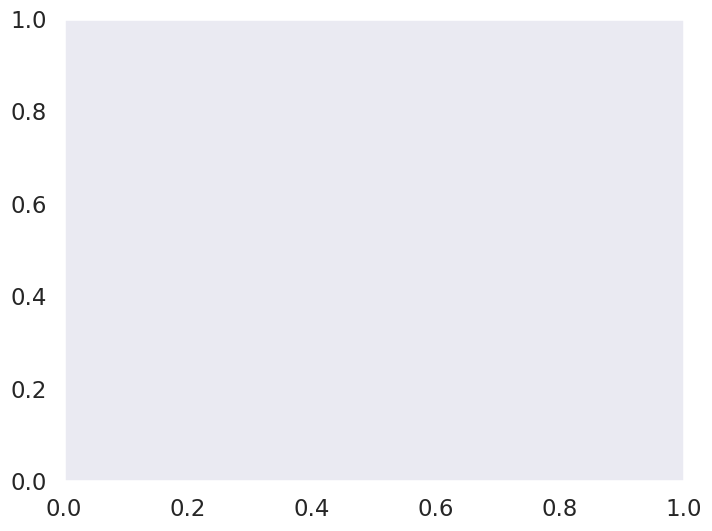

In [ ]:
compare_KM_curves('RX Summ--Systemic/Sur Seq', input_df=df)

Comparing: No radiation and/or cancer-directed surgery No radiation and/or cancer-directed surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No radiation and/or cancer-directed surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.03 0.87      0.20
Comparing: No radiation and/or cancer-directed surgery Radiation prior to surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           3.80 0.05      4.29
Comparing: Radiation after surgery No radiation and/or cancer-dir

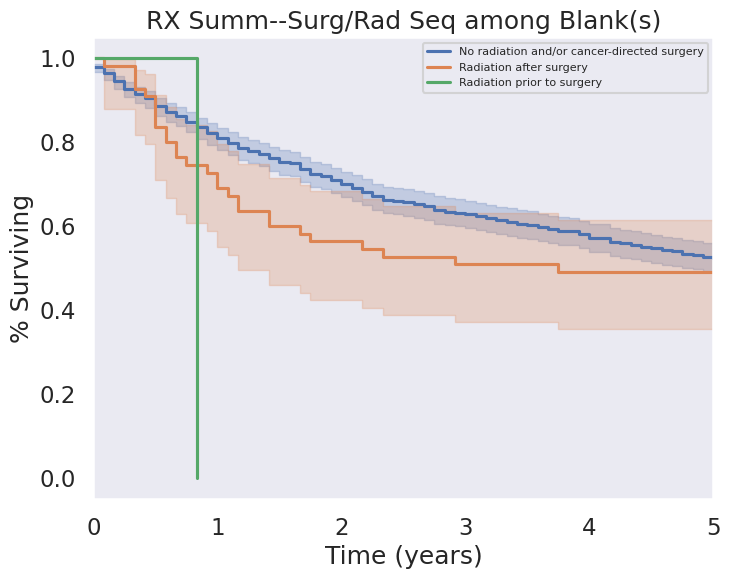

Comparing: No radiation and/or cancer-directed surgery No radiation and/or cancer-directed surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No radiation and/or cancer-directed surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.68 0.41      1.29
Comparing: No radiation and/or cancer-directed surgery Radiation prior to surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.78 0.38      1.41
Comparing: Radiation after surgery No radiation and/or cancer-dir

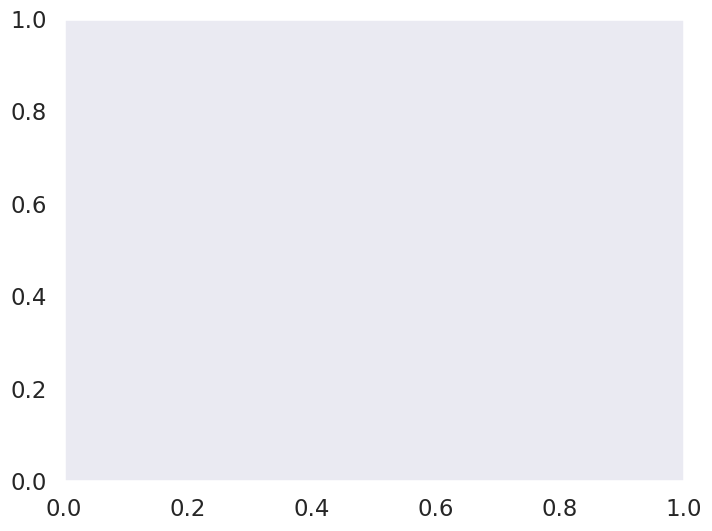

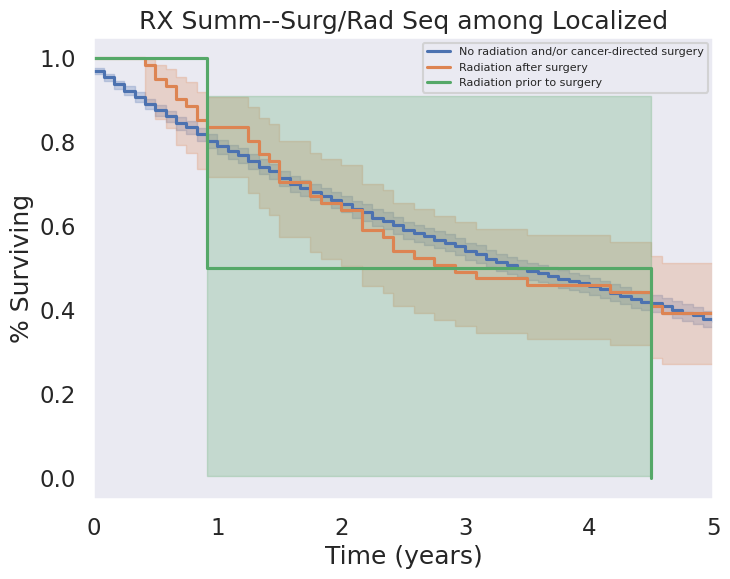

Comparing: No radiation and/or cancer-directed surgery No radiation and/or cancer-directed surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No radiation and/or cancer-directed surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.92 0.17      2.59
Comparing: No radiation and/or cancer-directed surgery Radiation before and after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.42 0.52      0.95
Comparing: No radiation and/or cancer-directed surgery Ra

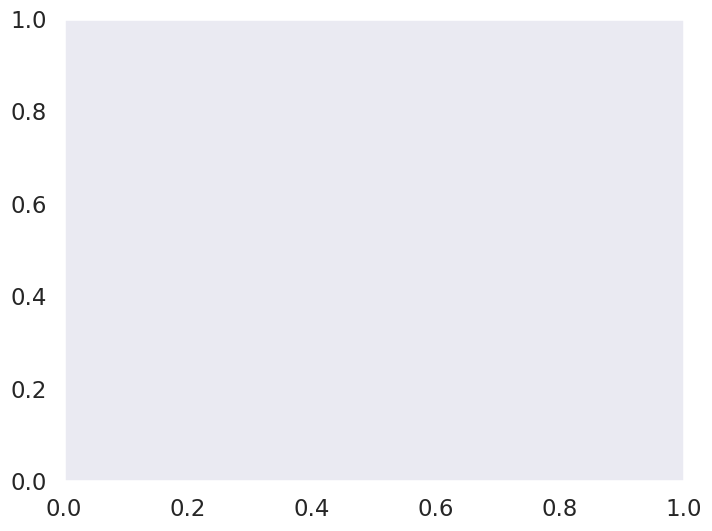

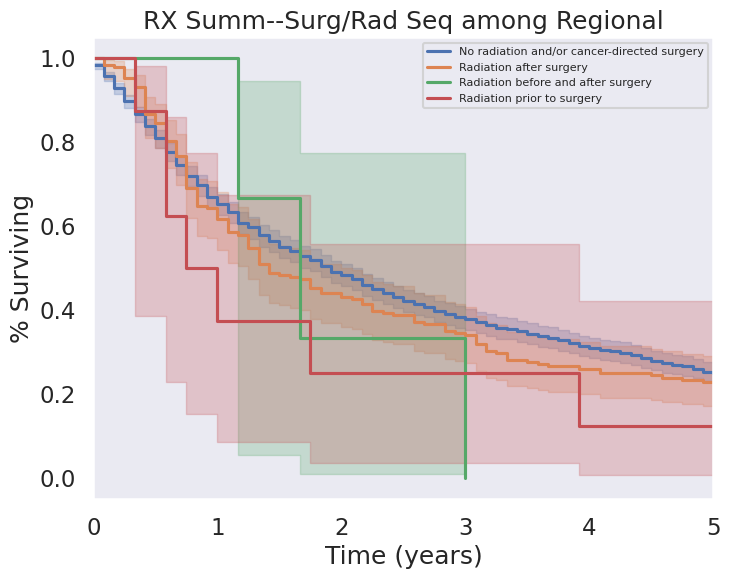

Comparing: Radiation after surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Radiation after surgery No radiation and/or cancer-directed surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.52 0.47      1.09
Comparing: No radiation and/or cancer-directed surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.52 0.47      1.09
Comparing: No radiation and/or cancer-directed surgery No radiation and/or cancer-directed surgery <lifeline

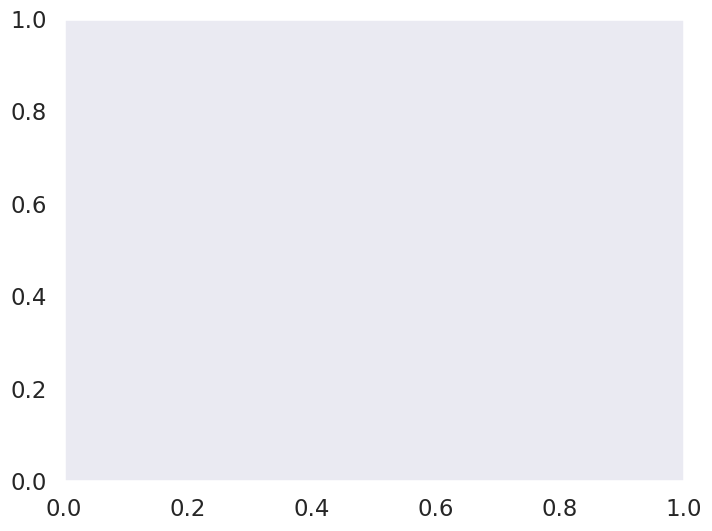

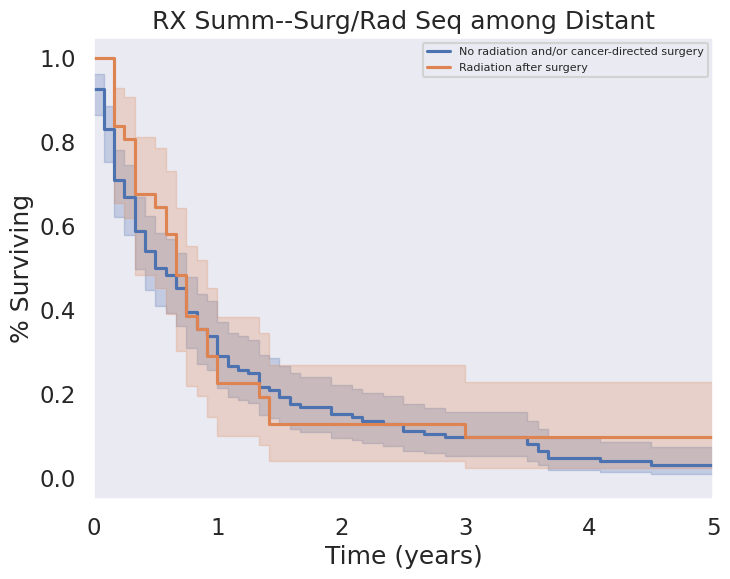

Comparing: No radiation and/or cancer-directed surgery No radiation and/or cancer-directed surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No radiation and/or cancer-directed surgery Radiation after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 0.99      0.01
Comparing: No radiation and/or cancer-directed surgery Radiation prior to surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.01 0.92      0.13
Comparing: Radiation after surgery No radiation and/or cancer-dir

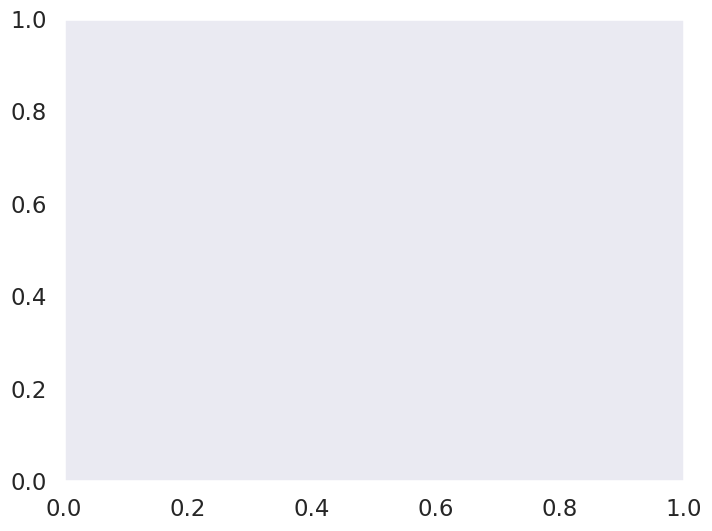

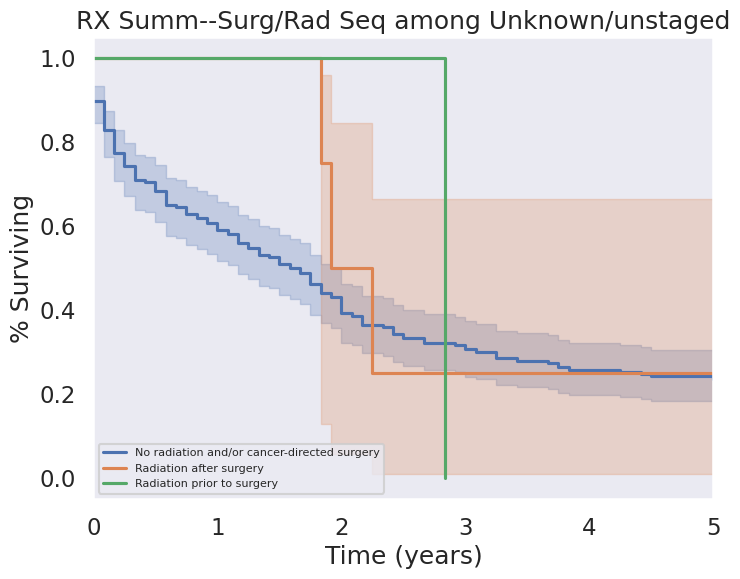

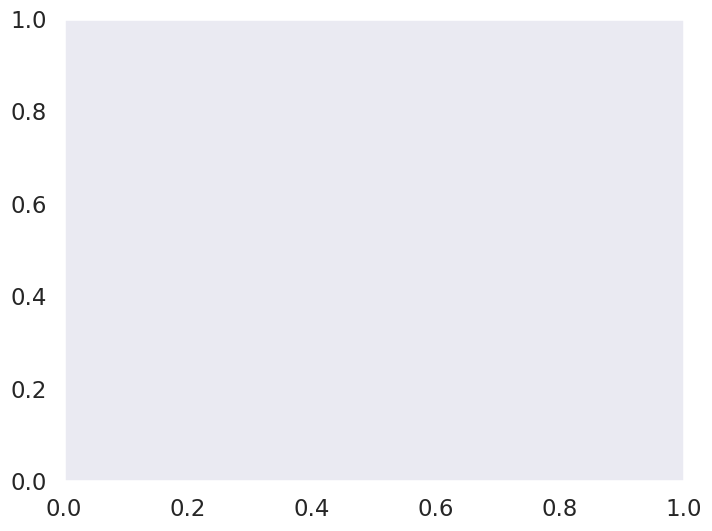

In [ ]:
for i in df['Combined Summary Stage (2004+)'].unique():
  try:
    compare_KM_curves('RX Summ--Surg/Rad Seq',
                    input_df=df[
                        (df['Combined Summary Stage (2004+)'] == i)
                         & (df['RX Summ--Surg/Rad Seq'].isin(surg_rad_simple))],
                     title_add = str('among ' + i))
  except Exception as e:
    print(e)


Aborting... empty array.
local variable 'durations_A' referenced before assignment
Comparing: No systemic therapy and/or surgical procedures No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No systemic therapy and/or surgical procedures Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.62 0.43      1.21
Comparing: No systemic therapy and/or surgical procedures Systemic therapy before surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p

<Figure size 800x600 with 0 Axes>

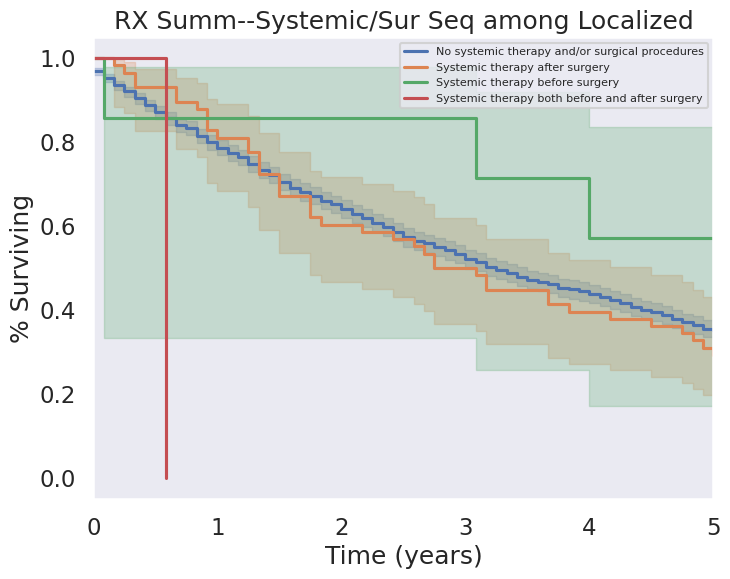

Comparing: No systemic therapy and/or surgical procedures No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No systemic therapy and/or surgical procedures Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           5.92 0.01      6.07
Comparing: No systemic therapy and/or surgical procedures Systemic therapy before surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.66 0.42      1.27
Comparing: No systemic therapy and/or sur

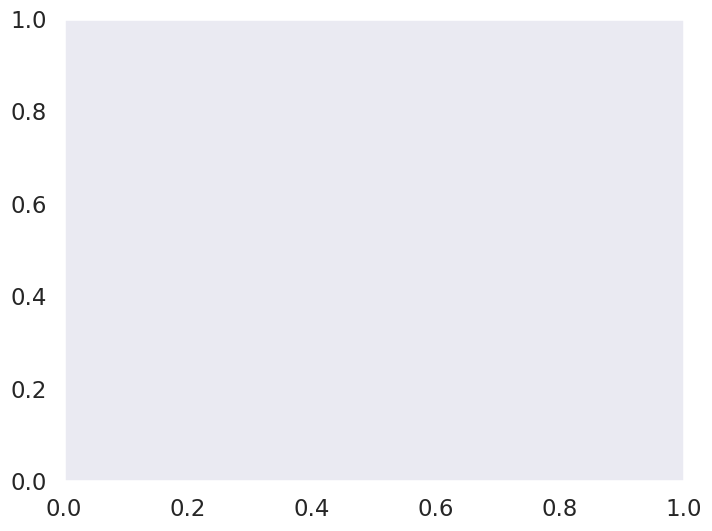

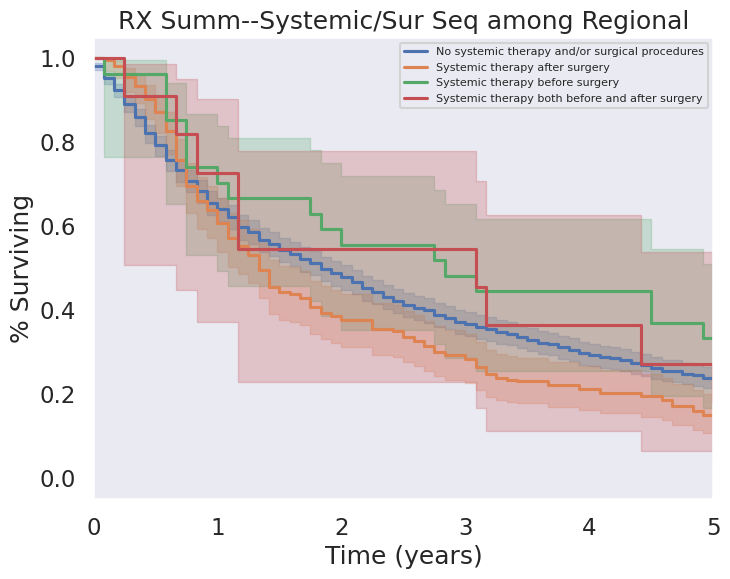

Comparing: Systemic therapy after surgery Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Systemic therapy after surgery No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           4.22 0.04      4.64
Comparing: Systemic therapy after surgery Systemic therapy before surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.48 0.49      1.03
Comparing: Systemic therapy after surgery Systemic therapy both before and after surgery 

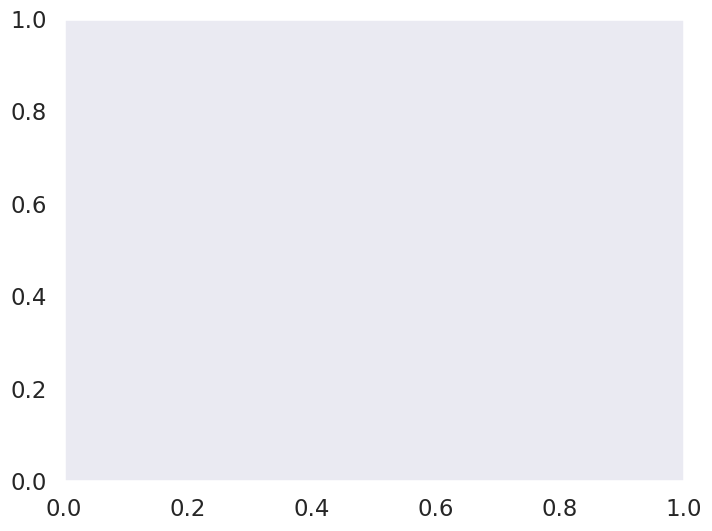

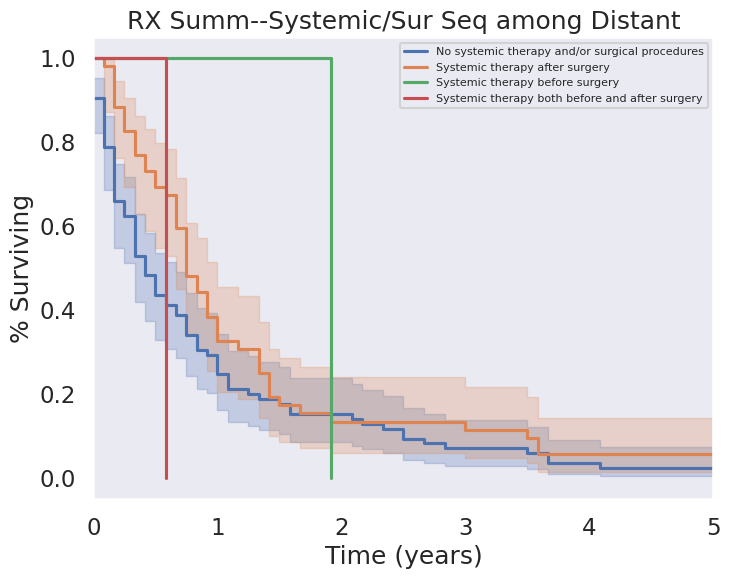

Comparing: No systemic therapy and/or surgical procedures No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No systemic therapy and/or surgical procedures Systemic therapy after surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.05 0.82      0.29
Comparing: Systemic therapy after surgery No systemic therapy and/or surgical procedures <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.05 0.82      0.29
Comparing: Systemic therapy after surgery 

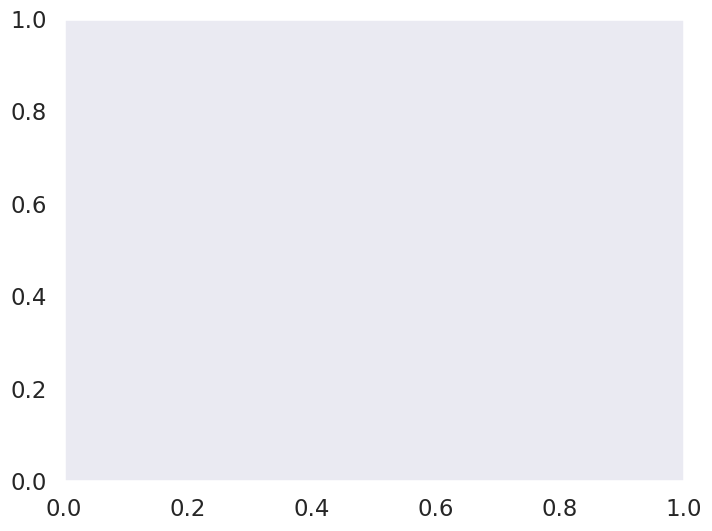

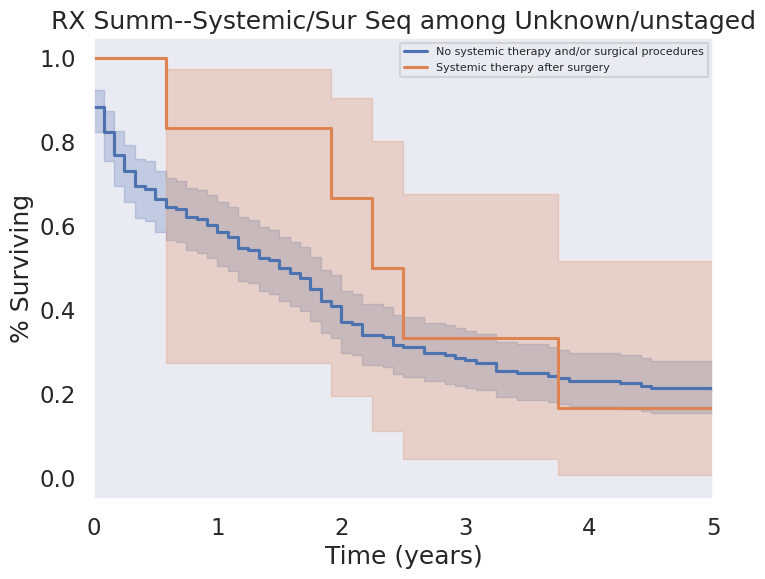

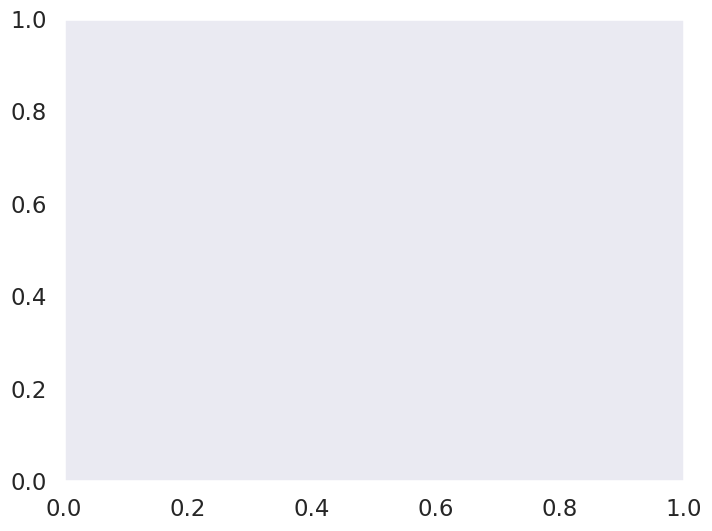

In [ ]:
for i in df['Combined Summary Stage (2004+)'].unique():
  try:
    compare_KM_curves('RX Summ--Systemic/Sur Seq',
                    input_df=df[
                        (df['Combined Summary Stage (2004+)'] == i)
                         & (df['RX Summ--Systemic/Sur Seq'].isin(sys_sur_relevant))],
                     title_add = str('among ' + i))
  except Exception as e:
    print(e)






FOR  Blank(s) DISEASE
Comparing: No Surgery No Surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No Surgery Local tumor excision, NOS <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           6.00 0.01      6.13
Comparing: No Surgery Simple/partial surgical removal of primary site <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           4.89 0.03      5.21
Comparing: No Surgery Excisional biopsy <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees

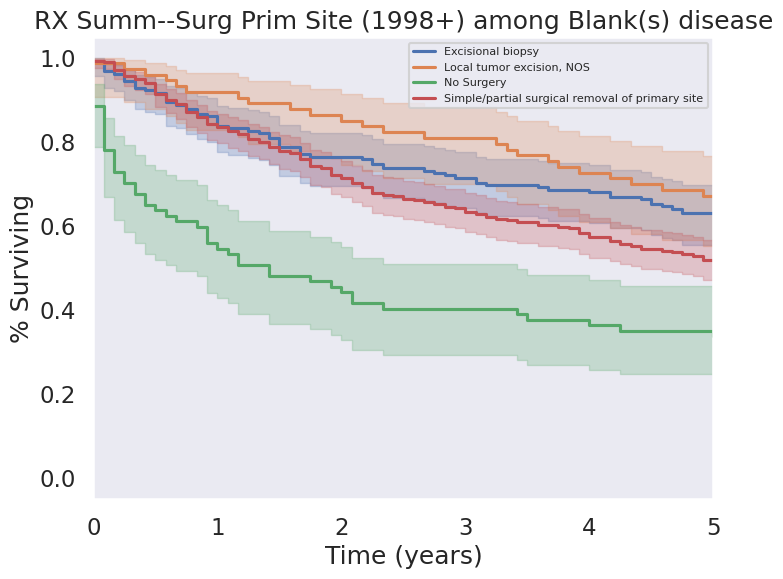










FOR  Localized DISEASE
Comparing: Simple/partial surgical removal of primary site Simple/partial surgical removal of primary site <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Simple/partial surgical removal of primary site Local tumor excision, NOS <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          12.14 <0.005     10.99
Comparing: Simple/partial surgical removal of primary site No Surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          13.02 <0.005     11.66
Comparing: Simple/parti

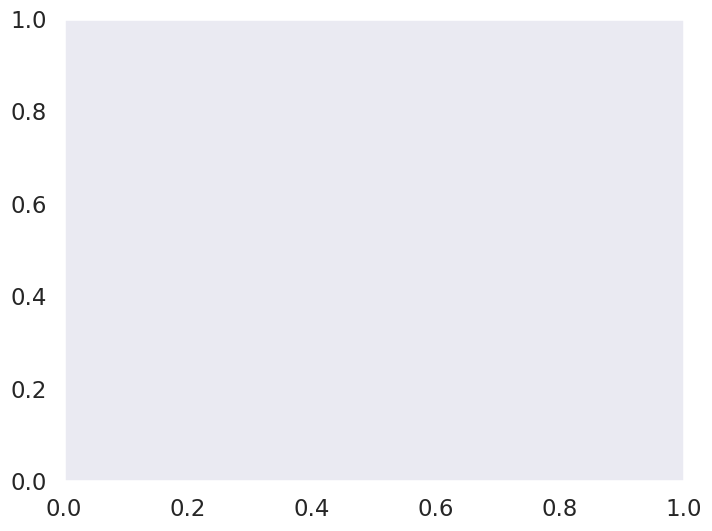

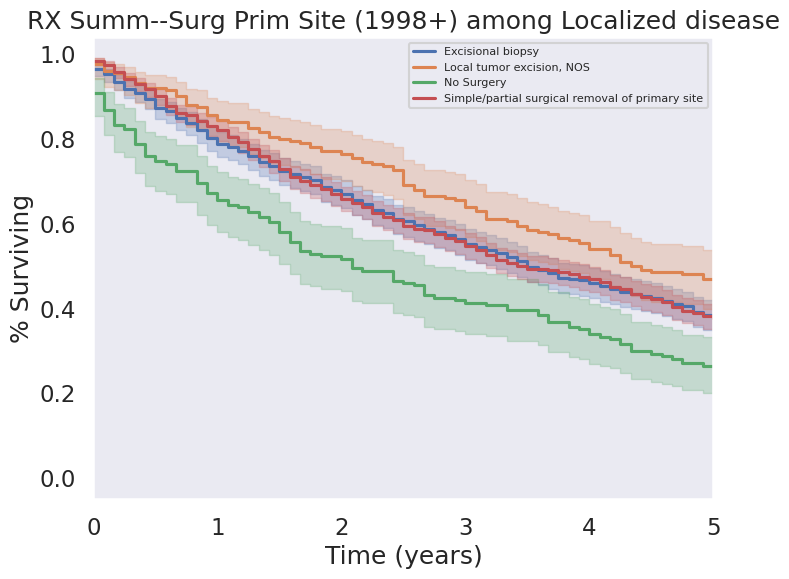










FOR  Regional DISEASE
Comparing: Simple/partial surgical removal of primary site Simple/partial surgical removal of primary site <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Simple/partial surgical removal of primary site No Surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
          32.91 <0.005     26.63
Comparing: Simple/partial surgical removal of primary site Excisional biopsy <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.74 0.19      2.42
Comparing: Simple/partial surgical r

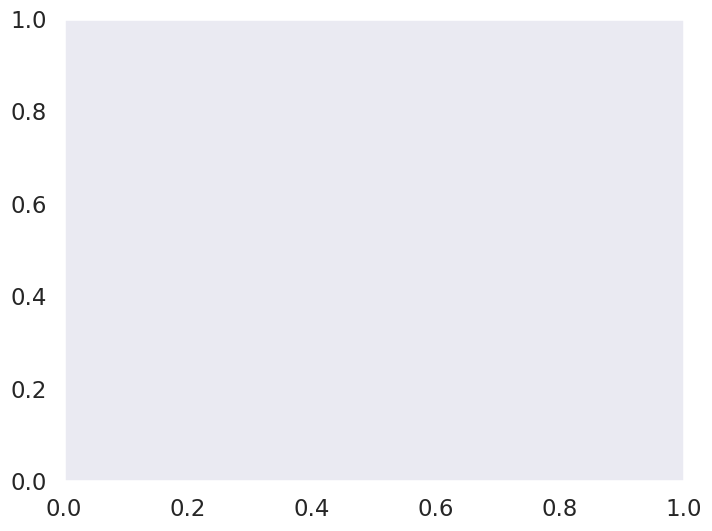

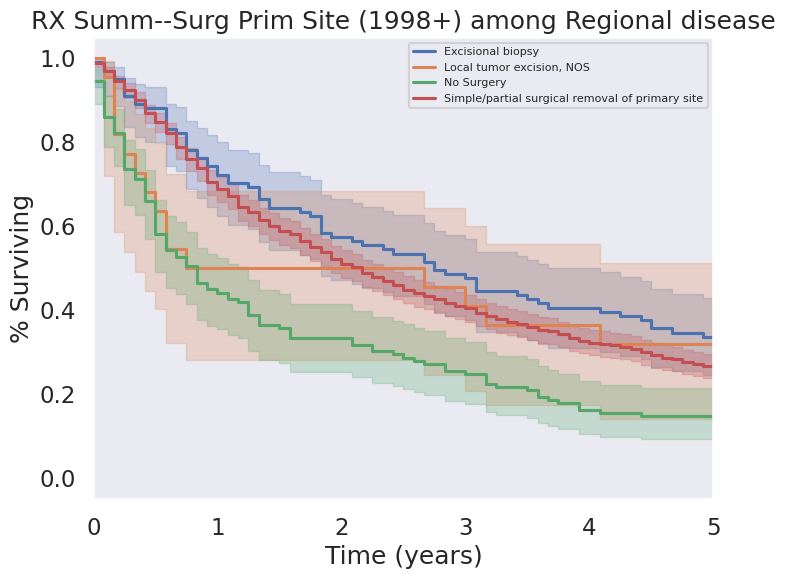










FOR  Distant DISEASE
Comparing: No Surgery No Surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: No Surgery Simple/partial surgical removal of primary site <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic      p  -log2(p)
           8.63 <0.005      8.24
Comparing: No Surgery Excisional biopsy <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.38 0.54      0.90
Comparing: No Surgery Local tumor excision, NOS <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared

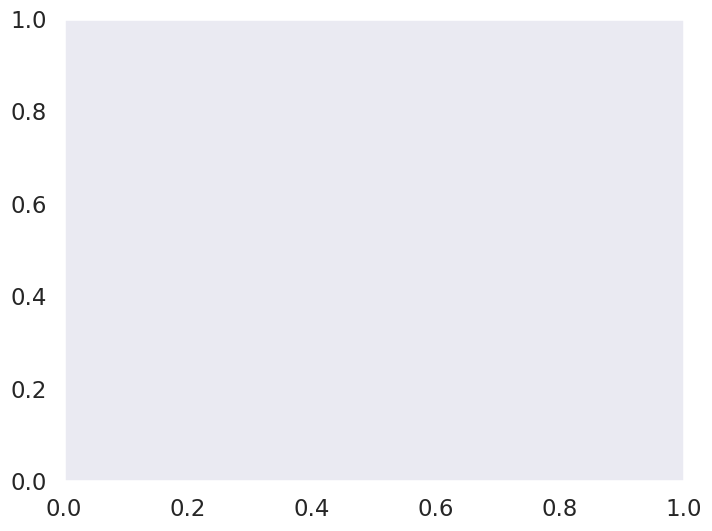

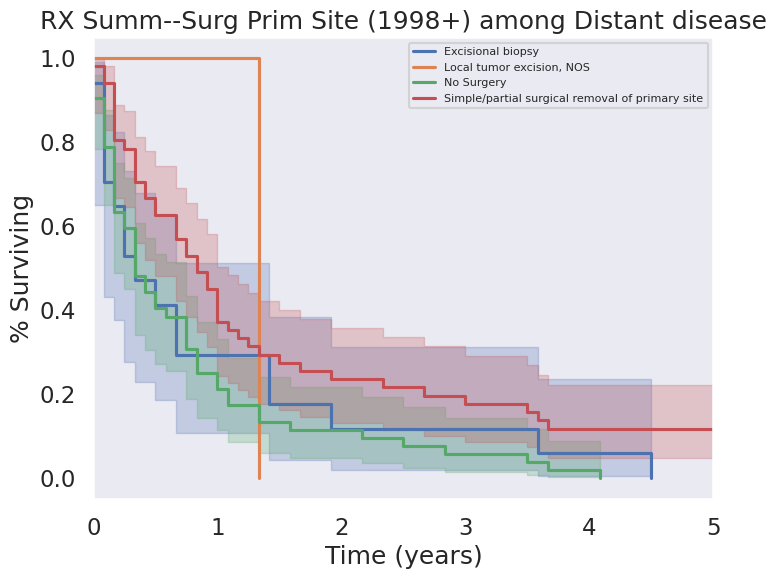










FOR  Unknown/unstaged DISEASE
Comparing: Simple/partial surgical removal of primary site Simple/partial surgical removal of primary site <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.00 1.00     -0.00
Comparing: Simple/partial surgical removal of primary site No Surgery <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           1.95 0.16      2.62
Comparing: Simple/partial surgical removal of primary site Excisional biopsy <lifelines.StatisticalResult: logrank_test>
               t_0 = -1
 null_distribution = chi squared
degrees_of_freedom = 1
         test_name = logrank_test

---
 test_statistic    p  -log2(p)
           0.67 0.41      1.27
Comparing: Simple/partial surgic

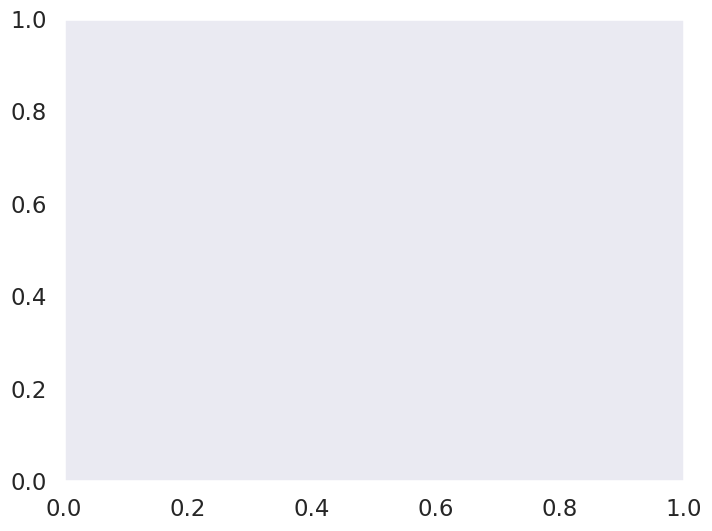

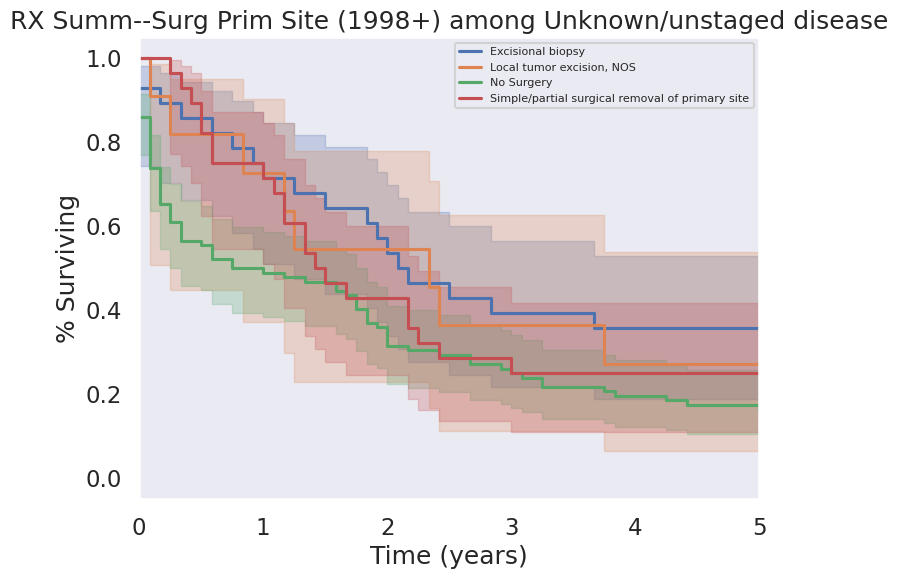

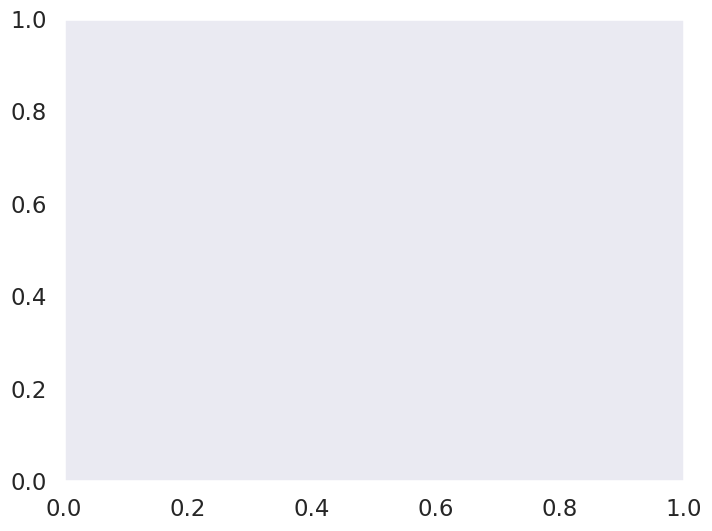

In [ ]:
for i in df['Combined Summary Stage (2004+)'].unique():
  # simple_single_grouped_KM_wrapper('Regional nodes examined (1988+)', reg_n_xam_dict_binary, df=df[(df['Combined Summary Stage (2004+)'] == i) & (df['Regional nodes examined (1988+)'] < 91)], title_add = str('among ' + i))
  # simple_single_grouped_KM_wrapper('Regional nodes positive (1988+)', reg_nod_pos_dict_bin, df=df[(df['Combined Summary Stage (2004+)'] == i) & (df['Regional nodes positive (1988+)'] < 91)], title_add = str('among ' + i))
  # simple_single_grouped_KM_wrapper('RX Summ--Scope Reg LN Sur (2003+)', LN_surg_dict, df=
  #                                  df[
  #                                     (df['Combined Summary Stage (2004+)'] == i)
  #                                     & (df['RX Summ--Scope Reg LN Sur (2003+)'].isin(simple_LN_surg))
  #                                    ], title_add = str('among ' + i))
  working_df = df[(((df['RX Summ--Surg Prim Site (1998+)'] < 35) & (df['RX Summ--Surg Prim Site (1998+)'] > 14)) | (df['RX Summ--Surg Prim Site (1998+)'] == 0)) & (df['Combined Summary Stage (2004+)'] == i)]
  print('\n\n\n\nFOR ', i, 'DISEASE')
  compare_KM_curves('RX Summ--Surg Prim Site (1998+)', penis_surg_replace_dict_simple, input_df=working_df, title_add = str('among ' + i + ' disease'))
  print('\n\n\n\n')

# Encoding the dataframe so it fits into SPSS

In [ ]:
suffix = DATA_PATH[:-3]
df.to_excel('Excel Data for Burke' + suffix + '.xls')

ModuleNotFoundError: ignored

In [ ]:
# so you want to build a dictionary where the key is the column title,
# and the value is another dictionary where the key is each data point and the value is an integer

def build_nested_dictionary(df):
  col_name_to_key = {}

  for col in df:
    integers_to_data_points = {}
    ct = 0
    for val in df[col]:
      if val not in integers_to_data_points.keys():
        integers_to_data_points[val] = ct
        ct += 1
    col_name_to_key[col] = integers_to_data_points

  return col_name_to_key

In [ ]:
def encode_df(df):
  col_name_to_key = build_nested_dictionary(df)
  encoded_df = df.copy(deep=True)
  for col in encoded_df:
    if np.array_equal(encoded_df[col], pd.to_numeric(encoded_df[col], errors='coerce')):
      print('Column ', col, ' already encoded!')
    else:
      encoded_df.replace({col: col_name_to_key.get(col)}, inplace=True)

  encoded_df.apply(pd.to_numeric, errors='coerce')
  return encoded_df, col_name_to_key

In [ ]:
def coding_dict_to_decoding_dict(coding_dict):
  decode = {}
  for i in coding_dict.keys(): #coding_dict AKA col_name_to_keys
    decode[i] = dict([(v, [k for k, v1 in col_name_to_key[i].items() if v1 == v])
                for v in set(col_name_to_key[i].values())])

  return decode

In [ ]:
def write_encoded_and_decoder_files(df):
  encoded_df, coding_dict = encode_df(df)

  suffix = DATA_PATH[:-3] + " encoded"
  encoded_df.to_excel('Excel Data for Burke' + suffix + '.xls')

  decode_dict = coding_dict_to_decoding_dict(coding_dict)
  decoder_df = pd.DataFrame.from_dict(decode, orient='index').T

  suffix = DATA_PATH[:-3] + "_decoding_key"
  decoder_df.to_excel('Excel Data for Burke' + suffix + '.xls')


# Unsupervised Machine Learning

#### Multivariate Analysis

In [ ]:
df.head()

,Survival months,RX Summ--Surg Prim Site (1998+),Age recode with <1 year olds,"Race recode (W, B, AI, API)",Reason no cancer-directed surgery,RX Summ--Scope Reg LN Sur (2003+),First malignant primary indicator,Histologic Type ICD-O-3,Site recode ICD-O-3/WHO 2008,Histology recode - broad groupings,"Year of diagnosis (00-03, 04-18 by 5)",EOD 10 - extent (1988-2003),EOD 10 - nodes (1988-2003),EOD 10 - size (1988-2003),Grade (thru 2017),Grade Clinical (2018+),Grade Pathological (2018+),Radiation recode,"Chemotherapy recode (yes, no/unk)",RX Summ--Systemic/Sur Seq,RX Summ--Surg/Rad Seq,B Symptoms Recode (2010+),SEER Combined Mets at DX-bone (2010+),SEER Combined Mets at DX-brain (2010+),SEER Combined Mets at DX-liver (2010+),SEER Combined Mets at DX-lung (2010+),Mets at DX-Distant LN (2016+),Mets at DX-Other (2016+),Regional nodes examined (1988+),Regional nodes positive (1988+),Tumor Size Summary (2016+),CS tumor size (2004-2015),CS extension (2004-2015),CS mets at dx (2004-2015),CS Tumor Size/Ext Eval (2004-2015),CS Reg Node Eval (2004-2015),CS Mets Eval (2004-2015),SEER cause-specific death classification,SEER other cause of death classification,COD to site rec KM,Survival months flag,SEER registry (with CA and GA as whole states),Sex,Behavior code ICD-O-3,AYA site recode 2020 Revision,Primary Site,Laterality,Diagnostic Confirmation,Combined Summary Stage (2004+),Summary stage 2000 (1998-2017),CEA Pretreatment Interpretation Recode (2010+),Breslow Thickness Recode (2010+),LDH Pretreatment Level Recode (2010+),Number of Examined Pelvic Nodes Recode (2010+),Number of Positive Pelvic Nodes Recode (2010+),Perineural Invasion Recode (2010+),Ulceration Recode (2010+),CS lymph nodes (2004-2015),CS site-specific factor 3 (2004-2017 varying by schema),COD to site recode,Total number of in situ/malignant tumors for patient,Total number of benign/borderline tumors for patient,Marital status at diagnosis,Survival months],Surgery Performed,Radiation,Chemotherapy
0,126,60,65,White,Surgery performed,None,No,8070,Penis,8050-8089: squamous cell neoplasms,2003,30,0,015,Unknown,Blank(s),Blank(s),None/Unknown,No/Unknown,Blank(s),No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Dead (attributable to this cancer dx),Alive or dead due to cancer,Other Cause of Death,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,609,Not a paired site,Positive histology,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Other Cause of Death,3,0,Unknown,126,Surgery performed,No Radiation,No Chemotherapy
1,116,30,65,White,Surgery performed,None,No,8070,Penis,8050-8089: squamous cell neoplasms,2009,Blank(s),Blank(s),Blank(s),Moderately differentiated; Grade II,Blank(s),Blank(s),None/Unknown,No/Unknown,No systemic therapy and/or surgical procedures,No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),015,350,00,3,0,0,Alive or dead of other cause,Alive or dead due to cancer,Alive,Complete dates are available and there are mor...,California,Male,Malignant,9.7.4 Carcinoma of penis,602,Not a paired site,Positive histology,Localized,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),000,Blank(s),Alive,2,0,Single (never married),116,Surgery performed,No Radiation,No Chemotherapy
2,3,40,85,White,Surgery performed,Blank(s),No,8070,Penis,8050-8089: squamous cell neoplasms,2000,30,0,999,Well differentiated; Grade I,Blank(s),Blank(s),None/Unknown,No/Unknown,Blank(s),No radiation and/or cancer-directed surgery,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),0,98,Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Blank(s),Alive or dead of other cause,Dead (attributable to causes other than this c...,Other Cause of Death,Complete dates are available and there

####PCA

###### Constants

In [ ]:
# TARGET = 'Readmission to ICU'
TARGET = 'Survived >5 Years'

######Imports

In [ ]:
from sklearn.metrics import silhouette_score, adjusted_mutual_info_score, adjusted_rand_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.neighbors import DistanceMetric
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn import preprocessing


from kmodes.kprototypes import KPrototypes
from kmodes.kmodes import KModes
from sklearn_extra.cluster import KMedoids

import umap

import io
import math
import pandas as pd
import numpy as np

from community import community_louvain
import networkx as nx

from matplotlib import gridspec
import matplotlib.pyplot as plt
# import plotnine as p9

from google.colab import files
from tqdm.notebook import tqdm_notebook

###### Evaluation Metrics



1. Adjusted Rand Index
2. Davies-Bouldin Index
3. Mutual Information
4. Calinski-Harabasz Index
5. Silhouette Score


https://towardsdatascience.com/performance-metrics-in-machine-learning-part-3-clustering-d69550662dc6

In [ ]:
def evaluate_clusters(scores,  preds, labels, name='', X=None):

  if X is not None:

    silhouette = silhouette_score(X, preds, metric='euclidean')
    cal_har = calinski_harabasz_score(X, preds)
    dav_bould = davies_bouldin_score(X, preds)

    adj_mut_info = adjusted_mutual_info_score(labels, preds, average_method='arithmetic')
    adj_rand = adjusted_rand_score(labels, preds)

    content = {'Algorithm':name,
               'Silhouette':silhouette,
               'Calinski_Harabasz':cal_har,
               'Davis Bouldin':dav_bould,
               'Adjusted_Mutual_Info':adj_mut_info,
               'Adjusted_Rand_Score':adj_rand}

    scores = scores.append(content, ignore_index = True)

  else:

    adj_mut_info = adjusted_mutual_info_score(labels, preds, average_method='arithmetic')
    adj_rand = adjusted_rand_score(labels, preds)

    content = {'Algorithm':name,
               'Silhouette':np.NaN,
               'Calinski_Harabasz':np.NaN,
               'Davis Bouldin':np.NaN,
               'Adjusted_Mutual_Info':adj_mut_info,
               'Adjusted_Rand_Score':adj_rand}

    scores = scores.append(content, ignore_index = True)


  return scores


scores = pd.DataFrame()
predictions = pd.DataFrame()


##### Code

######Formatting Data (requires user input; same survival months issue)

In [ ]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

data = pd.read_csv(DATA_PATH)

data['Survival months'] = pd.to_numeric(df['Survival months'].apply(lambda x:x.lstrip('0') if type(x) == str else x), errors='coerce')
med_surv = data['Survival months'].median(axis=0)
data['Survived >5 Years'] = data.apply(lambda row: row['Survival months'] > med_surv, axis=1)


data.rename(columns={TARGET:'target'}, inplace=True)

data.dropna(inplace=True)

# create target variable
labels = data.pop('target').apply(str)

num_clusters = 2
random_state = 32

In [ ]:
def calculate_zscore(df, columns):
  '''
  scales columns in dataframe using z-score
  '''
  df = df.copy()
  for col in columns:
      df[col] = (df[col] - df[col].mean())/df[col].std(ddof=0)

  return df

######FAMD (needs work)

This particular algorithm was chosen as it emphasizes the contribution of categorical variables that take values infrequently. For our dataset, we have many variables like metastases present at the time of diagnosis— these happen infrequently, but when they do happen they are likely important.

https://www.tomasbeuzen.com/post/clustering-mixed-data/ <-- popular consensus seems to agree

In [ ]:
def one_hot_encode(df, columns):
  '''
  one hot encodes list of columns and
  concatenates them to the original df
  '''

  concat_df = pd.concat([pd.get_dummies(df[col], drop_first=True, prefix=col) for col in columns], axis=1)
  one_hot_cols = concat_df.columns

  return concat_df, one_hot_cols



def normalize_column_modality(df, columns):
  '''
  divides each column by the probability μₘ of the modality
  (number of ones in the column divided by N) only for one hot columns
  '''

  length = len(df)
  for col in columns:

    weight = math.sqrt(sum(df[col])/length)
    df[col] = df[col]/weight

  return df



def center_columns(df, columns):
  '''
  center columns by subtracting the mean value
  '''
  for col in columns:
      df[col] = (df[col] - df[col].mean())

  return df



def FAMD_(df, n_components=13):
  '''
  Factorial Analysis of Mixed Data (FAMD),
  which generalizes the Principal Component Analysis (PCA)
  algorithm to datasets containing numerical and categorical variables

  a) For the numerical variables
    - Standard scale (= get the z-score)

  b) For the categorical variables:
    - Get the one-hot encoded columns
    - Divide each column by the square root of its probability sqrt(μₘ)
    - Center the columns

  c) Apply a PCA algorithm over the table obtained!

  '''

  variable_distances = []

  numeric_cols = data.select_dtypes(include=np.number)
  cat_cols = data.select_dtypes(include='object')

  # numeric process
  normalized_df = calculate_zscore(df, numeric_cols)
  normalized_df = normalized_df[numeric_cols.columns]

  # categorical process
  cat_one_hot_df, one_hot_cols = one_hot_encode(df, cat_cols)
  cat_one_hot_norm_df = normalize_column_modality(cat_one_hot_df, one_hot_cols)
  cat_one_hot_norm_center_df = center_columns(cat_one_hot_norm_df, one_hot_cols)

  # Merge DataFrames
  processed_df = pd.concat([normalized_df, cat_one_hot_norm_center_df], axis=1).astype('float', errors='raise').fillna(0)
  # processed_df = pd.concat([normalized_df, cat_one_hot_norm_center_df], axis=1)

  # Perform (PCA)
  pca = PCA(n_components=n_components)
  principalComponents = pca.fit_transform(processed_df)

  return principalComponents



FAMD_data = data.copy()
FAMD_components = FAMD_(FAMD_data)

FAMD_data['x'] = FAMD_components[:,0]
FAMD_data['y'] = FAMD_components[:,1]

FAMD_data['target'] = labels
predictions['Label'] = labels

FAMD_clusterer = KMeans(n_clusters=num_clusters, init='k-means++',
                        verbose=1, random_state=random_state,
                        algorithm='auto').fit(FAMD_components)


FAMD_data["preds"] = FAMD_clusterer.labels_
FAMD_data["preds"] = FAMD_data["preds"].apply(str)



predictions['FAMD_preds'] = FAMD_clusterer.labels_

scores = evaluate_clusters(scores,  FAMD_data["preds"].values,
                           FAMD_data['target'].values, name='FAMD_Kmeans',
                           X=FAMD_components)


#--------------------------------------------------------------
#-------------------------plots--------------------------------
#--------------------------------------------------------------

p1 = (p9.ggplot(FAMD_data, p9.aes(x='x', y='y', fill='target', color='target'))
      + p9.geom_point(alpha=0.8, size=2)
      + p9.ggtitle(DATA_PATH)
      + p9.theme_bw())

p2 = (p9.ggplot(FAMD_data, p9.aes(x='x', y='y', fill='preds', color='preds'))
      + p9.geom_point(alpha=0.8, size=2)
      + p9.ggtitle(DATA_PATH)
      + p9.theme_bw())

Initialization complete
Iteration 0, inertia 302691.3675160527.
Iteration 1, inertia 247395.31825047795.
Iteration 2, inertia 246977.75885333924.
Converged at iteration 2: strict convergence.
Initialization complete
Iteration 0, inertia 338468.2850628599.
Iteration 1, inertia 250099.01158351763.
Iteration 2, inertia 248545.86920471242.
Iteration 3, inertia 248524.6167241924.
Converged at iteration 3: center shift 0.00041361842647925977 within tolerance 0.0004154752132977678.
Initialization complete
Iteration 0, inertia 327258.26847763814.
Iteration 1, inertia 266240.01186466427.
Iteration 2, inertia 264665.8572037747.
Iteration 3, inertia 263547.1445740542.
Iteration 4, inertia 262743.332933209.
Iteration 5, inertia 261858.15939559115.
Iteration 6, inertia 260946.33177432045.
Iteration 7, inertia 260333.43221974483.
Iteration 8, inertia 259925.77082018345.
Iteration 9, inertia 259305.76242943885.
Iteration 10, inertia 257088.4601168863.
Iteration 11, inertia 246153.3087728796.
Iteratio

NameError: ignored

##### Outputs

In [ ]:
p1

In [ ]:
p2

In [ ]:
generate_heatmap(FAMD_data, 10000)

#### Cluster Analysis

##### How Many Clusters?

######Data Formatting

In [ ]:
encoded_df, coding_dict = encode_df(df)
df2 = copy.deepcopy(encoded_df)

In [ ]:
k_replace = {'N/A':0, 'Unknown':0, '':0, ' ':0, 'unknown':0, 'Blank(s)':0, 'NaN':0}

df3 = copy.deepcopy(df2)
df3 = df3.replace(k_replace).fillna(0) #.fillna(0) replaces N/A with 0

In [ ]:
# Function that finds indices of categorical & quantitative variables

MAX_QUAL_GROUP_SIZE = 30 # calculated by going through value counts for each variable

cat_list = []
ctr = 0
quant_list = list(range(len(df2.columns)))


for column in df3:
  ser = df3[column]
  if len(df3[column].unique()) <= MAX_QUAL_GROUP_SIZE:
    cat_list.append(ctr)
    quant_list.remove(ctr)

  ctr += 1

In [ ]:
# True Quantitative Variables — enforce they are actually encoded as such
for i in quant_list:
  print(df3.columns[i])
  df3[df3.columns[i]] = pd.to_numeric(df3[df3.columns[i]].apply(lambda x:x.lstrip('0') if type(x) == str else x), errors='raise')

In [ ]:

for i,j in df3.iloc[:, quant_list].iteritems():
  for k in j:
    if isinstance(k, str):
      print(k)

In [ ]:
for i in cat_list:
  df3[df3.columns[i]] = df3[df3.columns[i]].astype(str)

for i,j in df3.iloc[:, cat_list].iteritems():
  for k in j:
    if not isinstance(k, str):
      print(k)

###### Code + Outputs

In [ ]:
from kmodes.kprototypes import KPrototypes
from kmodes.kmodes import KModes


# Elbow curve to find optimal K
cost = []
K = range(1,8)
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=1)
    kmode.fit_predict(df3.iloc[:, cat_list])
    cost.append(kmode.cost_)

plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
figure(figsize=(8, 6))
plt.show()

##### Other Cluster Analysis (To Do)



# Deep Learning

## Preamble

This dataset is of appropriate size and complexity for a neural network to predict any given variable, especially a binary variable, given the rest. Question is, what do you want to predict? Not a super obvious answer, as readmission might be more descriptive than 30 day mortality. Building these models is also labor (& silicon) intensive; at this stage of AB's involvement with the project we should be discerning as to what questions we try to answer with these more advanced AI methods.

##### Defining Constants (requires user input)

In [ ]:
PREDICT_VAR = 'Survived >5 Years'
MAX_QUAL_GROUP_SIZE = 32
replacements = {'Dead':0, 'Alive':1, 'Unknown':0, 'N/A':0, '':0, 'True': 1, 'False': 0, 'Yes': 1, 'No': 0, ' ':0, 'Blank(s)':0}
DROP_LIST = ['Medical Record Number', 'Mort-Date', 'Date of Surgery',
             'Date of Last Follow-Up', '(1300) EDP#', 'Date of Admission', 'Date of Discharge',
             'Skin Incision Stop Date And Time', 'Skin Incision Start Date And Time', 'Cardiac Catheterization Date',
             '(4003) Other Complication Explanation', 'Additional ICU Hours',
             'Additional ICU Hours in Readmit', 'Total Hrs ICU',

              # SEERS
             'COD to site rec KM', 'SEER cause-specific death classification', 'Survival months', 'Patient ID',

             # Al-Qalyoobi
             'Age_1', 'Age_2', 'Age_3', 'Age_4', 'Training_Data', 'NodeID_o',	'PredictedValue_o',	'PredictedProbability_1_o',	'PredictedProbability_2_o', 'NodeID_Origina',	'PredictedValue_Origina',	'PredictedProbability_Origina',	'PredictedProbability_1_Origina'] # al qalyoobi

CT_surg = False
survive_months = True
months_cutoff = 60

##### Cleaning data

In [ ]:
nn_df = df.replace(replacements).fillna(0)

if survive_months:
  nn_df[PREDICT_VAR] = nn_df.apply(lambda row: pd.to_numeric(row['Survival months'], errors='coerce') > months_cutoff, axis=1)

nn_df = nn_df.drop(DROP_LIST, axis=1, errors='ignore')

##### Convert Data into NN Substrate

In [ ]:
from pandas import read_csv
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from keras.models import Sequential
from keras.layers import Dense
import tensorflow as tf

In [ ]:
cat_list, quant_list = find_quant_and_cat(nn_df)
cat_list_names = []
quant_list_names = []

for i in quant_list:
  quant_list_names.append(nn_df.columns[i])

for i in cat_list:
  if nn_df.columns[i] == PREDICT_VAR:
    continue
  cat_list_names.append(nn_df.columns[i])


print(quant_list_names)

In [ ]:
quant_list_names

In [ ]:
#### DEFINITELY DELETE THIS CODE BLOCK FOR OTHER PROJECTS
cat_list_names = cat_list_names + quant_list_names
quant_list_names = []

In [ ]:
# load the dataset
def load_dataset(df, pred_col_name):
  y = pd.to_numeric(df[pred_col_name], errors='coerce').fillna(0)
  X = df.drop(pred_col_name, axis=1)
  return X, y

def cols_match_test(col_names):
  for i in range(len(list(col_names[0]))):
    if col_names[1][i] != col_names[0][i]:
      return False
  return True

# prepare input data
def prepare_inputs(X_train, X_test):
  scaler = StandardScaler()

  X_train_cat = X_train[cat_list_names].astype(str)
  X_train_quant = X_train[quant_list_names].astype(float)

  X_test_cat = X_test[cat_list_names].astype(str)
  X_test_quant = X_test[quant_list_names].astype(float)

  del X_test
  del X_train

  X_train_enc = pd.get_dummies(X_train_cat, columns=cat_list_names, prefix_sep = ' — ')
  X_test_enc = pd.get_dummies(X_test_cat, columns=cat_list_names, prefix_sep = ' — ')

  X_train_enc = pd.concat([X_train_enc, X_train_quant], axis=1)
  X_test_enc = pd.concat([X_test_enc, X_test_quant], axis=1)

  del X_train_cat
  del X_test_cat

  # making sure every 'feature' is represented in both train and test

  while not cols_match_test((X_train_enc.columns, X_test_enc.columns)): # Don't ask.
    # print('Checking if columns match!')
    for col in X_train_enc.columns:
      if col not in X_test_enc.columns:
        X_test_enc[col] = 0

    for col in X_test_enc.columns:
      if col not in X_train_enc.columns:
        X_train_enc[col] = 0

    X_train_enc = X_train_enc.reindex(sorted(X_train_enc.columns), axis=1)
    X_test_enc = X_test_enc.reindex(sorted(X_test_enc.columns), axis=1)

  # So now that we have our encoded data as a df, before we convert to an nd array via scaling, let's grab the final column list
  # Things in this box must be done while you still have a df
  assert np.array_equiv(X_train_enc.columns, X_test_enc.columns)

  # if survive_months:
  #   X_train_enc = X_train_enc.drop('Survival months', axis=1)
  #   X_test_enc = X_test_enc.drop('Survival months', axis=1)

  col_names = X_train_enc.columns

  ###

  scaler.fit(X_train_enc)
  X_train_enc = X_train_enc.astype(float).fillna(0.0)
  X_test_enc = X_test_enc.astype(float).fillna(0.0)

  X_train_enc = scaler.transform(X_train_enc) # implicitly converting a df into an nd array
  X_test_enc = scaler.transform(X_test_enc)

  return X_train_enc, X_test_enc, col_names

# prepare target
def prepare_targets(y_train, y_test):
  le = LabelEncoder()
  le.fit(y_train)
  y_train_enc = le.transform(y_train)
  y_test_enc = le.transform(y_test)
  return y_train_enc, y_test_enc

# load the dataset
X, y = load_dataset(nn_df, PREDICT_VAR)

# split into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

del X
del y

### Code below confirms X_train and X_test have the same columns
# for i in range(len(list(X_train.columns))):
#   if list(X_train.columns)[i] != list(X_test.columns)[i]:
#     print(list(X_train.columns)[i] + ' vs ' + list(X_test.columns)[i])

# prepare input data
X_train_enc, X_test_enc, col_names = prepare_inputs(X_train, X_test)

# prepare output data
y_train_enc, y_test_enc = prepare_targets(y_train, y_test)

del X_train
del X_test
del y_train
del y_test

In [ ]:
df_x_test = pd.DataFrame(X_test_enc, columns=col_names)
df_y_test = pd.DataFrame(y_test_enc)

df_x_train = pd.DataFrame(X_train_enc, columns=col_names)
df_y_train = pd.DataFrame(y_train_enc)

https://www.tensorflow.org/tutorials/structured_data/imbalanced_data

## NN Construction

#####Constants

In [ ]:
loss_fn1 = nn.BCELoss(weight=Tensor([0.8, 0.2]))
loss_fn2 = nn.BCELoss(weight=Tensor([0.2, 0.8]))

In [ ]:
num_labels = 5
num_influencing_features_investigating = 15
forest_model_estimators = 100

In [ ]:
FocalLoss = th.hub.load(
    'adeelh/pytorch-multi-class-focal-loss',
    model='FocalLoss',
    alpha=th.tensor([.75, .25]),
    gamma=2,
    reduction='mean',
    force_reload=False)

epochs = 150
batch_size = 1177406
hidden_sizes = [128] # 32, 64, 128
optimizer_lrs = [1e-3]
loss_fns = [
    # loss_fn1,
    # loss_fn2,
    # nn.BCEWithLogitsLoss(),
    nn.BCELoss(),
    # nn.MSELoss()
    ]

### Lime approach

In [ ]:
rf = sklearn.ensemble.RandomForestClassifier(n_estimators=forest_model_estimators)
rf.fit(df_x_train, df_y_train)
sklearn.metrics.accuracy_score(df_y_test, rf.predict(df_x_test))

In [ ]:
explainer = lime.lime_tabular.LimeTabularExplainer(df_x_train.to_numpy(), verbose=True)

In [ ]:
i = 3
exp = explainer.explain_instance(df_x_train.to_numpy()[i], # 724
                                 rf.predict_proba,
                                 num_features=num_influencing_features_investigating,
                                 labels=[PREDICT_VAR], # label I'm trying to predict
                                 top_labels = num_labels) # want explanations for the 5 labels with highest prediction probabilities


### Build Model Including GridSearch


Smote

In [ ]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(df_x_train, df_y_train)

Else

In [ ]:
def tensorfy(df):
    return th.tensor(df.to_numpy().astype(np.float32))

th_x_train = tensorfy(X_res)
th_x_test = tensorfy(df_x_test)

th_y_train = tensorfy(y_res)
th_y_test = tensorfy(df_y_test)

th_y_test_classes = th_y_test.flatten().long()

th_y_train = F.one_hot(th_y_train.flatten().long(), 2)
th_y_test = F.one_hot(th_y_test.flatten().long(), 2)

In [ ]:
th_x_test.shape

In [ ]:
train_dataset = TensorDataset(Tensor(th_x_train), Tensor(th_y_train))
training_loader = th.utils.data.DataLoader(train_dataset, batch_size=batch_size, shuffle=True)

In [ ]:
class Model(nn.Module):
    def __init__(self,
                 input_size=2,
                 output_size=1,
                 hidden_size=64,
                 loss_fn=nn.BCELoss,
                 lr=3e-4):
        super().__init__()

        self.dense1 = nn.Linear(input_size, hidden_size)
        self.dense2 = nn.Linear(hidden_size, hidden_size) # can we re-use this variable & get new weights? Or are weights stored within self.dense2?

        self.dropout = nn.Dropout(0.2)

        # self.dense3 = nn.Linear(hidden_size, hidden_size)

        self.output = nn.Linear(hidden_size, output_size)

        self.loss = loss_fn
        self.optimizer = optim.Adam(self.parameters(), lr=lr)

    def forward(self, x): # will need to be adjusted if NN architecture changes


        # rows x input (matrix A)
        # input x hidden (matrix B = dense1)
        # (rows x input) @ (input x hidden) + (bias) -> (rows x hidden) -=> output
        x = F.relu(self.dense1(x))

        # (rows x hidden) => if < 0, set to 0 value, otherwise same => (rows x hidden)
        x = F.relu(x)

        # x = self.dropout(x) # implementing our dropout layer

        # (rows x hidden) @ (hidden x hidden) => (rows x hidden) => relu active
        x = F.relu(self.dense2(x))
        # x = F.relu(self.dense3(x))

        # (rows x hidden) @ (hidden_size, output_size) => (rows x output)
        return th.sigmoid(self.output(x))

    def train_step(self, batch_train, batch_labels):
        # zero the parameter gradients
        self.optimizer.zero_grad() # TODO: Lookup why this is desirable

        # forward + backward + optimize
        logits = self.forward(batch_train)
        l = self.loss(logits, batch_labels.float())
        l.backward()
        self.optimizer.step()

        return logits, l.item()

saved_models = {}

def calc_auc(logits, expected):

    # print('in calc auc! logits =', logits.shape, logits[:5, :], ' expected = ', expected.shape, expected[:5, :])

    # auc = roc_auc_score(np.argmax(expected.numpy(), axis=1), np.argmax(logits.detach().numpy(), axis=1)) # from sk-learn
    th_auc = AUROC(task='binary')
    th_auc = th_auc(th.argmax(logits.detach(), axis=1), th.argmax(expected, axis=1))
    # auc = roc_auc_score(expected, np.argmax(logits.detach().numpy(), axis=1)) # from sk-learn

    # RocCurveDisplay.from_predictions(np.argmax(expected.numpy(), axis=1), np.argmax(logits.detach().numpy(), axis=1))
    # print('sklearn auc =', auc, 'th_auc =', th_auc, '\n')

    return th_auc

def accuracy_from_cf(cf):
  tp, fn, fp, tn = th.flatten(cf)
  acc = (tp + tn)/(tp + fp + fn + tn)
  return acc

def train_for_n_epochs(model, epochs):
    losses = []
    aucs = []
    cf_matrices = []
    accs = []

    confmat = ConfusionMatrix(task='binary', num_classes=2)

    for epoch in tqdm(range(epochs)):  # loop over the dataset multiple times

        running_loss = 0.0

        for _, (batch_labels, batch) in enumerate(training_loader):
          _, loss = model.train_step(batch_labels, batch)
          running_loss += loss

        losses.append(running_loss)

        test_logits = model(th_x_test)
        aucs.append(calc_auc(test_logits, th_y_test))
        res = confmat(th.argmax(test_logits, axis=1), th_y_test_classes) # threshold parameter defaults to 0.5 (used for converting logits to classes)
        cf_matrices.append(res)
        accs.append(accuracy_from_cf(res))

    return losses, aucs, accs, cf_matrices

def build_model(hidden_size, lr, loss_fn, epochs):
    m = Model(input_size=th_x_train.shape[1],
              output_size=th_y_train.shape[1],
              hidden_size=hidden_size,
              lr=lr,
              loss_fn=loss_fn)

    losses, aucs, accs, cf_matrices = train_for_n_epochs(m, epochs)

    saved_models[(hidden_size, lr, loss_fn)] = (m, aucs, accs, losses, cf_matrices)

for hs in hidden_sizes:
    for lr in optimizer_lrs:
        for loss_fn in loss_fns:
            build_model(hs, lr, loss_fn, epochs) # will automatically append input parameters & model metrics to saved_models

### Lime w/ Model

In [ ]:
def lime_helper(pt):
  res = m(th.Tensor(pt).detach()).detach()
  return res

In [ ]:
exp_list2 = []

try:
  for i in range(len(df_x_test.to_numpy())):
    exp = explainer.explain_instance(df_x_test.to_numpy()[i], # 724
                                  lime_helper, # consider replacing with lime_helper
                                  num_features=num_influencing_features_investigating,
                                  labels=[PREDICT_VAR], # label I'm trying to predict
                                  top_labels = num_labels) # want explanations for the 5 labels with highest prediction probabilities
    exp_list2.append(exp)
    if len(exp_list2) > 10:
      break
except:
  print(':( error')

## Outputs (Lime & NN)

##### Lime

In [ ]:
print('LIME USING BASE FORESTS MODEL:')
# exp.show_in_notebook(show_all=False)

lime_map = exp.as_map()

for possibility, feature_influences in lime_map.items():
  print('\nPossibility (Class) =', PREDICT_VAR, '=', possibility)
  for feature, influence in feature_influences:
    print(df_x_train.columns[feature], 'had a relative importance of ', influence)



In [ ]:
print('LIME USING MODEL:')

for exp in exp_list2:
  ctr += 1
  print('\n\nPATIENT #', ctr, ':')
  # exp.show_in_notebook(show_all=False)

  lime_map = exp.as_map()

  for possibility, feature_influences in lime_map.items():
    print('\nPossibility (Class) =', PREDICT_VAR, '=', possibility)
    for feature, influence in feature_influences:
      print(df_x_train.columns[feature], 'had a relative importance of ', influence)


##### Model

In [ ]:
for key, val in saved_models.items(): # going through saved_models
    hs, lr, loss_fn = key
    m, aucs, accs, losses, cf_matrices = val # storing m = model & cf but not doing anything with them yet. Just for safekeeping.
    print("\n")
    print("model with parameters {}\n got auc {}, acc {}".format((hs, lr, loss_fn), aucs[-1], accs[-1])) # print just the final result for each metric; [metric][-1]

    ax2 = sns.heatmap(cf_matrices[-1], annot=True, cmap='Blues')

    ax2.set_title('Confusion Matrix with labels\n\n');
    ax2.set_xlabel('\nPredicted Values')
    ax2.set_ylabel('Actual Values ');

    ## Ticket labels - List must be in alphabetical order
    ax2.xaxis.set_ticklabels(['False','True'])
    ax2.yaxis.set_ticklabels(['False','True'])

    tp, fn, fp, tn = th.flatten(cf_matrices[-1])
    print('Specificity = ', tn/(tn+fp))
    print('Sensitivity = ', tp/(tp+fn))



    fig, ax = plt.subplots()
    # ax.plot(range(0, len(losses)), losses, label='loss') # graph the range of all metrics over time
    ax.plot(range(0, len(aucs)), aucs, label='auc')
    ax.plot(range(0, len(accs)), accs, label='acc')
    ax.plot(range(0, len(losses)), losses, label='loss')

    ax.set_title(("Model with hidden state size {} and learning rate {}".format(hs, lr)))
    plt.legend()

    # fig, ax3 = plt.subplots()
    # ax3.plot(range(0, len(losses)), losses, label='loss') # graph the range of all metrics over time

    plt.show()



In [ ]:
roc_auc_score(th_y_test_classes, np.argmax(m(th_x_test).detach().numpy(), axis=1))

# Extracting Images

(requires input)

#####Image generation only

##### Terminal

In [ ]:
ls

In [ ]:
!jupyter nbconvert --no-input --to asciidoc SSC_penis_Fully_Functional_EDA_to_Lime_Pytorch_Pipeline_for_Automated_Research_implementing_batching.ipynb


In [ ]:
# !zip -r /content/'OB GYN #1 mixed mullerian — Fully Functional EDA to Lime, Pytorch Pipeline for Automated Research + implementing batching.zip' /content/'OB GYN #1 mixed mullerian — Fully Functional EDA to Lime, Pytorch Pipeline for Automated Research + implementing batching_files'